### Pipe
- предобработка
    - разобраться в датасете что к чему относится
        - crowd это люди которые озвучивали текст так как им берт сказал вот да, а потом другие люди верно угадали эту озвуку
        - podcast это из аудиозаписей люди определяли эмоции
        - 1 позитив 2 грусть 3 злость 4 нейтраль
        - ***golden emo- эмоция контрольного задания ; ***speaker_emo — эмоция, которую выражал диктор («заказанная» эмоция для разметчика-диктора из первой группы для семплов из Crowd, None для семплов из Podcasts);***annotator_emo — эмоция, которую указал разметчик;
    - склеить тест и трейн
        - было склеено в результате получили общий датасет с карудом и подкастом, в котором есть все эмоциональные метки и полловина нейтральных взятых случайно
    - провести визуализацию поправить графики
        - проверили в основном на количество записей и их длину
    - как вообще можно предобработать звук
        - расписали несколько признаков какие могут использоваться для звука
    - предобработать и разбить на этапы
- посмотреть какие модели

оценить квантиль 6 сек


In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import random as rnd
import os
from  IPython.display import Audio
from librosa import display
import librosa
import numpy as np
from scipy.io.wavfile import read as read_wav
import sklearn
import scipy
import csv
from sklearn import preprocessing
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
import time
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
import catboost

os.chdir(r'C:\Users\777\Documents\dusha')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [2]:
podcast_train=pd.read_csv('DATASET_PATH/podcast_train/raw_podcast_train.tsv',sep='\t')

In [3]:
podcast_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,857b7099a4f5766105d166e2283066fa,wavs/857b7099a4f5766105d166e2283066fa.wav,4.400000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,d6738a1e0d59f783987e0503ddb4ca54
1,2107b749055d85d7c09ac49fd30e3feb,wavs/2107b749055d85d7c09ac49fd30e3feb.wav,3.800000,neutral,2.0,a6aea16a81aa926eee405c0878162c91,NaN,NaN,1fcfcacf584841d22fbdf4a51fe6177d
2,700b3a5644a0824831848c346d11c7d6,wavs/700b3a5644a0824831848c346d11c7d6.wav,2.500000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,dfd63e80a7aca8d4cb4e14e062441886
3,e8c053899135f139e9527c1388790e36,wavs/e8c053899135f139e9527c1388790e36.wav,1.700000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,63c3ae005d1663de92314be4377a8805
4,7fe59996e0f93b8a63e28aacf480004b,wavs/7fe59996e0f93b8a63e28aacf480004b.wav,1.900000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,14abbe44c78118171f01348f862698cd
...,...,...,...,...,...,...,...,...,...
645808,0415f5c556f6588702641ebae32a698a,wavs/0415f5c556f6588702641ebae32a698a.wav,3.600000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,9bccd32eaf59ee732b84672dadfbb15a
645809,35e8c579de45045fa81376d89dd8877d,wavs/35e8c579de45045fa81376d89dd8877d.wav,4.800000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,6f904986003bce28ebe148edfcdb7f33
645810,c75e9fa9f8dfca88dc93fa1e60a82144,wavs/c75e9fa9f8dfca88dc93fa1e60a82144.wav,4.300000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,fcc2fbbe281a7e75da02713d2fa2574f
645811,a82d82a9e4c970dfd8dd483ef603fca4,wavs/a82d82a9e4c970dfd8dd483ef603fca4.wav,3.300000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,61f3be77ba1fbf6cef881af24c137923


In [4]:
podcast_test=pd.read_csv('DATASET_PATH/podcast_test/raw_podcast_test.tsv',sep='\t')

In [5]:
podcast_test

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,9749f1633078b5e2dfffbf0d3594a810,wavs/9749f1633078b5e2dfffbf0d3594a810.wav,3.000000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,cf2b88351856b5aafe71a53d97c67fdb
1,92769fa87a3740ab9f398b6835b3b774,wavs/92769fa87a3740ab9f398b6835b3b774.wav,3.600125,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,d0fc37a2c3b3f3ae2c8f52ef7982cfdb
2,e5ccdbca2da61e1f517facf393fa9f95,wavs/e5ccdbca2da61e1f517facf393fa9f95.wav,2.000000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,90811511e78c4adce8f508e3f7ae1a59
3,9b3a93ef2dd4a72e6952a4f84f38ca54,wavs/9b3a93ef2dd4a72e6952a4f84f38ca54.wav,2.400000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,2f61a6bb38c301b1a412604b0600d1ea
4,92769fa87a3740ab9f398b6835b3b774,wavs/92769fa87a3740ab9f398b6835b3b774.wav,3.600125,neutral,NaN,8fda35910f15bcac6a8feef8498acf21,NaN,NaN,d0fc37a2c3b3f3ae2c8f52ef7982cfdb
...,...,...,...,...,...,...,...,...,...
83442,df4810512d0d63439f861241ef481271,wavs/df4810512d0d63439f861241ef481271.wav,2.700000,positive,NaN,9f6bd74348e0862d03fee7d5a8b2fafb,NaN,NaN,f7f6c3fa12c2353d6bdffff91ffd6a47
83443,884e90bb8fbd0930f01fd50dc03b1e3e,wavs/884e90bb8fbd0930f01fd50dc03b1e3e.wav,3.299875,neutral,NaN,9f6bd74348e0862d03fee7d5a8b2fafb,NaN,NaN,74116e4a24a654a39ffb63900a06ae99
83444,d7aa8f87606b8acf9f94e04a75eb6d19,wavs/d7aa8f87606b8acf9f94e04a75eb6d19.wav,2.400000,neutral,2.0,9fccb985c2f1910e12a1b7386180aa59,NaN,NaN,96f2731eb7b31516e782ef5a0879a156
83445,30db8e4dfb0323de5c6e840a45289239,wavs/30db8e4dfb0323de5c6e840a45289239.wav,4.400000,neutral,NaN,9fccb985c2f1910e12a1b7386180aa59,NaN,NaN,9823777eb24a201c397a703f5d93e44f


In [6]:
crowd_test=pd.read_csv('DATASET_PATH/crowd_test/raw_crowd_test.tsv',sep='\t')
crowd_train=pd.read_csv('DATASET_PATH/crowd_train/raw_crowd_train.tsv',sep='\t')

In [7]:
crowd_train.audio_path

0         wavs/475e76f77ac1ed7cabafca740b15b32a.wav
1         wavs/2f9438ef68395c70a8714dc373a49d11.wav
2         wavs/9937036a9c0dba20eecbffddd00f2be2.wav
3         wavs/fb0ae78586a235018103acec22a80a8f.wav
4         wavs/196dcf9e1aaac46c2aee45e7f6adfb92.wav
                            ...                    
906948    wavs/dc1e379757b50ea57ba0d86fa2cfbc2e.wav
906949    wavs/d923edeb05adcebc215d9ae9d9655a0a.wav
906950    wavs/b5dd4c4fd8f9e1f6f2b77041e0a69fe4.wav
906951    wavs/593277832bed252bf5f321223d5d08f4.wav
906952    wavs/875a934947d3212d76afe782c4e2ca09.wav
Name: audio_path, Length: 906953, dtype: object

In [8]:
crowd_test

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,9e9961c53ca6eeb440b217e539fbf46c,wavs/9e9961c53ca6eeb440b217e539fbf46c.wav,5.82000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,я слушаю,neutral,4282ddc30d71ef420e202e0c60391e9f
1,0166f65a30354db8282682b1a280e64c,wavs/0166f65a30354db8282682b1a280e64c.wav,3.70000,sad,NaN,858305a5450b7bd1288ba0053b1cd1c1,каким стал сбер,neutral,d70dc98ed56e9362eaefefb7b2827c8f
2,d49a6b560155831725a7bdc7d0a96099,wavs/d49a6b560155831725a7bdc7d0a96099.wav,4.38000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,где родился шерлок холмс,neutral,0ee35d2abecf4272ecc8e1539b0839d8
3,c6852b0925797612d7b6724da8cbe7b4,wavs/c6852b0925797612d7b6724da8cbe7b4.wav,8.58000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,открой в браузере ennio morricone,neutral,0855e363c1787df1592f58f7a27ebe13
4,0166f65a30354db8282682b1a280e64c,wavs/0166f65a30354db8282682b1a280e64c.wav,3.70000,sad,NaN,a5562e26cd8f1949488a2d1e1e549d97,каким стал сбер,neutral,d70dc98ed56e9362eaefefb7b2827c8f
...,...,...,...,...,...,...,...,...,...
79083,6c0dddce6a86f7fe9c017c03a299773e,wavs/6c0dddce6a86f7fe9c017c03a299773e.wav,4.92000,sad,3.0,f37940680d604692ea541b439fa39762,NaN,NaN,NaN
79084,d893d560e540c0c34de1ec9a779bde67,wavs/d893d560e540c0c34de1ec9a779bde67.wav,3.86000,neutral,2.0,3f2111910c469da2869d8f4178c4a945,NaN,NaN,NaN
79085,99baaf6ed01355a799311d49121e0a0f,wavs/99baaf6ed01355a799311d49121e0a0f.wav,7.24425,sad,3.0,b9413991d11e08bb636c1ce2aeedb1c2,NaN,NaN,NaN
79086,aca882b01aa79b7a75bd2e8acb2373f9,wavs/aca882b01aa79b7a75bd2e8acb2373f9.wav,4.92000,sad,3.0,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,NaN


In [9]:
crowd_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,475e76f77ac1ed7cabafca740b15b32a,wavs/475e76f77ac1ed7cabafca740b15b32a.wav,2.453000,angry,NaN,858305a5450b7bd1288ba0053b1cd1c1,не надо не надо не надо не надо,angry,fa136da095807ea6cd18dd6e2f58d4d0
1,2f9438ef68395c70a8714dc373a49d11,wavs/2f9438ef68395c70a8714dc373a49d11.wav,4.640000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,фозил кори mp три,neutral,3d436884cbbe25373914f8768de494f7
2,9937036a9c0dba20eecbffddd00f2be2,wavs/9937036a9c0dba20eecbffddd00f2be2.wav,4.341750,neutral,2.0,858305a5450b7bd1288ba0053b1cd1c1,NaN,NaN,NaN
3,fb0ae78586a235018103acec22a80a8f,wavs/fb0ae78586a235018103acec22a80a8f.wav,3.900562,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,сколько стоит на керамбит,neutral,80bc833cf6b3f106d2e8991783a31e2b
4,196dcf9e1aaac46c2aee45e7f6adfb92,wavs/196dcf9e1aaac46c2aee45e7f6adfb92.wav,4.780000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,афина когда закончится эта телепередача,neutral,bd78f079676fa5f1ed17253c9a440cc6
...,...,...,...,...,...,...,...,...,...
906948,dc1e379757b50ea57ba0d86fa2cfbc2e,wavs/dc1e379757b50ea57ba0d86fa2cfbc2e.wav,4.159625,sad,2.0,cff125aa5153b7677dd28377337dcd2f,индийские фильмы индийские,sad,037539580d1e28a834912088be1b81b0
906949,d923edeb05adcebc215d9ae9d9655a0a,wavs/d923edeb05adcebc215d9ae9d9655a0a.wav,3.784438,neutral,2.0,cff125aa5153b7677dd28377337dcd2f,сериал метро,sad,795e545977414fa4f915249f451d24f8
906950,b5dd4c4fd8f9e1f6f2b77041e0a69fe4,wavs/b5dd4c4fd8f9e1f6f2b77041e0a69fe4.wav,2.722938,neutral,2.0,6a059476b07f0467b9474fc47537784e,смотреть ужасы про крыс,sad,49fe520fd45da95b7c575e3db07846d2
906951,593277832bed252bf5f321223d5d08f4,wavs/593277832bed252bf5f321223d5d08f4.wav,3.349000,neutral,NaN,6a059476b07f0467b9474fc47537784e,мороженщик в реальной жизни,neutral,4de2287e6b082e4f652050eba71d21b2


In [10]:
file_list_podcast_train = os.listdir(r'DATASET_PATH/wavs_train')
file_list_podcast_test = os.listdir(r'DATASET_PATH/wavs_test')
podcast_train['audio_path'] = podcast_train['audio_path'].str.slice(5)
podcast_test['audio_path'] = podcast_test['audio_path'].str.slice(5)
crowd_test['audio_path'] = crowd_test['audio_path'].str.slice(5)
crowd_train['audio_path'] = crowd_train['audio_path'].str.slice(5)
podcast_test = podcast_test.drop_duplicates(subset='audio_path', keep='first')
podcast_train = podcast_train.drop_duplicates(subset='audio_path', keep='first')
crowd_test = crowd_test.drop_duplicates(subset='audio_path', keep='first')
crowd_train = crowd_train.drop_duplicates(subset='audio_path', keep='first')

In [11]:
df = pd.DataFrame({"Источник":["Crowd", "Podcast", "Total"], "Размер Train":[len(crowd_train), len(podcast_train), len(crowd_train)+len(podcast_train)],"Размер Test":[len(crowd_test), len(podcast_test), len(crowd_test)+len(podcast_test)], 'Средняя длина ауидиозаписи, c':[(crowd_train.duration.mean()+crowd_test.duration.mean())/2, (podcast_train.duration.mean()+podcast_test.duration.mean())/2,(crowd_train.duration.mean()+crowd_test.duration.mean()+podcast_train.duration.mean()+podcast_test.duration.mean())/4]})

In [12]:
df

,Источник,Размер Train,Размер Test,"Средняя длина ауидиозаписи, c"
0,Crowd,184633,17217,4.650875
1,Podcast,90033,12080,3.203061
2,Total,274666,29297,3.926968


In [13]:
podcast_train.shape[0] + crowd_train.shape[0]

274666

In [14]:
crowd_test.shape[0] + podcast_test.shape[0]

29297

In [15]:
full_train= pd.concat([crowd_train,podcast_train], axis=0)
full_test = pd.concat([crowd_test, podcast_test], axis=0)


В общем crowd у нас идеализированная тема там все норм тоси боси, предлагаю для начала взять все эмоциональные реплики для трейна и пару корпусов нейтральных, и обучать на этом уже все равно много нейтралок толку мало от них

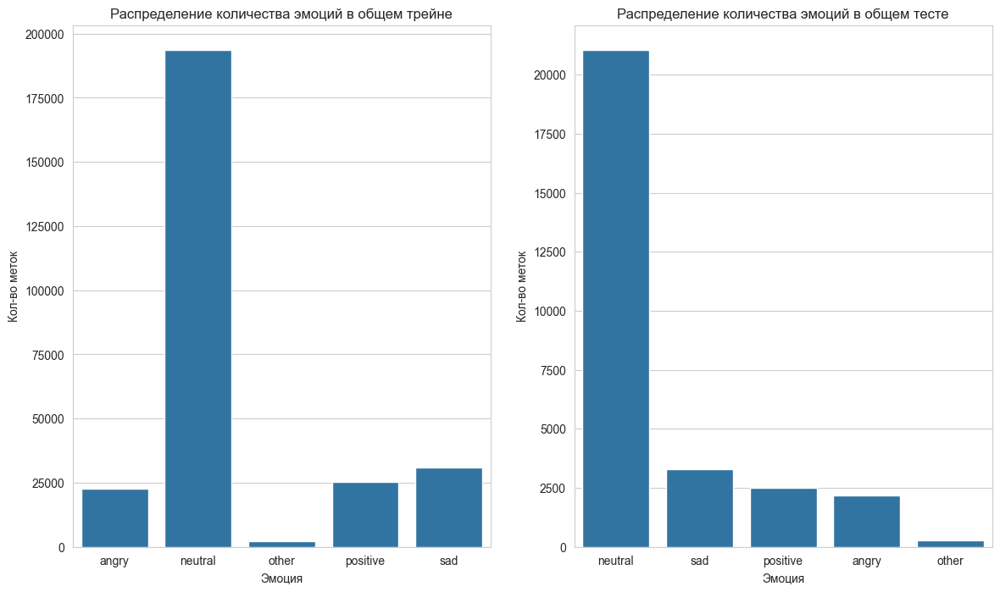

In [16]:
plt.figure(figsize=(14,8))
plt.subplot(1, 2, 1)
sns.countplot(full_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в общем трейне')
plt.subplot(1,2,2)
sns.countplot(full_test, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в общем тесте')
plt.show()


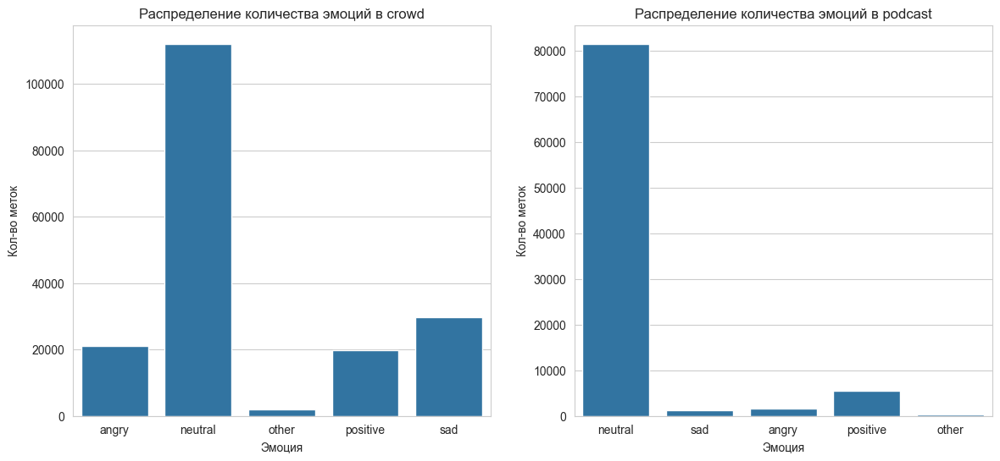

In [17]:
plt.figure(figsize=(14,6))
plt.subplot(1, 2, 1)
sns.countplot(crowd_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в crowd')
plt.subplot(1,2,2)
sns.countplot(podcast_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в podcast')
plt.show()


In [18]:
crowd_train['dataset'] = 'crowd'
podcast_train['dataset'] = 'podcast'

combined_data = pd.concat([crowd_train, podcast_train])

C:\Users\777\AppData\Local\Temp\ipykernel_89292\1824257678.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crowd_train['dataset'] = 'crowd'
C:\Users\777\AppData\Local\Temp\ipykernel_89292\1824257678.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  podcast_train['dataset'] = 'podcast'


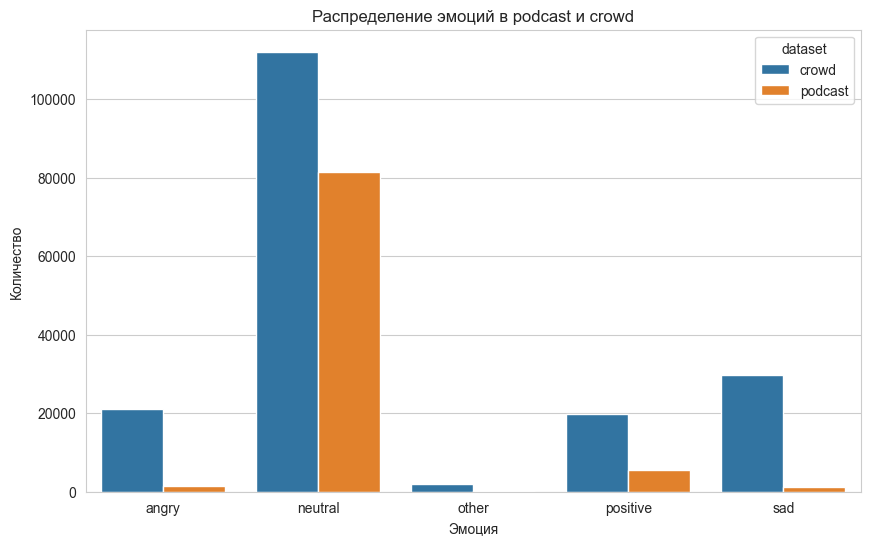

In [19]:
plt.figure(figsize=(10, 6))
sns.countplot(x='annotator_emo', data=combined_data, hue='dataset')
plt.title('Распределение эмоций в podcast и crowd')
plt.xlabel('Эмоция')
plt.ylabel('Количество')
plt.show()

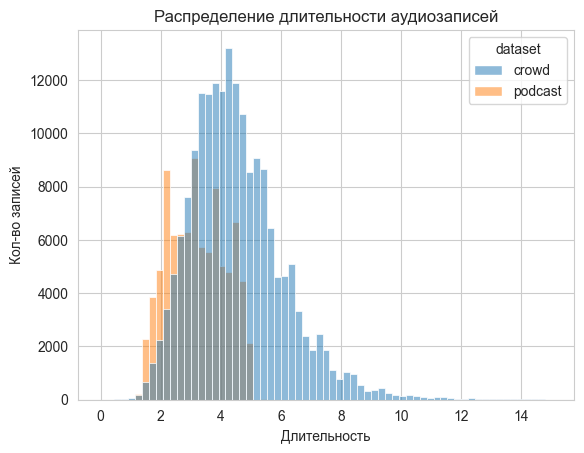

In [20]:
# Построение гистограммы с указанием столбца 'dataset' для раскраски
sns.histplot(data=combined_data, x='duration', hue='dataset',binrange=(0,15), bins=65)
plt.xlabel('Длительность')
plt.ylabel('Кол-во записей')
plt.title('Распределение длительности аудиозаписей')
plt.show()

In [21]:
crowd_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,475e76f77ac1ed7cabafca740b15b32a,475e76f77ac1ed7cabafca740b15b32a.wav,2.453000,angry,NaN,858305a5450b7bd1288ba0053b1cd1c1,не надо не надо не надо не надо,angry,fa136da095807ea6cd18dd6e2f58d4d0,crowd
1,2f9438ef68395c70a8714dc373a49d11,2f9438ef68395c70a8714dc373a49d11.wav,4.640000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,фозил кори mp три,neutral,3d436884cbbe25373914f8768de494f7,crowd
2,9937036a9c0dba20eecbffddd00f2be2,9937036a9c0dba20eecbffddd00f2be2.wav,4.341750,neutral,2.0,858305a5450b7bd1288ba0053b1cd1c1,NaN,NaN,NaN,crowd
3,fb0ae78586a235018103acec22a80a8f,fb0ae78586a235018103acec22a80a8f.wav,3.900562,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,сколько стоит на керамбит,neutral,80bc833cf6b3f106d2e8991783a31e2b,crowd
4,196dcf9e1aaac46c2aee45e7f6adfb92,196dcf9e1aaac46c2aee45e7f6adfb92.wav,4.780000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,афина когда закончится эта телепередача,neutral,bd78f079676fa5f1ed17253c9a440cc6,crowd
...,...,...,...,...,...,...,...,...,...,...
906905,485f6a9205f4615c18076753290f04e2,485f6a9205f4615c18076753290f04e2.wav,2.948562,neutral,NaN,35dc87272649dba37e9a8a114917ff18,мультик лего пожарный,neutral,9a3e249624d79bf823bc9c77d2d6bb2d,crowd
906906,9bba65658c63cab3d637d90cd9a697ce,9bba65658c63cab3d637d90cd9a697ce.wav,3.920000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,спирит оф зе,sad,68204b5c837951ebabc26e45cb649fc0,crowd
906907,29519c32a224aeac5888ea650eb6af6d,29519c32a224aeac5888ea650eb6af6d.wav,4.740000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,блин прикольно,neutral,6d82ca27f40defbcb07c07cd210c4735,crowd
906908,ac99bed2514c47d20030e4c34eb0d6cc,ac99bed2514c47d20030e4c34eb0d6cc.wav,3.760000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,последний богатырь фильм первый,neutral,2f53ec2f07d56af5ce9243569d4eb832,crowd


Text(0.5, 1.0, 'Распределение количества эмоций в crowd')

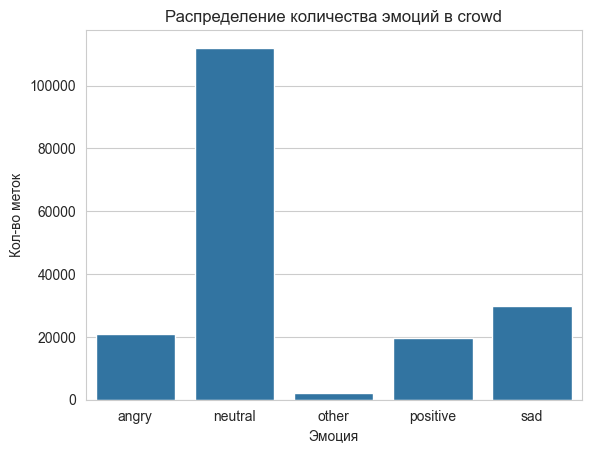

In [22]:
sns.countplot(crowd_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в crowd')

Text(0.5, 1.0, 'Зависимость длительности фрагмента от эмоции в Podcast')

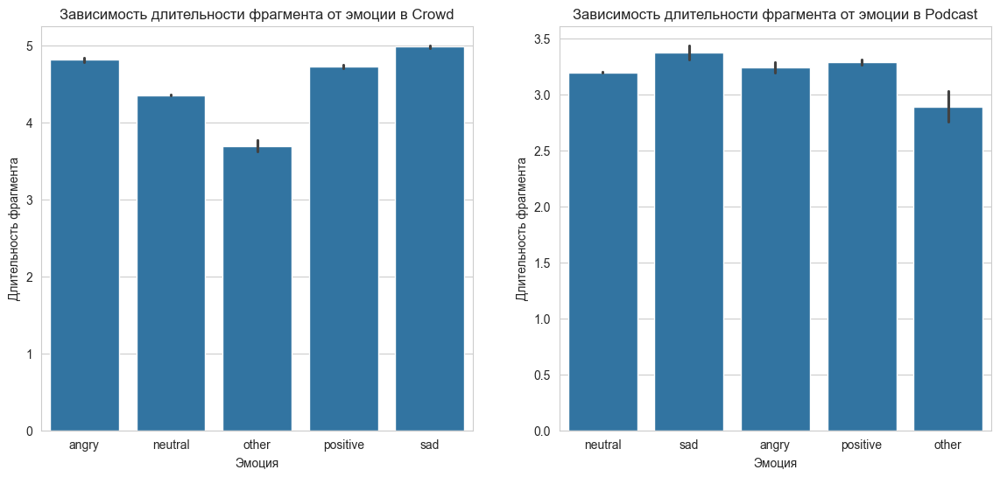

In [23]:
plt.figure(figsize=(14,6))
plt.subplot(1, 2, 1)
sns.barplot(crowd_train, x=crowd_train.annotator_emo, y = crowd_train.duration)
plt.xlabel('Эмоция')
plt.ylabel("Длительность фрагмента")
plt.title('Зависимость длительности фрагмента от эмоции в Crowd')
plt.subplot(1, 2, 2)
sns.barplot(podcast_train, x=podcast_train.annotator_emo, y = podcast_train.duration)
plt.xlabel('Эмоция')
plt.ylabel("Длительность фрагмента")
plt.title('Зависимость длительности фрагмента от эмоции в Podcast')

C:\Users\777\AppData\Local\Temp\ipykernel_64952\2333065865.py:7: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


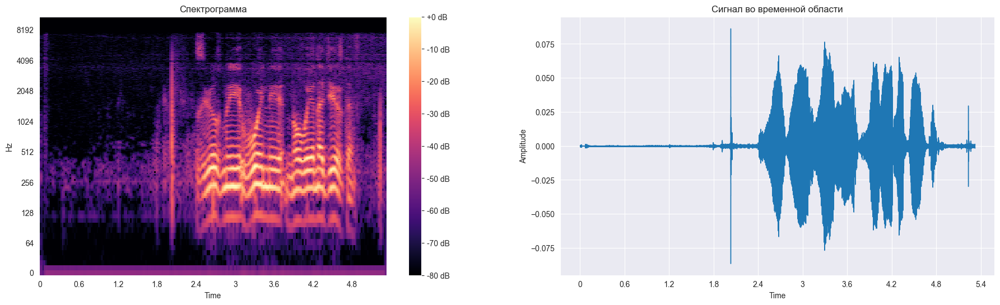

Текст записи: звездные войны новая надежда


In [24]:
audio_path = r'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_test\0a0b4bcc84b23c3d780affde94948853.wav'
y, sr = librosa.load(audio_path)

# Создание спектрограммы
plt.figure(figsize=(22,6))
plt.subplot(1, 2, 1)
D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Спектрограмма')
plt.subplot(1, 2, 2)
librosa.display.waveshow(y, sr=sr)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Сигнал во временной области')
plt.show()
print('Текст записи:', crowd_test.loc[crowd_test['audio_path'] == r'0a0b4bcc84b23c3d780affde94948853.wav'].speaker_text[61324])
Audio(r'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_test\0a0b4bcc84b23c3d780affde94948853.wav')

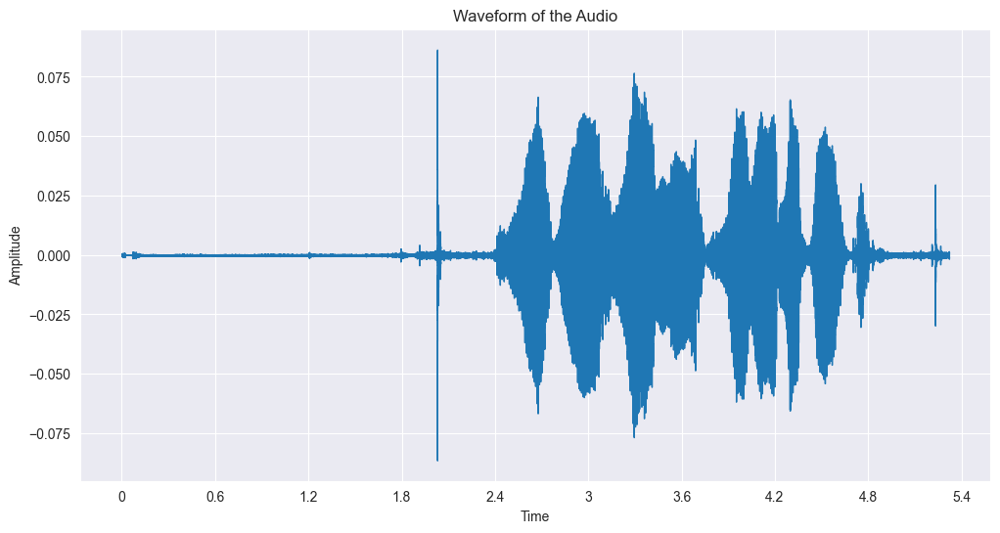

In [25]:
y, sr = librosa.load(audio_path)

# Отображение звуковой дорожки
plt.figure(figsize=(12, 6))
librosa.display.waveshow(y, sr=sr)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform of the Audio')
plt.show()

## пересборка данных

In [24]:
podcast_train = pd.read_csv('podcast_train.csv', delimiter='\t')
podcast_test = pd.read_csv('podcast_test.csv')
crowd_test = pd.read_csv('crowd_test.csv')
crowd_train = pd.read_csv('crowd_train.csv', delimiter='\t')
podcast_train = podcast_train.drop(columns=['Unnamed: 0'])
#podcast_test = podcast_test.drop(columns=['Unnamed: 0'])
crowd_train = crowd_train.drop(columns=['Unnamed: 0'])
#crowd_test = crowd_test.drop(columns=['Unnamed: 0'])

In [27]:
x = rnd.randint(1,10000)
print(x)
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_test\{crowd_test.audio_path[x]}')

6325


In [28]:
x = rnd.randint(1,10000)
sampling_rate, data=read_wav(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{podcast_train.audio_path[x]}')
print(sampling_rate)
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{podcast_train.audio_path[x]}')

16000


## предлагается взять все эмоциональные метки и соединить их в один датасет train общий и зашавлить немного нейтралей ото всюду и добавить их в датасет

In [29]:
crowd_test

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,9e9961c53ca6eeb440b217e539fbf46c,9e9961c53ca6eeb440b217e539fbf46c.wav,5.820000,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,я слушаю,neutral,4282ddc30d71ef420e202e0c60391e9f
1,0166f65a30354db8282682b1a280e64c,0166f65a30354db8282682b1a280e64c.wav,3.700000,1.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,каким стал сбер,neutral,d70dc98ed56e9362eaefefb7b2827c8f
2,d49a6b560155831725a7bdc7d0a96099,d49a6b560155831725a7bdc7d0a96099.wav,4.380000,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,где родился шерлок холмс,neutral,0ee35d2abecf4272ecc8e1539b0839d8
3,c6852b0925797612d7b6724da8cbe7b4,c6852b0925797612d7b6724da8cbe7b4.wav,8.580000,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,открой в браузере ennio morricone,neutral,0855e363c1787df1592f58f7a27ebe13
4,64a7aa17132c3e4b7be1aaed5fc88090,64a7aa17132c3e4b7be1aaed5fc88090.wav,5.060000,2.0,NaN,32bd471407fe168dacd5f8252f9949b7,а там и ева проснулись с утра,positive,82f97728c4767b283d249afc96d23caf
...,...,...,...,...,...,...,...,...,...
16978,c6c46f04346f97c9afa08d80c2d080e9,c6c46f04346f97c9afa08d80c2d080e9.wav,3.087875,1.0,NaN,6a059476b07f0467b9474fc47537784e,расскажи пош,sad,d52f012915a1c5d0f0de2f2809b50ebc
16979,a11c433210e177798ca17dfaf4722fbf,a11c433210e177798ca17dfaf4722fbf.wav,5.880000,0.0,NaN,6a059476b07f0467b9474fc47537784e,журавль в небе одиннадцатая серия,neutral,4110db4b879c4fefeb0699f513be655b
16980,0285ee8584af71a4a97910ae15ad2036,0285ee8584af71a4a97910ae15ad2036.wav,2.321625,0.0,NaN,21d9ef9f7501c209c5375aded8ec6267,как настроение,neutral,d52f012915a1c5d0f0de2f2809b50ebc
16981,c6a4e8bfe297ea1ed02248476629e31c,c6a4e8bfe297ea1ed02248476629e31c.wav,4.200000,0.0,NaN,2b2a97be939e2be7a17346030d05ba3f,воровка книг обзор,neutral,cfd78371e73b909c819176bd0b681963


In [30]:
podcast_test

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,9749f1633078b5e2dfffbf0d3594a810,9749f1633078b5e2dfffbf0d3594a810.wav,3.000000,0.0,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,cf2b88351856b5aafe71a53d97c67fdb
1,92769fa87a3740ab9f398b6835b3b774,92769fa87a3740ab9f398b6835b3b774.wav,3.600125,0.0,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,d0fc37a2c3b3f3ae2c8f52ef7982cfdb
2,e5ccdbca2da61e1f517facf393fa9f95,e5ccdbca2da61e1f517facf393fa9f95.wav,2.000000,0.0,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,90811511e78c4adce8f508e3f7ae1a59
3,9b3a93ef2dd4a72e6952a4f84f38ca54,9b3a93ef2dd4a72e6952a4f84f38ca54.wav,2.400000,0.0,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,2f61a6bb38c301b1a412604b0600d1ea
4,f2498990f5938126cb4c38c83ca2780d,f2498990f5938126cb4c38c83ca2780d.wav,3.000000,0.0,NaN,8fda35910f15bcac6a8feef8498acf21,NaN,NaN,cdc045b90400dc2c600aa48fdccd5e64
...,...,...,...,...,...,...,...,...,...
12046,0b5911175dd80e2d5b0f6ebe2281fcf1,0b5911175dd80e2d5b0f6ebe2281fcf1.wav,2.600000,0.0,NaN,d7fe5fc7ecf7df35fc43859c99491cd6,NaN,NaN,0f9ed62245fdc1e36a3bf8c0f7270c41
12047,1227da4809819378be4f2aac7353c592,1227da4809819378be4f2aac7353c592.wav,1.300000,0.0,NaN,013f1749c55055e16f8acf9817598b2d,NaN,NaN,742833af70986b8ff933b1cb75cb0987
12048,b7ac0b2d52191acfa44cbcc09d071de4,b7ac0b2d52191acfa44cbcc09d071de4.wav,3.100000,0.0,NaN,9fccb985c2f1910e12a1b7386180aa59,NaN,NaN,6a2370e4e8cc496c4d59408bb2a9995a
12049,7e62e88117cc0cc20bba2c7902cee97d,7e62e88117cc0cc20bba2c7902cee97d.wav,2.100000,0.0,NaN,d6b5eac94428cfad71114fbccbcf4dbc,NaN,NaN,d0c7db9d0bc8dd57be358f6bf13d3f90


In [31]:
podcast_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,857b7099a4f5766105d166e2283066fa,857b7099a4f5766105d166e2283066fa.wav,4.400000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,d6738a1e0d59f783987e0503ddb4ca54,podcast
1,2107b749055d85d7c09ac49fd30e3feb,2107b749055d85d7c09ac49fd30e3feb.wav,3.800000,neutral,2.0,a6aea16a81aa926eee405c0878162c91,NaN,NaN,1fcfcacf584841d22fbdf4a51fe6177d,podcast
2,700b3a5644a0824831848c346d11c7d6,700b3a5644a0824831848c346d11c7d6.wav,2.500000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,dfd63e80a7aca8d4cb4e14e062441886,podcast
3,e8c053899135f139e9527c1388790e36,e8c053899135f139e9527c1388790e36.wav,1.700000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,63c3ae005d1663de92314be4377a8805,podcast
4,7fe59996e0f93b8a63e28aacf480004b,7fe59996e0f93b8a63e28aacf480004b.wav,1.900000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,14abbe44c78118171f01348f862698cd,podcast
...,...,...,...,...,...,...,...,...,...,...
90028,1fc257875e246ec1d63bb7245a717307,1fc257875e246ec1d63bb7245a717307.wav,4.300125,neutral,NaN,b8490c1eae9cd6def2c8e318a03d8547,NaN,NaN,c0edafad3d25110eab09b6591d4740d2,podcast
90029,5e08e3e32e1413f2f99e565493200893,5e08e3e32e1413f2f99e565493200893.wav,4.300000,neutral,NaN,b8490c1eae9cd6def2c8e318a03d8547,NaN,NaN,3fca5b60a0d174eed41349cf9807d1f7,podcast
90030,dcf03dbbfff993b6b8a35c8d813f1a39,dcf03dbbfff993b6b8a35c8d813f1a39.wav,4.100000,positive,NaN,b8490c1eae9cd6def2c8e318a03d8547,NaN,NaN,7bbb4fc248887cf74beee6f553b8bcab,podcast
90031,553977eb7e8eb01c85a8c40ccc3f05e1,553977eb7e8eb01c85a8c40ccc3f05e1.wav,3.299750,neutral,NaN,b8490c1eae9cd6def2c8e318a03d8547,NaN,NaN,f5e7e58d28837aa7102b8176d2ef9ced,podcast


In [32]:
crowd_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,475e76f77ac1ed7cabafca740b15b32a,475e76f77ac1ed7cabafca740b15b32a.wav,2.453000,angry,NaN,858305a5450b7bd1288ba0053b1cd1c1,не надо не надо не надо не надо,angry,fa136da095807ea6cd18dd6e2f58d4d0,crowd
1,2f9438ef68395c70a8714dc373a49d11,2f9438ef68395c70a8714dc373a49d11.wav,4.640000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,фозил кори mp три,neutral,3d436884cbbe25373914f8768de494f7,crowd
2,9937036a9c0dba20eecbffddd00f2be2,9937036a9c0dba20eecbffddd00f2be2.wav,4.341750,neutral,2.0,858305a5450b7bd1288ba0053b1cd1c1,NaN,NaN,NaN,crowd
3,fb0ae78586a235018103acec22a80a8f,fb0ae78586a235018103acec22a80a8f.wav,3.900562,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,сколько стоит на керамбит,neutral,80bc833cf6b3f106d2e8991783a31e2b,crowd
4,196dcf9e1aaac46c2aee45e7f6adfb92,196dcf9e1aaac46c2aee45e7f6adfb92.wav,4.780000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,афина когда закончится эта телепередача,neutral,bd78f079676fa5f1ed17253c9a440cc6,crowd
...,...,...,...,...,...,...,...,...,...,...
184628,485f6a9205f4615c18076753290f04e2,485f6a9205f4615c18076753290f04e2.wav,2.948562,neutral,NaN,35dc87272649dba37e9a8a114917ff18,мультик лего пожарный,neutral,9a3e249624d79bf823bc9c77d2d6bb2d,crowd
184629,9bba65658c63cab3d637d90cd9a697ce,9bba65658c63cab3d637d90cd9a697ce.wav,3.920000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,спирит оф зе,sad,68204b5c837951ebabc26e45cb649fc0,crowd
184630,29519c32a224aeac5888ea650eb6af6d,29519c32a224aeac5888ea650eb6af6d.wav,4.740000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,блин прикольно,neutral,6d82ca27f40defbcb07c07cd210c4735,crowd
184631,ac99bed2514c47d20030e4c34eb0d6cc,ac99bed2514c47d20030e4c34eb0d6cc.wav,3.760000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,последний богатырь фильм первый,neutral,2f53ec2f07d56af5ce9243569d4eb832,crowd


In [25]:
crowd_test['dataset'] = 'crowd'
podcast_test['dataset'] = 'podcast'
major_test = pd.concat([crowd_test, podcast_test], axis=0)


In [26]:
major_test.to_csv('ideal_data_csv.csv')

In [62]:
podcast_train_filt = podcast_train.loc[podcast_train['annotator_emo'].isin(['positive','sad','angry','other'])]
podcast_train_neutral = podcast_train.loc[podcast_train['annotator_emo']=='neutral']
crowd_train_filt = crowd_train.loc[crowd_train['annotator_emo'].isin(['positive','sad','angry','other'])]
crowd_train_neutral = crowd_train.loc[crowd_train['annotator_emo']=='neutral']
major_train_emotional = pd.concat([crowd_train_filt, podcast_train_filt], axis=0)
major_train_neutral = pd.concat([crowd_train_neutral, podcast_train_neutral], axis=0)
sample_neutral = major_train_neutral.sample(n=80000, replace=False)
major_train = pd.concat([sample_neutral, major_train_emotional], axis=0)
major_train = major_train.reset_index()
major_train.drop(columns=['index'], inplace=True)

In [63]:
print(major_train.annotator_emo.value_counts())

annotator_emo
neutral     80000
sad         30902
positive    25310
angry       22569
other        2282
Name: count, dtype: int64


In [36]:
podcast_train_filt = podcast_train.loc[podcast_train['annotator_emo'].isin(['positive','sad','angry','other'])]
podcast_train_neutral = podcast_train.loc[podcast_train['annotator_emo']=='neutral']
crowd_train_filt = crowd_train.loc[crowd_train['annotator_emo'].isin(['positive','sad','angry','other'])]
crowd_train_neutral = crowd_train.loc[crowd_train['annotator_emo']=='neutral']
major_train_emotional = pd.concat([crowd_train_filt, podcast_train_filt], axis=0)
major_train_neutral = pd.concat([crowd_train_neutral, podcast_train_neutral], axis=0)
sample_neutral = major_train_neutral.sample(n=35000, replace=False)
major_train_balanced = pd.concat([sample_neutral, major_train_emotional], axis=0)
major_train_balanced = major_train_balanced.reset_index()
major_train_balanced.drop(columns=['index'], inplace=True)

In [37]:
dic = {'neutral':0, 'sad':1, 'positive':2, 'angry':3}
major_train_balanced['annotator_emo'] = major_train_balanced['annotator_emo'].map(dic)
major_train_balanced.dropna(subset='annotator_emo', inplace=True)

In [38]:
print(major_train_balanced.annotator_emo.value_counts())

annotator_emo
0.0    35000
1.0    30902
2.0    25310
3.0    22569
Name: count, dtype: int64


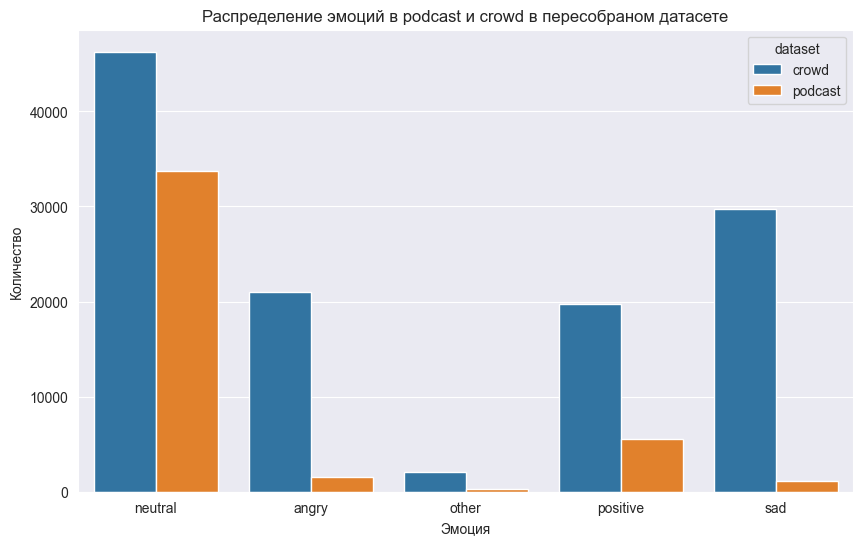

In [39]:
plt.figure(figsize=(10, 6))
sns.countplot(x='annotator_emo', data=major_train, hue='dataset')
plt.title('Распределение эмоций в podcast и crowd в пересобраном датасете')
plt.xlabel('Эмоция')
plt.ylabel('Количество')
plt.show()

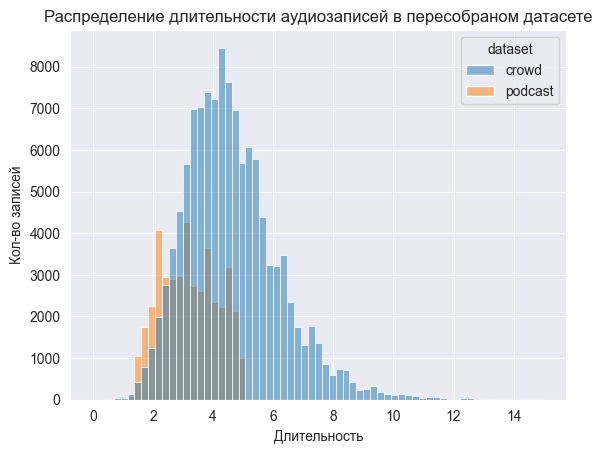

4.27024261042263


In [40]:
sns.histplot(data=major_train, x='duration', hue='dataset',binrange=(0,15), bins=65)
plt.xlabel('Длительность')
plt.ylabel('Кол-во записей')
plt.title('Распределение длительности аудиозаписей в пересобраном датасете')
plt.show()
print(major_train.duration.mean())

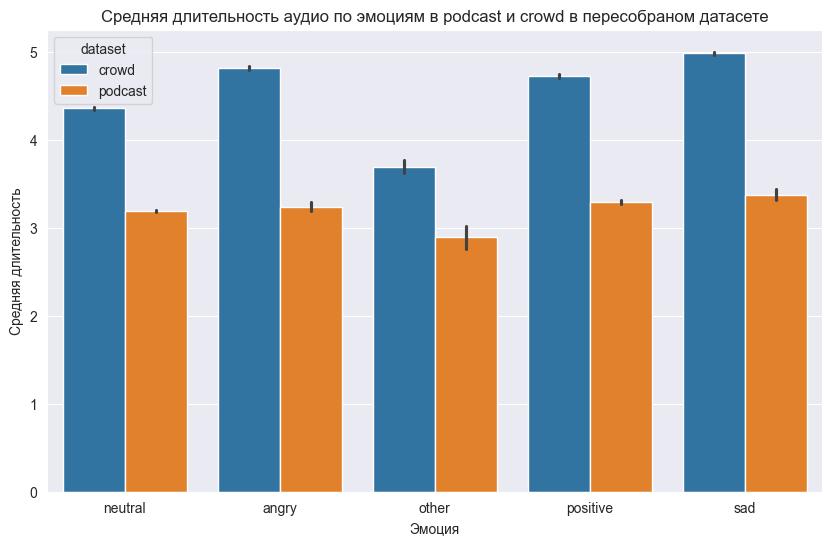

In [41]:
plt.figure(figsize=(10, 6))
sns.barplot(x='annotator_emo', y='duration', data=major_train, hue='dataset', estimator=np.mean)
plt.title('Средняя длительность аудио по эмоциям в podcast и crowd в пересобраном датасете')
plt.xlabel('Эмоция')
plt.ylabel('Средняя длительность')
plt.show()


In [42]:
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 6) & (major_train["dataset"] == "podcast")].audio_path[152857]}')

In [47]:
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 6) & (major_train["dataset"] == "crowd")].audio_path[18]}')


## в общем, в крауде спокойно можно выкидывать первую секунду. Слушать запись предлагаю до 6 секунды, то есть будут куски по 5 сек.
дальше есть несколько вариков:
1) заполнять недостатки шумом
2) ничем не заполнять недостатки


# Features


#### Обычный waveform

In [48]:
major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")]

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
18,a4e426e5e8b4825504e83a5a9ae0ef4e,a4e426e5e8b4825504e83a5a9ae0ef4e.wav,6.54000,neutral,NaN,eb4f5bce1950b70092a229051d9ed018,живой концерт freddie mercury,neutral,d274c17002654646a1bbf2761d4d4016,crowd
21,c524302faf65cfc91c157edfef84a4c3,c524302faf65cfc91c157edfef84a4c3.wav,6.14000,neutral,NaN,2fc041523c8ed44ef3eb912117f69cd4,покажите шестидесятую серию никто кроме тебя,neutral,e23344c9d982716af5a4682fb718ba3f,crowd
24,8929fb49f39643ed221f27b616b55226,8929fb49f39643ed221f27b616b55226.wav,6.12000,neutral,NaN,4ae75085ccce0fce08d515500b5b8511,как купить приставку,neutral,d3673af89fc6d396c4a5ce3040bd1279,crowd
26,de52c2daa18eab092f8ebfde45741194,de52c2daa18eab092f8ebfde45741194.wav,8.56000,neutral,NaN,aba9885a9cf8a225892591fc6f467caa,два лица стамбула двадцать вторая серия,neutral,fe19c8cdd8e7202d62b78b87a5a0d82b,crowd
34,75a4b7afdc846a4be01c983a42b9eb32,75a4b7afdc846a4be01c983a42b9eb32.wav,6.94000,neutral,NaN,2ef0a0973bf3fe6a2e144b9e35b16bcd,я хочу узнать почему облака белые тучи черные,neutral,e20755511510c4217ff0c4c6b219a90a,crowd
...,...,...,...,...,...,...,...,...,...,...
152529,1bd98522dfe822ba302ed5bf40483a9e,1bd98522dfe822ba302ed5bf40483a9e.wav,7.34000,sad,NaN,cfd3c4c449a95484ad0bb33045eaea8d,какая самая дорогая машина стоит настоящая,sad,6051bd939a82b618d2104349e7be5b01,crowd
152532,dc78d780fcd27870d537293310415ea2,dc78d780fcd27870d537293310415ea2.wav,6.42000,sad,NaN,3cc344dbcbb162063661e7a6a8f71a48,загрузи статью из википедии,sad,44cee9a64f525d0f083432b80b61d454,crowd
152537,6bed914910414c25d780fd5e744b42ee,6bed914910414c25d780fd5e744b42ee.wav,6.20000,sad,NaN,3cc344dbcbb162063661e7a6a8f71a48,смотреть на ютубе что где когда,sad,f394cca56f9332e95ad5358f59e0992c,crowd
152538,56fba8a9972b5452b19505de6a402237,56fba8a9972b5452b19505de6a402237.wav,6.08325,sad,NaN,6a059476b07f0467b9474fc47537784e,а я целыми днями переписываюсь,sad,c0b4963fde096c160bb3296dc69bdbbf,crowd


In [50]:
print ("Текст записи:", major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].speaker_text[18])
print('Эмоция -->', major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].speaker_emo[18])
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].audio_path[18]}')

Текст записи: живой концерт freddie mercury
Эмоция --> neutral


In [113]:
print ("Текст записи:", major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].speaker_text[18])
print('Эмоция -->', major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].speaker_emo[18])
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].audio_path[18]}')

Текст записи: живой концерт freddie mercury
Эмоция --> neutral


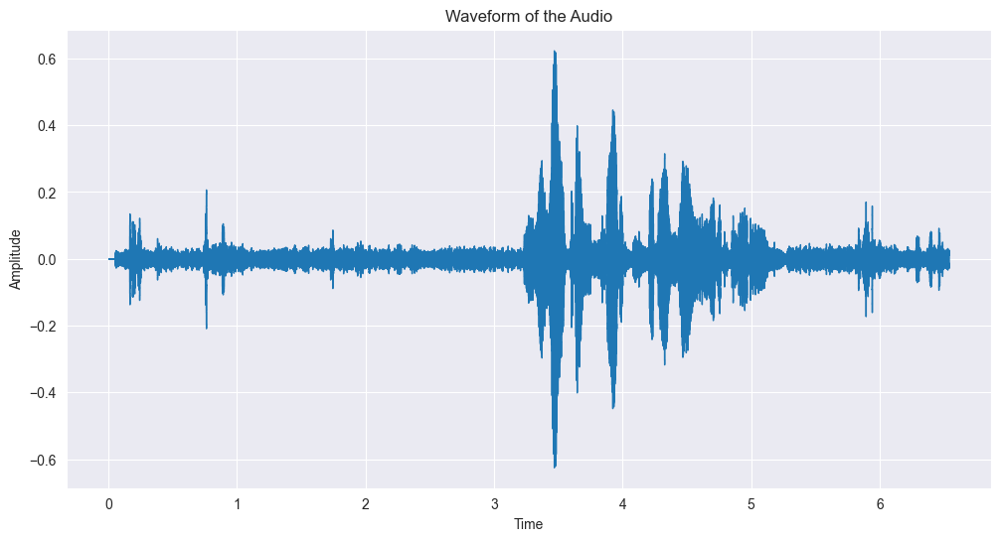

In [122]:
y, sr = librosa.load(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].audio_path[18]}')

# Отображение звуковой дорожки
plt.figure(figsize=(12, 6))
librosa.display.waveshow(y, sr=sr)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform of the Audio')
plt.show()

#### Разделение гармонических и тональных сигналов
Результатом является то, что временной ряд y был разделен на два временных ряда, содержащих гармоническую и перкуссионную части сигнала. Каждый из y_harmonic и y_percussive имеет ту же форму и продолжительность, что и y

Text(0.5, 1.0, 'Harmonic + Percussive')

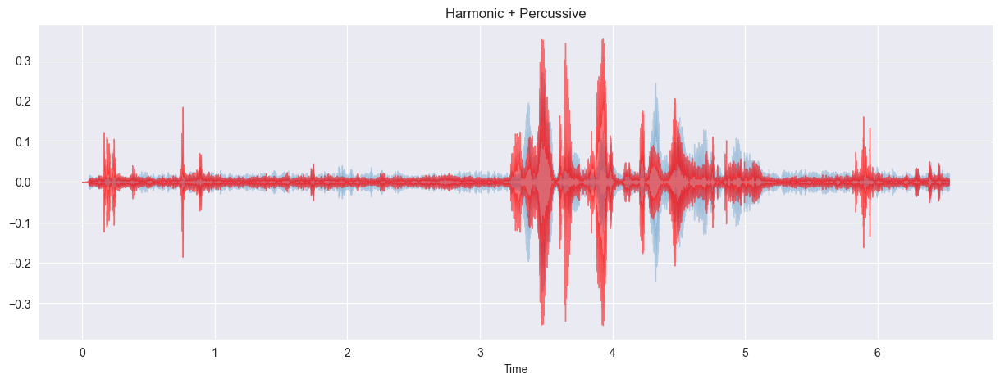

In [115]:
y_harmonic, y_percussive = librosa.effects.hpss(y)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(y_harmonic, sr=sr, alpha=0.25)
librosa.display.waveshow(y_percussive, sr=sr, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')

#### Нормализованная энергия цветности - Chroma Energy Normalized (CENS)
Функции цветности основаны на двенадцати атрибутах написания основного тона, как используется в западной нотной записи, где каждый вектор цветности указывает, как энергия в кадре сигнала распределяется по двенадцати полосам цветности. Измерение таких распределений во времени дает представление времени и цветности (или хромаграмму ), которое тесно коррелирует с мелодической и гармонической прогрессией. Такие последовательности часто схожи для разных записей одного и того же. Нормализованная энергия цветности применяется для сопоставления звука, где допускаются вариации, поскольку они обычно появляются в разных исполнениях . Например, два разных исполнения одного и того же, могут демонстрировать значительные нелинейные глобальные и локальные различия в темпе, артикуляции и фразировке.

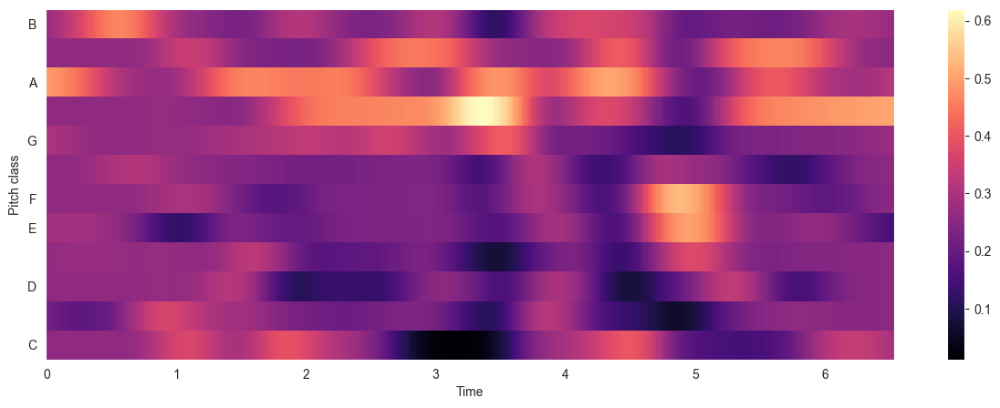

In [116]:
chroma=librosa.feature.chroma_cens(y=y_harmonic, sr=sr)
plt.figure(figsize=(15, 5))
librosa.display.specshow(chroma,y_axis='chroma', x_axis='time')
plt.colorbar()

#### Мел-кепстральные коэффициенты (MFCC).
Мел-кепстральные коэффициенты — один из важнейших признаков в обработке аудио. MFCC — это матрица значений, которая захватывает тембральные аспекты.

MFCC - Представляют собой набор признаков , которые описывают общую форму спектральной огибающей. Они моделируют характеристики человеческого голоса. MFCC - коэффициенты частотной капсулы, суммируют частотное распределение по размеру окна. Поэтому можно анализировать как частотные, так и временные характеристики звука. Перед построением графика коэффициенты нормализуются.

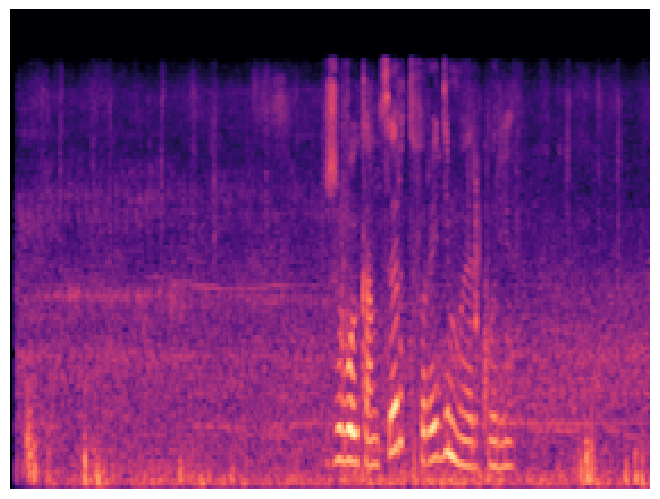

In [117]:
from matplotlib import pylab


pylab.axis('off') # no axis
pylab.axes([0., 0., 1., 1.], frameon=False, xticks=[], yticks=[]) # Remove the white edge
S = librosa.feature.melspectrogram(y=y, sr=sr)
librosa.display.specshow(librosa.power_to_db(S, ref=np.max))
pylab.show()
pylab.close()

In [118]:
import torchaudio

mel_spectrogram = torchaudio.transforms.MelSpectrogram(sample_rate=sr, n_fft=1024, hop_length=512, n_mels=128)
signal, sr = torchaudio.load(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 5.9) & (major_train["dataset"] == "crowd")].audio_path[18]}')
signal = mel_spectrogram(signal).permute(1, 2, 0)

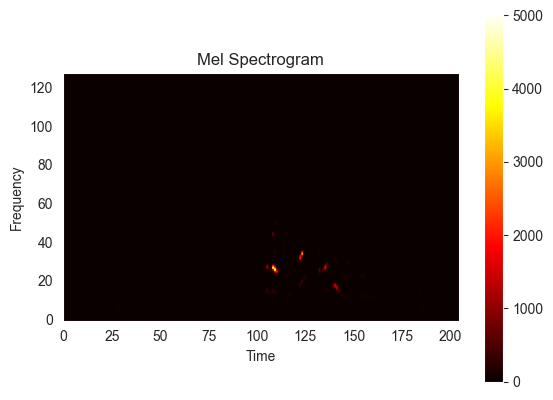

In [119]:

mel_spec_np = signal.detach().numpy()

# Отображение мелспектрограммы

plt.imshow(mel_spec_np, cmap='hot', origin='lower')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.title('Mel Spectrogram')
plt.colorbar()
plt.grid(False)
plt.show()

#### Спектрограмма
Спектрограмма - это визуальный способ представления уровня или “громкости” сигнала во времени на различных частотах, присутствующих в форме волны. Обычно изображается в виде тепловой карты. .stft() преобразует данные в кратковременное преобразование Фурье. С помощью STFT можно определить амплитуду различных частот, воспроизводимых в данный момент времени аудиосигнала.

Ширина: 1000, Высота: 700


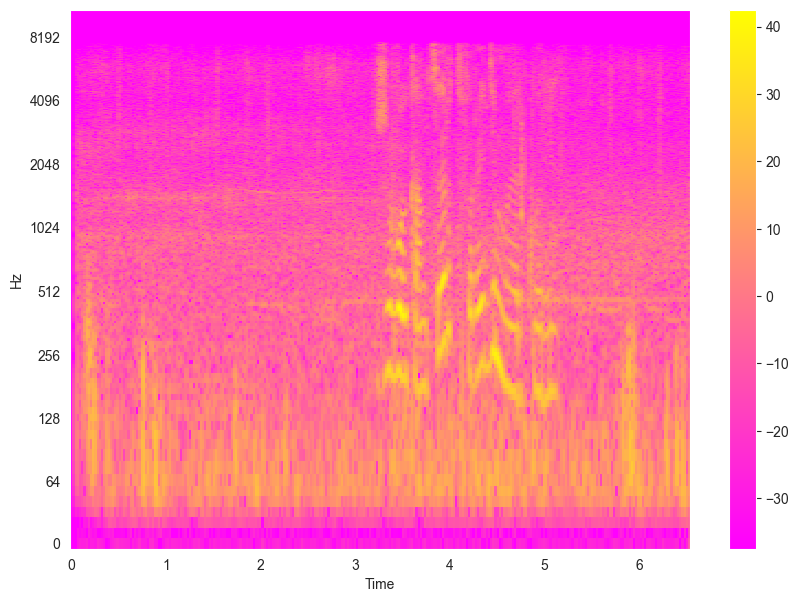

In [123]:
X = librosa.stft(y)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(10, 7))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log', cmap='spring')
plt.colorbar()
plt.savefig('plot.png')  # Сохраняем изображение

# Получаем размеры изображения
img = plt.imread('plot.png')
height, width, _ = img.shape
print(f"Ширина: {width}, Высота: {height}")

#### Спектральный центроид
Указывает, на какой частоте сосредоточена энергия спектра или, другими словами, указывает, где расположен “центр масс” для звука. librosa.feature.spectral_centroid вычисляет спектральный центроид для каждого фрейма в сигнале:

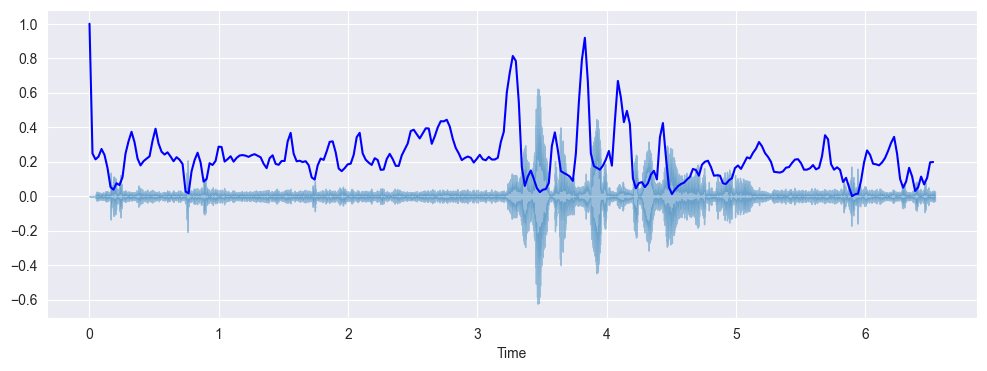

In [124]:
spectral_centroids = librosa.feature.spectral_centroid(y=y, sr=sr)[0]
spectral_centroids.shape

# Вычисление временной переменной для визуализации
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
# Нормализация спектрального центроида для визуализации
def normalize(y, axis=0):
    return sklearn.preprocessing.minmax_scale(y, axis=axis)
# Построение спектрального центроида вместе с формой волны
librosa.display.waveshow(y, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

#### Спектральный контраст - Spectral Contrast
Каждый кадр спектрограммы  S делится на поддиапазоны. Для каждого поддиапазона энергетический контраст оценивается путем сравнения средней энергии в верхнем квантиле (энергия пика) со средним значением энергии в нижнем квантиле (энергия впадины). Высокие значения контрастности обычно соответствуют четким узкополосным сигналам, а низкие значения контрастности соответствуют широкополосным шумам.

Text(0.5, 1.0, 'Spectral contrast')

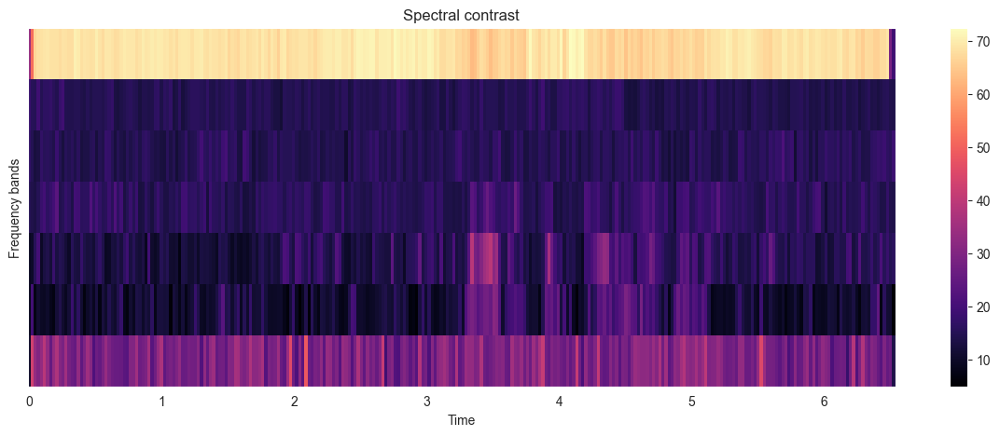

In [125]:
contrast=librosa.feature.spectral_contrast(y=y_harmonic,sr=sr)
plt.figure(figsize=(15,5))
librosa.display.specshow(contrast, x_axis='time')
plt.colorbar()
plt.ylabel('Frequency bands')
plt.title('Spectral contrast')

#### Спектральный спад - Spectral Rolloff.
Это мера формы сигнала, представляющая собой частоту, в которой высокие частоты снижаются до 0. Чтобы получить ее, нужно рассчитать долю элементов в спектре мощности, где 85% ее мощности находится на более низких частотах. librosa.feature.spectral_rolloff вычисляет частоту спада для каждого фрейма в сигнале:

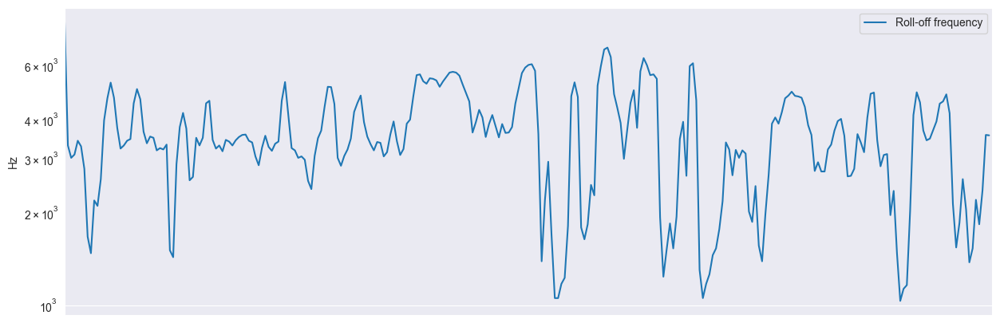

In [126]:
 # Spectral Rolloff
rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
plt.figure(figsize=(15,5))
plt.semilogy(rolloff.T, label='Roll-off frequency')
plt.ylabel('Hz')
plt.xticks([])
plt.xlim([0, rolloff.shape[-1]])
plt.legend()

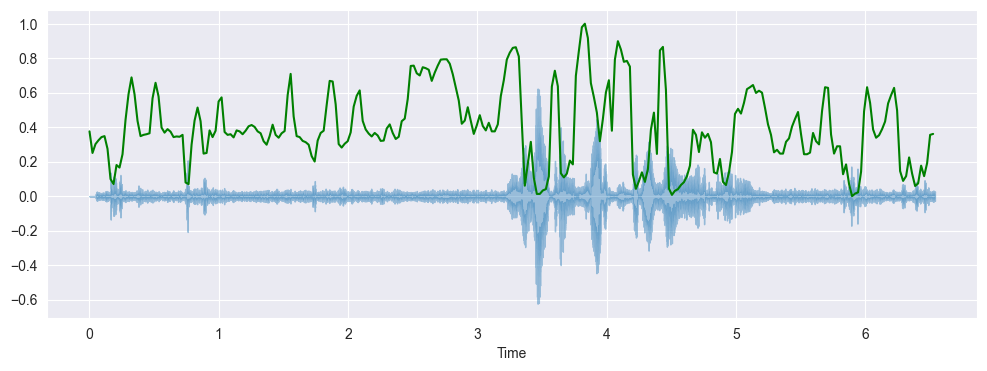

In [127]:
spectral_rolloff = librosa.feature.spectral_rolloff(y=y+0.01, sr=sr)[0]
plt.figure(figsize=(12, 4))
librosa.display.waveshow(y, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='g')

# Обработка данных

In [36]:
major_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,1eea91ec70debfe042d0fe8264953a5b,1eea91ec70debfe042d0fe8264953a5b.wav,3.980000,neutral,NaN,57f528c6963d0a4c756df3763b05f55f,а что ты умеешь запускать,neutral,a1f3dd4fa70b1d316278ffe94842e698,crowd
1,363e920858cf8605a3480fb73cb30ec5,363e920858cf8605a3480fb73cb30ec5.wav,4.266312,neutral,NaN,69d57f21eb43d717008b23c51151e437,ментовские войны одиннадцатый сезон все серии,sad,695464837e01b3d3da36ca8d1b041f30,crowd
2,0e82bd29c9857c9c249f3e5356f8533e,0e82bd29c9857c9c249f3e5356f8533e.wav,3.018187,neutral,NaN,7a805f4c62d3d7defb6caa7134346b85,что такое микрофон,neutral,0af0baa1fdf4356e5219945b112485b9,crowd
3,e558050c31b6552670255ed70b2c454a,e558050c31b6552670255ed70b2c454a.wav,3.120000,neutral,NaN,bcf9a069dfc4d6207a67bf2cfa942afd,недолгие мультики,neutral,1a9556a329c3aee037c308e0447e58ac,crowd
4,bbbaa7fa2c8f63360654bbed19141540,bbbaa7fa2c8f63360654bbed19141540.wav,4.180000,neutral,NaN,091011252899990b36c9aababf78601e,дау два,sad,6b21fe3fa9e652170b19b77adb16efce,crowd
...,...,...,...,...,...,...,...,...,...,...
161058,55a54d98443cb0edc9aa78d79e23db94,55a54d98443cb0edc9aa78d79e23db94.wav,3.800000,positive,NaN,478ece03f1b19f637b7e7e10a1c4ec18,NaN,NaN,763d3f7e3283b1a518d3e55c6fe94453,podcast
161059,1ab446e4e07e257f185718d60f0fa987,1ab446e4e07e257f185718d60f0fa987.wav,2.000000,sad,NaN,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,0bd05f242495d97466c5674653ae32cb,podcast
161060,c9e515550d451c497c5434c1e12d61a9,c9e515550d451c497c5434c1e12d61a9.wav,4.800000,positive,NaN,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,becdf05079e4884fa8a8276d1a488f1d,podcast
161061,be1553e2d7651dfc6360db8594001262,be1553e2d7651dfc6360db8594001262.wav,2.800000,positive,NaN,d6b5eac94428cfad71114fbccbcf4dbc,NaN,NaN,fce116bdeb94468cea73a926ab452205,podcast


In [55]:
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.audio_path[43086]}')

In [56]:
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.audio_path[23814]}')

In [32]:
# Функция для обрезания или дополнения аудио до нужной длины
def process_audio_noise_podcast(audio_path, target_duration=5.5, discard_sec = 0 , mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Если длина аудио меньше целевой длины, дополним шумом
    if len(y) < target_duration * sr:
        noise = np.random.normal(0, 0.005, int((target_duration * sr) - len(y)))
        y = np.concatenate([y, noise])
    # Если длина аудио больше целевой длины, обрежем до нужной длины
    elif len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]
    discard_samples = int(discard_sec * sr)
    y = y[discard_samples:]

    return y, sr

In [33]:
def process_audio_noise_crowd(audio_path, target_duration=6, discard_sec = 0.5 , mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Если длина аудио меньше целевой длины, дополним шумом
    if len(y) < target_duration * sr:
        noise = np.random.normal(0, 0.005, int((target_duration * sr) - len(y)))
        y = np.concatenate([y, noise])
    # Если длина аудио больше целевой длины, обрежем до нужной длины
    elif len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]
    discard_samples = int(discard_sec * sr)
    y = y[discard_samples:]

    return y, sr

In [34]:
def process_audio_cycle_crowd(audio_path, target_duration=6, discard_seconds=0.5, mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Зацикливание аудиофрагмента до достижения целевой длины
    while len(y) < target_duration * sr:
        y = np.concatenate([y, y])

    if len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]

    # Обрезка аудиофрагмента до нужной длины
    y = y[:int(target_duration * sr)]

    # Отброс первых 0.5 секунд аудио
    discard_samples = int(discard_seconds * sr)
    y = y[discard_samples:]  # Отбрасываем первые 0.5 секунд

    return y, sr

In [35]:
def process_audio_cycle_podcast(audio_path, target_duration=5.5, discard_seconds=0, mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Зацикливание аудиофрагмента до достижения целевой длины
    while len(y) < target_duration * sr:
        y = np.concatenate([y, y])

    if len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]

    # Обрезка аудиофрагмента до нужной длины
    y = y[:int(target_duration * sr)]

    # Отброс первых 0.5 секунд аудио
    discard_samples = int(discard_seconds * sr)
    y = y[discard_samples:]  # Отбрасываем первые 0.5 секунд

    return y, sr

In [133]:
# Пример применения функции к аудиофайлу
audio_path = fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.audio_path[43086]}'
processed_audio, sr = process_audio_cycle_crowd(audio_path, mon=True)

In [134]:
Audio(processed_audio, rate=sr)


#### Средние значения и стандартные отклонения Мел-кепстральных коэффициентов для записи с шумом
Давайте посмотрим, как выглядят Средние значения и стандартные отклонения Мел-кепстральных коэффициентов в виде двухмерной таблицы (Dataframes), состоящей из столбцов и строки и в виде графика.

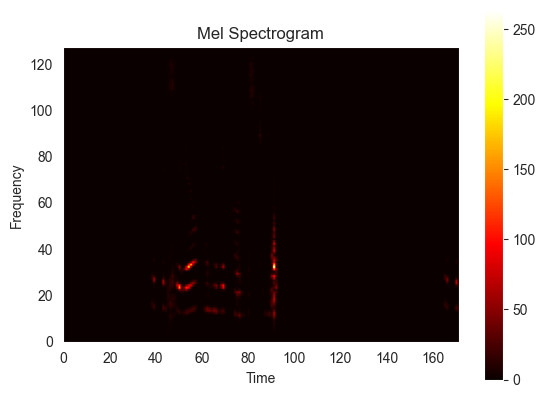

In [149]:
signal = mel_spectrogram(torch.from_numpy(processed_audio))

mel_spec_np = signal.detach().numpy()

# Отображение мелспектрограммы

plt.imshow(mel_spec_np, cmap='hot', origin='lower')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.title('Mel Spectrogram')
plt.colorbar()
plt.grid(False)
plt.show()

In [163]:
mel_spec_np[:64]

array([[2.93702800e-02, 2.20157839e-02, 1.19025111e-02, ...,
        1.58443861e-02, 3.03688139e-04, 7.05503067e-03],
       [1.83316711e-02, 1.37442080e-02, 7.43226055e-03, ...,
        1.25127044e-02, 7.97512126e-04, 1.08268270e-02],
       [2.54003844e-05, 2.69011798e-05, 1.90354294e-05, ...,
        7.12800492e-03, 1.64902676e-03, 1.74259711e-02],
       ...,
       [1.40597285e-05, 3.80747078e-05, 8.81664382e-05, ...,
        2.21505716e-01, 4.66062827e-03, 1.25261676e-02],
       [8.46949479e-05, 8.44925598e-05, 4.90885068e-05, ...,
        8.69399011e-02, 2.76219100e-02, 1.56611223e-02],
       [3.76485114e-05, 3.55798111e-05, 5.92755714e-05, ...,
        9.96750370e-02, 1.76814906e-02, 1.42558785e-02]], dtype=float32)

C:\Users\777\AppData\Local\Temp\ipykernel_64952\1773490885.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  mfccs_df['mfccs_std_'+str(i)]=mfccs_mean[i]
C:\Users\777\AppData\Local\Temp\ipykernel_64952\1773490885.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  mfccs_df['mfccs_std_'+str(i)]=mfccs_mean[i]
C:\Users\777\AppData\Local\Temp\ipykernel_64952\1773490885.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

,mfccs_mean_0,mfccs_mean_1,mfccs_mean_2,mfccs_mean_3,mfccs_mean_4,mfccs_mean_5,mfccs_mean_6,mfccs_mean_7,mfccs_mean_8,mfccs_mean_9,mfccs_mean_10,mfccs_mean_11,mfccs_mean_12,mfccs_mean_13,mfccs_mean_14,mfccs_mean_15,mfccs_mean_16,mfccs_mean_17,mfccs_mean_18,mfccs_mean_19,mfccs_mean_20,mfccs_mean_21,mfccs_mean_22,mfccs_mean_23,mfccs_mean_24,mfccs_mean_25,mfccs_mean_26,mfccs_mean_27,mfccs_mean_28,mfccs_mean_29,mfccs_mean_30,mfccs_mean_31,mfccs_mean_32,mfccs_mean_33,mfccs_mean_34,mfccs_mean_35,mfccs_mean_36,mfccs_mean_37,mfccs_mean_38,mfccs_mean_39,mfccs_mean_40,mfccs_mean_41,mfccs_mean_42,mfccs_mean_43,mfccs_mean_44,mfccs_mean_45,mfccs_mean_46,mfccs_mean_47,mfccs_mean_48,mfccs_mean_49,mfccs_mean_50,mfccs_mean_51,mfccs_mean_52,mfccs_mean_53,mfccs_mean_54,mfccs_mean_55,mfccs_mean_56,mfccs_mean_57,mfccs_mean_58,mfccs_mean_59,mfccs_mean_60,mfccs_mean_61,mfccs_mean_62,mfccs_mean_63,mfccs_std_0,mfccs_std_1,mfccs_std_2,mfccs_std_3,mfccs_std_4,mfccs_std_5,mfccs_std_6,mfccs_std_7,mfccs_std_8,mfccs_std_9,mfccs_std_10,mfccs_std_11,mfccs_std_12,mfccs_std_13,mfccs_std_14,mfccs_std_15,mfccs_std_16,mfccs_std_17,mfccs_std_18,mfccs_std_19,mfccs_std_20,mfccs_std_21,mfccs_std_22,mfccs_std_23,mfccs_std_24,mfccs_std_25,mfccs_std_26,mfccs_std_27,mfccs_std_28,mfccs_std_29,mfccs_std_30,mfccs_std_31,mfccs_std_32,mfccs_std_33,mfccs_std_34,mfccs_std_35,mfccs_std_36,mfccs_std_37,mfccs_std_38,mfccs_std_39,mfccs_std_40,mfccs_std_41,mfccs_std_42,mfccs_std_43,mfccs_std_44,mfccs_std_45,mfccs_std_46,mfccs_std_47,mfccs_std_48,mfccs_std_49,mfccs_std_50,mfccs_std_51,mfccs_std_52,mfccs_std_53,mfccs_std_54,mfccs_std_55,mfccs_std_56,mfccs_std_57,mfccs_std_58,mfccs_std_59,mfccs_std_60,mfccs_std_61,mfccs_std_62,mfccs_std_63
0,0.020701,0.024053,0.03021,0.042396,0.048256,0.068651,0.08987,0.107496,0.123122,0.164405,0.511089,1.304354,2.098013,2.732054,2.344019,1.460651,1.035991,0.937244,0.947592,0.900576,1.117178,1.44256,1.831658,4.48786,4.61338,3.059415,2.109062,1.702879,1.788517,1.171594,0.749863,2.476812,4.521515,3.713874,2.115419,1.249652,0.822609,0.563549,0.484426,0.663584,0.55257,0.534897,0.657045,0.388915,0.155359,0.317172,0.351453,0.448294,0.59573,0.364067,0.146226,0.266195,0.235968,0.289368,0.236644,0.144618,0.231727,0.172429,0.126967,0.080895,0.088819,0.057297,0.041927,0.03739,0.07245,0.086115,0.124953,0.180149,0.242631,0.41175,0.552859,0.620626,0.750574,0.997436,2.650242,5.282553,6.127187,7.160882,5.928011,3.88354,3.968057,4.783514,5.587582,4.738519,4.890297,5.782218,6.280626,18.206022,15.752875,9.502495,8.160825,7.132179,8.229903,4.820994,2.675421,12.370495,25.652155,18.990692,10.366449,5.962419,4.340575,3.291218,2.928903,5.469812,4.041953,2.930083,5.260809,3.22202,0.898659,2.670352,2.160119,2.440037,3.833282,2.624154,1.060349,1.682112,1.114048,1.873767,1.487962,0.702734,1.476842,0.903242,0.604452,0.347341,0.498265,0.310747,0.307294,0.170842


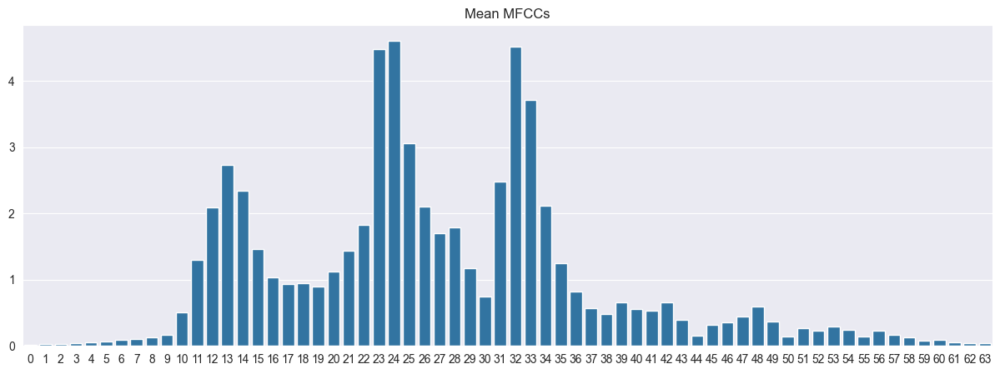

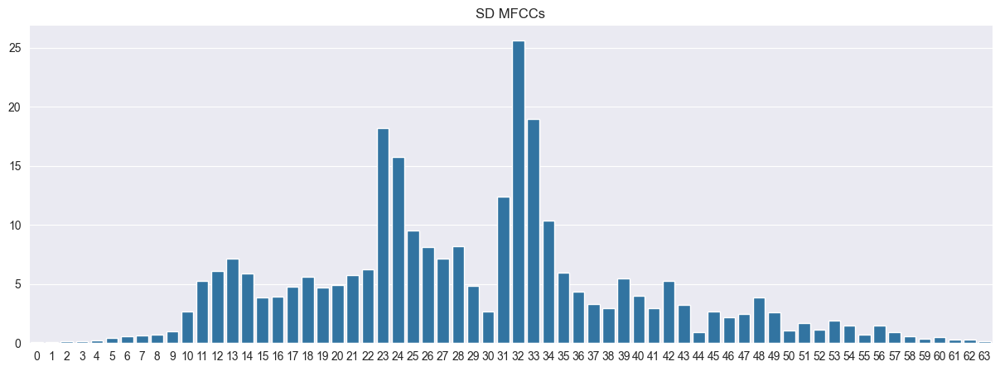

In [164]:
mfccs_mean=np.mean(mel_spec_np[:64],axis=1)
mfccs_std=np.std(mel_spec_np[:64],axis=1)

coeffs=np.arange(0,64)
plt.figure(figsize=(15,5))
plt.title('Mean MFCCs')
sns.barplot(x=coeffs,y=mfccs_mean)

plt.figure(figsize=(15,5))
plt.title('SD MFCCs')
sns.barplot(x=coeffs,y=mfccs_std)
# Generate the chroma Dataframe
mfccs_df=pd.DataFrame()
for i in range(0,64):
    mfccs_df['mfccs_mean_'+str(i)]=mfccs_mean[i]
for i in range(0,64):
    mfccs_df['mfccs_std_'+str(i)]=mfccs_mean[i]
mfccs_df.loc[0]=np.concatenate((mfccs_mean,mfccs_std),axis=0)
mfccs_df

### Спектральный центроид - Spectral Centroid
Спектральный центроид относится к спектральным (частотным) признакам. Спектральные характеристики всех звуковых сигналов определяются с помощью двух зависимостей:

- зависимость амплитуды от времени

- зависимость амплитуды от частоты Спектральный центроид указывает, на какой частоте сосредоточена энергия спектра ( энергия напряжения) или, другими словами, указывает, где расположен “центр масс” для звука.

In [165]:
cent = librosa.feature.spectral_centroid(y=processed_audio, sr=sr)
cent_mean=np.mean(cent)
cent_std=np.std(cent)
cent_skew=scipy.stats.skew(cent,axis=1)[0]
print('Mean: '+str(cent_mean))
print('SD: '+str(cent_std))
print('Skewness: '+str(cent_skew))

Mean: 2041.6787510948895
SD: 655.698962588578
Skewness: 0.6556334296961375


#### Спектральный спад - Spectral Rolloff
Спектральный спад относится к спектральным (частотным) признакам. Это мера формы сигнала, представляющая собой частоту, в которой высокие частоты снижаются до 0. Чтобы получить ее, нужно рассчитать долю элементов в спектре мощности, где 85% ее мощности находится на более низких частотах.

In [166]:
rolloff = librosa.feature.spectral_rolloff(y=processed_audio, sr=sr)
rolloff_mean=np.mean(rolloff)
rolloff_std=np.std(rolloff)
rolloff_skew=scipy.stats.skew(rolloff,axis=1)[0]
print('Mean: '+str(rolloff_mean))
print('SD: '+str(rolloff_std))
print('Skewness: '+str(rolloff_skew))

Mean: 4322.674418604651
SD: 1314.4571108928744
Skewness: -1.0833448680771622


Извлечение значимых характеристик

In [37]:
def extract_features_with_noise_podcast(file_path):
    name = file_path
    y, sr = process_audio_noise_podcast(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

In [38]:
def extract_features_with_noise_crowd(file_path):
    name = file_path
    y, sr = process_audio_noise_crowd(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

In [39]:
def extract_features_with_cycle_podcast(file_path):
    name = file_path
    y, sr = process_audio_cycle_podcast(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

In [40]:
def extract_features_with_cycle_crowd(file_path):
    name = file_path
    y, sr = process_audio_cycle_crowd(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

In [66]:
def extract_features_with_noise_podcast_65(file_path):
    name = file_path
    y, sr = process_audio_noise_podcast(name)

    features = []
    features.append(file_path[-36:])  # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=40)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=40)])  # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis=0)[0])  # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                           axis=0)[0])  # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                                     axis=0)[0])  # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis=0)[0])  # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis=0)[0])  # rolloff_std
    features.append(str(major_train[major_train['audio_path'] == file_path[-36:]].annotator_emo))
    return features


def extract_features_with_noise_crowd_65(file_path):
    name = file_path
    y, sr = process_audio_noise_crowd(name)

    features = []
    features.append(file_path[-36:])  # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=40)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=40)])  # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis=0)[0])  # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                           axis=0)[0])  # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                                     axis=0)[0])  # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis=0)[0])  # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis=0)[0])  # rolloff_std
    features.append(str(major_train[major_train['audio_path'] == file_path[-36:]].annotator_emo))
    return features


def extract_features_with_cycle_podcast_65(file_path):
    name = file_path
    y, sr = process_audio_cycle_podcast(name)

    features = []
    features.append(file_path[-36:])  # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=40)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=40)])  # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis=0)[0])  # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                           axis=0)[0])  # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                                     axis=0)[0])  # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis=0)[0])  # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis=0)[0])  # rolloff_std
    features.append(str(major_train[major_train['audio_path'] == file_path[-36:]].annotator_emo))
    return features


def extract_features_with_cycle_crowd_65(file_path):
    name = file_path
    y, sr = process_audio_cycle_crowd(name)

    features = []
    features.append(file_path[-36:])  # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=40)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=40)])  # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis=0)[0])  # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                           axis=0)[0])  # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                                     axis=0)[0])  # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis=0)[0])  # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis=0)[0])  # rolloff_std
    features.append(str(major_train[major_train['audio_path'] == file_path[-36:]].annotator_emo))
    return features

In [36]:
def extract_features_with_cycle_podcast_200(file_path):
    name = file_path
    y, sr = process_audio_cycle_podcast(name)

    features = []
    features.append(file_path[-36:])  # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=100)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=100)])  # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis=0)[0])  # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                           axis=0)[0])  # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                                     axis=0)[0])  # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis=0)[0])  # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis=0)[0])  # rolloff_std
    features.append(np.mean(librosa.feature.zero_crossing_rate(y=y).T, axis = 0)[0])
    features.append(np.std(librosa.feature.zero_crossing_rate(y=y).T, axis = 0)[0])
    features.append(str(major_train[major_train['audio_path'] == file_path[-36:]].annotator_emo))
    return features


def extract_features_with_cycle_crowd_200(file_path):
    name = file_path
    y, sr = process_audio_cycle_crowd(name)

    features = []
    features.append(file_path[-36:])  # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=100)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=100)])  # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis=0)[0])  # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                           axis=0)[0])  # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                                     axis=0)[0])  # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis=0)[0])  # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis=0)[0])  # rolloff_std
    features.append(np.mean(librosa.feature.zero_crossing_rate(y=y).T, axis = 0)[0])
    features.append(np.std(librosa.feature.zero_crossing_rate(y=y).T, axis = 0)[0])

    features.append(str(major_train[major_train['audio_path'] == file_path[-36:]].annotator_emo))
    return features

In [69]:
buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 101)])
header.extend([f'mfcc_std{i}' for i in range(1, 101)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std','zero_cross_mn','zero_cross_std',
               'label'])

with open('dataset_podcast_cycle_200.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='podcast'].audio_path: #get file names
        features = extract_features_with_cycle_podcast_200(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0

In [70]:
podcast_train_cycle_200 = pd.read_csv('dataset_podcast_cycle_200.csv')
podcast_train_cycle_200

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,db587c269a7fb9a544b9c02a6171633c.wav,-336.91200,102.111420,-31.757267,29.448456,-17.105572,7.982278,-23.395226,-4.555601,-30.057444,-5.210704,-12.468637,-10.110807,-9.771871,2.797960,-5.373586,-4.892001,-0.398369,5.096264,-1.496618,-2.951835,-1.539549,2.661897,-2.437671,-3.388890,3.166233,2.785954,-0.871126,2.633872,-1.734528,3.130712,-0.072206,-2.204188,0.242158,-2.404803,-1.482295,1.786758,1.720604,2.338185,2.202402,1.028892,2.604265,-0.456120,0.383010,0.757767,0.722926,1.423496,0.723318,0.895469,0.749252,-1.127577,0.590324,-0.799997,-0.043108,-0.177683,-1.238712,0.855539,-0.443955,-1.522994,0.853301,0.891244,0.817344,-0.639652,0.878790,1.450091,-0.966822,-0.065961,0.436689,-0.446129,0.062236,-0.364939,0.821577,0.332322,-1.066149,-0.020534,-0.494770,-0.586696,-0.291601,-0.891211,-0.330290,-0.107820,-0.835946,-0.540417,-0.069001,0.073132,-0.909512,-1.163247,-0.802378,-1.275053,-0.709095,-0.074437,0.048351,0.973457,0.921915,0.525921,0.778429,-0.101225,-0.115404,-0.223082,-0.309291,0.602255,123.271520,77.023960,30.288214,35.557228,22.140570,18.469343,19.235270,15.176190,18.357052,14.002660,12.872699,8.466398,9.764970,8.214988,7.287244,7.210802,6.410968,5.407102,6.307773,5.349230,5.405661,5.243375,4.731853,4.420103,4.571163,3.867978,4.502294,4.651762,4.312501,3.690269,3.043552,3.353984,3.916351,4.997042,5.266265,4.714484,5.096071,4.538117,4.984679,4.757272,4.674020,4.453247,4.052406,3.576176,4.152071,5.429452,5.531841,4.949022,4.287968,3.914003,3.554678,3.713516,3.374638,3.459340,3.448162,3.278079,3.591064,3.382103,2.924099,3.078311,2.994221,3.121845,3.249127,3.335306,3.207959,3.114937,2.

In [71]:
buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 101)])
header.extend([f'mfcc_std{i}' for i in range(1, 101)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std','zero_cross_mn','zero_cross_std',
               'label'])

with open('dataset_crowd_cycle_200.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='crowd'].audio_path: #get file names
        features = extract_features_with_cycle_crowd_200(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0

In [72]:
crowd_train_cycle_200 = pd.read_csv('dataset_crowd_cycle_200.csv')
crowd_train_cycle_200

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,ea0f98b720247329cb817138c2f628dd.wav,-416.31076,92.022140,8.281179,16.198270,-0.936501,-1.026557,-0.820926,-10.904892,-4.460922,-9.831796,2.414729,-9.357346,-1.262992,-2.283333,-9.902399,0.617525,-6.295304,-1.237704,-0.746776,-5.747520,-0.963644,-1.022405,1.043999,6.829342,4.699425,9.967783,3.387162,6.466811,-1.055453,0.961022,-1.544693,2.375060,-2.158074,-0.052250,-0.717584,0.300643,-1.809443,-0.733228,-5.115393,-1.985247,-3.218359,-3.301126,-3.615870,-2.785368,-2.766621,-1.762610,-2.162419,-1.302676,-1.276341,-0.534420,-1.664901,-0.286600,-2.083095,0.823001,-3.301691,0.290000,-0.978156,-0.069865,-0.970305,-0.211424,0.236216,0.074348,-0.227397,0.778327,-1.166701,-0.664969,-0.281549,0.237870,-0.649346,0.131668,-1.932842,-1.451750,-2.126951,-1.164420,-2.618154,-0.827134,-2.029711,-0.592424,-1.193040,-0.050078,-0.675225,-0.092497,-1.082167,-0.458054,-1.249633,-0.642827,-1.244604,-0.611514,-1.452568,-0.343360,-0.852291,0.319510,-1.267048,-1.226245,-1.681598,-0.954266,-1.668372,-1.499528,-1.723242,-1.148087,105.970600,33.132618,28.013847,23.422653,21.569332,16.596191,11.430403,12.314257,10.125980,8.662791,6.904030,10.394081,6.286224,5.080739,6.273829,6.459737,9.223018,10.254317,6.558453,9.613936,8.224324,6.965076,7.323610,9.409914,13.180948,14.475088,12.208991,11.060138,11.134114,9.059981,9.837153,8.885558,7.699648,8.533421,6.020751,4.279263,4.790843,4.780743,5.203868,4.606727,4.539925,5.174113,4.002665,5.437748,4.714987,5.700115,6.059845,6.026706,4.900537,4.996851,4.482159,5.971661,5.712463,6.629459,5.071481,4.644053,4.241181,3.511219,3.303602,3.570986,3.948244,4.804130,3.557213,4.239606,4

 здесь преобразовывали подкаст с шумом-> 5.5 сек таргет 0 отброс


In [126]:
"""buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 41)])
header.extend([f'mfcc_std{i}' for i in range(1, 41)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_podcast_noise_85.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='podcast'].audio_path: #get file names
        features = extract_features_with_noise_podcast_65(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

In [131]:
podcast_train_noise_85 = pd.read_csv('dataset_podcast_noise_85.csv')
podcast_train_noise_85

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,d8e17d518e78d83b1cd4213aeecdd007.wav,-293.344117,48.268627,-0.464978,14.892733,1.417772,5.267082,-4.671775,-2.232508,-4.859148,2.531780,-2.871104,1.271092,-1.475051,-1.211147,-1.557447,-0.366388,0.073378,-1.555441,0.622520,-0.122834,-1.264377,-0.316123,-0.815921,0.519054,-0.456440,-0.062919,-1.837235,-0.399758,-3.131952,-0.768626,-2.065385,0.704223,-1.249636,-1.605596,-1.843075,-1.214510,-1.005637,0.542051,1.111557,2.460881,81.326781,67.037874,28.720868,26.090927,19.759351,9.285587,10.428648,8.659050,11.854331,11.770324,9.756891,4.453295,6.259528,7.811997,5.037842,7.319105,4.896407,4.262408,4.736049,4.020562,4.967725,4.686918,4.090685,3.829028,3.854906,3.661797,4.896481,3.845997,4.963965,3.631426,4.270856,3.148131,3.850129,3.890676,4.665136,4.116475,3.964536,5.342460,7.279932,8.546589,2778.129428,1456.039615,-0.430783,4833.711846,2420.759501,"7 neutral\nName: annotator_emo, dtype: object"
1,4361f30098f1bd06fc8c04efac732ec8.wav,-310.911186,93.873117,5.755329,9.977184,-20.177747,-0.806179,-15.828703,-8.501473,-17.300207,-11.107744,-7.128444,-6.182044,-8.109626,-1.475043,2.312654,-4.336127,-2.591078,-0.670713,-8.217071,0.797825,-6.292540,-0.751639,-7.693060,-0.856911,-3.293286,-2.040021,-3.594948,-0.682166,-0.786268,-0.617798,-1.436134,0.155366,-1.135356,-0.241543,-2.896130,0.488684,-2.424474,2.133470,-0.240751,0.902813,113.082693,60.588170,26.829289,30.290528,21.308181,14.904188,16.023800,12.555782,16.366265,13.702925,11.207806,9.589964,10.730057,7.698769,7.775346,10.976636,5.820236,7.001568,8.546125,5.816831,7.027704,5.373576,8.269176,4.968119,5.066002,5.338985,5.527795,4.422482,4.153093,4.569502,4.399173,3.939091,4.956204,5.063308,4.471034,3.743874,5.632772,5.942513,6.116654,5.066873,1865.899082,1046.213333,0.820359,3494.821948,1923.844513,"8 neutral\nName: annotator_emo, dtype: object"
2,a2ed1c487116c1c423a040873b93e82c.wav,-332.054426,64.127175,4.810662,27.973112,10.815059,-8.519807,-5.439010,-0.085446,-9.753454,-4.770625,-1.413590,-1.485139,-6.572364,-2.532179,-4.090723,-5.693195,-8.408854,-4.177075,-5.598082,-4.463161,-6.401454,-3.252341,-5.235748,-6.476717,-7.329488,-3.718036,-5.303825,-3.781405,-3.912723,-2.091647,-4.542148,-1.665350,-2.739542,-2.703960,-3.667030,-1.769815,-3.070943,-1.645287,-3.203798,-2.692172,130.595355,73.190138,32.843794,34.886687,16.958698,18.173667,14.049788,12.812220,14.323527,11.001939,12.024723,7.114081,8.957330,8.019389,6.160024,6.772775,7.877819,5.288190,5.934626,5.433051,5.888424,4.901432,5.046136,5.556190,6.054024,3.997237,5.102252,4.553529,4.493519,4.299966,4.742367,3.595064,3.958272,5.396128,5.479688,5.269251,4.203929,4.554837,4.347631,4.393840,2189.627109,1393.049506,0.447698,3961.028343,2235.624852,"12 neutral\nName: annotator_emo, dtype: object"
3,45442c2daba0d3c240169c4c0d9acb97.wav,-298.292673,22.028112,11.863940,12.013055,0.338650,-1.285540,1.115877,0.578978,-1.815993,-2.081715,-0.999401,-2.575975,-0.557465,0.358869,-1.590872,-0.554003,-2.232057,-0.901071,-1.262608,-2.496461,-3.037552,-0.575927,-1.863009,-0.434065,-0.204596,0

In [132]:
podcast_train_noise = pd.read_csv('dataset_podcast_noise.csv')
podcast_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,5158153917504044ff0844ab87899435.wav,-319.294309,28.890074,9.858651,16.462542,-2.480718,1.432893,-12.708562,-12.538723,-2.699504,-5.339520,0.674915,3.962759,-0.447320,2.503902,1.185261,-1.828381,-0.570133,2.214373,-2.678391,-0.585662,93.754025,62.181564,29.178686,27.038758,11.007320,13.439199,20.331830,21.843913,11.365250,10.929260,6.689740,7.303911,7.639941,6.342582,5.772870,7.143129,5.654314,5.116835,5.438964,5.104823,3089.150774,1368.227739,-0.836943,5342.614462,2156.722708,"1 neutral\nName: annotator_emo, dtype: object"
1,e40538ced8b4dff0fd07d0cbab54ac4d.wav,-234.175386,36.413577,8.247422,6.633734,3.950837,2.239078,-0.057224,-1.968632,-1.999052,3.426766,-1.057011,2.169706,-2.262934,2.961275,-4.254949,0.124155,-2.093532,-1.190318,-2.313268,-0.098204,105.044023,54.492868,18.325998,13.380170,12.654490,10.105406,8.692149,7.730409,7.681158,8.771454,6.001646,5.592506,7.871402,7.305859,8.013734,4.448453,5.369069,5.336646,5.573717,4.151547,3065.278898,1259.070860,-0.736945,5536.246366,1923.804229,"2 neutral\nName: annotator_emo, dtype: object"
2,203dcf3107c04ad45addb2740504d757.wav,-296.681157,20.689858,3.944132,6.788943,0.317742,-0.050694,-4.277966,-0.214784,-2.299038,-0.007617,-0.751044,-1.124547,0.592289,0.701956,-1.318400,-0.041290,-1.893540,-1.041378,-2.463606,0.902982,75.846335,46.936887,13.267235,13.205860,11.364156,8.656387,11.177419,4.093303,7.876257,5.243061,4.572676,5.201312,5.164711,5.655704,5.977719,3.896549,4.287181,3.484910,5.799665,3.657318,3366.166969,1136.691714,-1.546232,5878.542878,1845.065468,"3 neutral\nName: annotator_emo, dtype: object"
3,8f5f23aa62832c77421352c6a028ac67.wav,-252.997215,51.622150,4.419663,27.044573,3.470470,3.295218,-7.740946,-1.500885,-7.972449,-3.757963,0.412697,-1.795191,-3.716522,1.574668,-7.423757,1.494477,-5.053501,-2.947060,-5.359055,-0.057296,96.767144,54.657714,26.945352,29.890672,14.354400,14.893001,13.621911,10.243314,12.555289,8.107879,8.368104,8.401011,7.205288,6.541098,9.850367,4.949095,6.964302,5.952448,6.551504,4.595464,2555.384898,1325.952769,0.101855,4567.678052,2052.817151,"4 neutral\nName: annotator_emo, dtype: object"
4,adfc339f23bacee7acf2b414696ee4e7.wav,-270.827627,61.162682,16.747429,10.162775,3.493166,3.534647,-5.453890,6.320809,2.003002,2.001028,-5.498497,-3.041094,-1.264784,3.659483,-0.427559,1.920510,0.761693,5.072441,-0.623013,1.929202,92.661351,55.605909,23.953232,16.070264,8.282142,7.809610,10.688987,8.947688,8.664140,5.899060,8.276684,5.824024,4.850124,4.811679,4.784979,4.024914,4.463090,6.218594,3.845756,4.117603,2548.142662,1190.053272,-0.005298,4905.250727,1936.811704,"5 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42331,55a54d98443cb0edc9aa78d79e23db94.wav,-266.532924,55.921392,-5.986858,10.752180,-2.328082,-6.262377,0.066371,-12.473870,3.513513,-4.051296,-0.558399,-7.408685,-3.426834,-1.641309,-7.641269,-0.746415,-2.203686,-1.610515,-6.327292,-3.158510,72.184168,59.714436,32.422046,20.737078,24.209665,15.759502,10.019555,15.603907,11.492558,14.338808,8.833475,13.656791,9.797763,11.731910,7.806948,7.099000,7.281112,7.565532,8.938708,6.546746,2582.537614,1282.762019,0.171101,4665.016352,2144.326838,"161058 positive\nName: annotator_emo, dtype: object"
42332,1ab446e4e07e257f185718d60f0fa987.wav,-365.399822,16.484795,3.007936,12.174409,2.801758,5.044237,4.183793,

In [53]:
"""buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 41)])
header.extend([f'mfcc_std{i}' for i in range(1, 41)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_podcast_cycle_85.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='podcast'].audio_path: #get file names
        features = extract_features_with_cycle_podcast_65(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

In [133]:
podcast_train_cycle_85 = pd.read_csv('dataset_podcast_cycle_85.csv')
podcast_train_cycle_85

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,9b0cdfc11b0212236cfb6b578ce2ea3d.wav,-430.86526,58.065395,9.273168,10.258363,-7.481528,1.460947,4.623135,-12.880345,-7.798800,-3.894938,-5.741312,-3.065059,-7.624657,1.171287,-4.892878,-3.641004,-0.634467,-2.659133,-2.272308,-0.544493,-5.544637,-0.901385,-2.576173,-3.688957,-1.991616,-1.726168,-4.040762,-1.107517,-2.224095,-1.054070,-1.385984,-2.164192,-0.645095,0.598834,-1.416627,0.969329,-1.051339,1.622073,-0.516967,-0.782292,166.157700,73.901344,23.520506,22.726841,19.053663,11.069079,10.800358,19.057808,12.830483,10.688066,11.296902,6.758836,10.176570,8.689614,7.012600,6.266728,4.576441,4.791919,4.788337,4.642138,7.566765,3.196574,7.085519,5.630227,4.408024,3.403645,5.736203,5.017735,6.017779,6.171076,6.705852,6.632996,5.204998,4.712182,3.374213,5.000284,4.858031,5.033816,5.968797,6.686323,2250.703265,1276.514667,0.057238,4234.511265,2332.649262,"6 neutral\nName: annotator_emo, dtype: object"
1,792755d8a8fc9f4bf1f815fa79050680.wav,-229.09170,108.505905,1.073884,28.770462,10.999812,-2.655831,3.827254,-4.517269,-13.975496,4.035307,-5.119498,7.184988,-13.105911,5.497329,-3.638866,-5.870064,-2.640192,-3.668099,-7.604708,-1.699525,-4.931501,-2.447690,-3.666526,-3.710726,-2.967208,-6.154426,-3.128737,-4.125306,-5.066892,-2.240252,2.867175,7.834115,3.456449,1.397159,-5.771514,-3.984198,-4.916887,-2.832879,-1.210131,0.423236,125.330970,51.226063,38.967910,27.657830,10.117141,20.337955,9.867858,9.521421,12.310291,10.085718,10.800374,11.877806,10.734554,7.710856,7.759977,11.109792,6.553330,5.088107,5.261580,4.205970,5.774673,7.830397,5.282480,4.576516,6.746390,6.739625,5.749260,6.793311,5.962957,5.508008,13.035091,16.660536,13.156745,11.218698,7.371627,6.167397,5.545842,6.366691,5.104077,9.405601,1449.378601,931.073349,2.583098,2814.543968,1477.329087,"7 neutral\nName: annotator_emo, dtype: object"
2,b2e6e30d15ef7f1e4fc19949951d1fd7.wav,-288.43668,71.156470,20.669847,40.678272,12.055193,3.923895,-6.455475,-4.928141,-4.756352,4.687185,-2.934158,-9.587692,-7.421967,4.839008,-8.643821,7.814768,-6.527754,0.703356,-4.816350,1.618578,-7.100208,-3.313616,-0.153860,-0.460135,-6.426306,-0.509068,-6.909677,-1.966646,-3.287178,-1.877588,-2.403391,-2.537932,-2.018885,0.529252,0.800874,4.308160,0.152730,1.323096,-0.354499,1.021233,149.074460,68.313614,39.342820,38.067013,16.127232,19.291214,14.506184,12.864545,12.202353,14.162579,12.679401,10.018903,10.727106,8.079117,12.287322,7.629687,9.135511,7.732757,9.611102,6.788276,8.976537,5.114125,5.119805,5.373982,7.339634,4.628744,5.529979,4.298800,5.047105,5.284196,4.693956,4.539469,5.665150,5.402906,6.549297,6.568316,7.795507,5.921633,4.412435,3.987089,1743.489635,1292.038411,1.134290,3192.178416,2083.216671,"9 neutral\nName: annotator_emo, dtype: object"
3,f66503d0493ca4bcfaa8bfb42826cc40.wav,-295.99980,93.974220,-5.699137,39.917250,8.807420,0.605966,5.679043,-10.478949,-9.772705,5.860835,-4.971474,5.306729,-9.693775,4.719766,-1.760747,0.771650,-4.067433,-1.037926,-4.288608,-0.616691,-1.673055,-1.425706,-4.088466,-2.045446,-5.847139,-2.25393

In [134]:
podcast_train_cycle = pd.read_csv('dataset_podcast_cycle.csv')
podcast_train_cycle

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,5158153917504044ff0844ab87899435.wav,-323.255370,81.207750,19.239433,40.477585,-7.804307,3.278185,-33.446148,-33.200848,-7.680809,-14.770613,1.222663,9.813126,-1.421650,6.049303,2.087312,-5.659168,-1.999272,6.031729,-6.991830,-2.401501,145.030140,72.969505,42.270270,31.820219,16.355194,20.297790,21.602037,23.866388,16.608519,12.745991,9.773533,7.415072,11.268166,7.555798,8.278903,9.927253,8.140427,5.738565,6.264623,7.264681,1652.481062,1186.771174,1.486367,3019.304142,1809.014351,"1 neutral\nName: annotator_emo, dtype: object"
1,e40538ced8b4dff0fd07d0cbab54ac4d.wav,-113.867004,100.638214,21.792713,17.410252,8.034764,6.334271,0.414879,-5.705953,-5.610863,9.111138,-2.282503,5.330256,-6.287840,8.257272,-10.120945,0.429585,-6.209764,-3.704848,-6.985035,-0.250216,95.924830,38.218445,25.014118,16.328478,19.761692,14.650597,13.108399,10.167703,11.175156,11.055519,9.266617,7.504594,11.608256,9.598148,10.505914,6.199660,6.606410,7.461046,6.553071,6.007270,1554.197904,722.901990,1.276750,3423.055959,1719.415716,"2 neutral\nName: annotator_emo, dtype: object"
2,203dcf3107c04ad45addb2740504d757.wav,-283.995880,87.701430,13.728547,22.754946,-0.366873,0.281427,-16.665052,-0.864938,-8.598406,0.986548,-0.963775,-3.173005,2.681369,3.457153,-3.993916,0.320632,-5.579373,-3.590393,-8.686476,3.844702,143.468110,52.186714,23.302132,17.094679,22.307423,16.684044,16.370712,6.768546,13.126007,9.218285,7.646343,8.223038,8.125205,9.480585,9.569587,6.110064,5.175346,3.602204,6.355133,5.067564,1651.207280,942.358153,0.253639,3337.481831,2066.861469,"3 neutral\nName: annotator_emo, dtype: object"
3,8f5f23aa62832c77421352c6a028ac67.wav,-206.183690,76.213350,7.619406,38.788017,5.454956,3.549383,-14.224438,-1.369181,-13.924787,-5.984955,1.332529,-2.822296,-5.757420,1.778676,-11.686086,2.426802,-8.407279,-4.776047,-8.469259,0.153881,102.736340,47.019993,34.254093,29.313469,17.100065,18.626350,14.870586,12.459751,13.640052,9.550667,10.604004,9.816427,7.984314,7.626811,9.590367,5.687756,6.939344,6.251672,6.393018,5.585963,1893.108703,1061.237615,1.503751,3543.241279,1556.964531,"4 neutral\nName: annotator_emo, dtype: object"
4,adfc339f23bacee7acf2b414696ee4e7.wav,-275.517180,87.434720,21.519789,13.411670,5.219848,5.483545,-6.906782,9.244144,3.744348,2.941275,-7.024454,-3.695502,-1.810738,4.685296,-0.149680,2.361707,0.481557,6.494947,-0.808248,2.684872,107.811010,39.007904,24.779608,16.249811,8.502652,7.891657,12.352875,8.462659,10.396617,5.990576,8.917718,6.432206,5.093553,4.605859,5.144967,4.628339,5.223966,5.977146,3.915559,4.327794,1929.976228,753.300353,0.121618,4171.784157,1669.415120,"5 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42331,55a54d98443cb0edc9aa78d79e23db94.wav,-245.855290,84.940865,-12.777506,17.208483,-6.787427,-10.581666,-0.936245,-20.021072,3.627672,-9.444312,-0.938536,-13.947513,-6.543857,-3.698267,-11.637028,-0.793448,-4.540292,-4.023922,-10.908104,-5.381938,84.409134,51.946404,41.575570,24.252914,29.359007,18.967050,12.509345,15.668020,14.061615,16.597233,10.451643,14.785978,12.095972,14.683862,8.088262,8.480086,8.428138,8.835983,9.756001,7.119273,1865.695721,1011.843928,1.565729,3534.020712,1881.765570,"161058 positive\nName: annotator_emo, dtype: object"
42332,1ab446e4e07e257f185718d60f0fa987.wav,-463.759400,53.512790,8.285304,34.208702,5.90

здесь преобразовывали крауд с шумом 6 сек таргет 0.5 отброс

In [67]:
"""buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 41)])
header.extend([f'mfcc_std{i}' for i in range(1, 41)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_crowd_noise_85.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)

    for file in major_train[major_train['dataset']=='crowd'].audio_path: #get file names
        features = extract_features_with_noise_crowd_65(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

In [135]:
crowd_train_noise_85 = pd.read_csv('dataset_crowd_noise_85.csv')
crowd_train_noise_85

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,1eea91ec70debfe042d0fe8264953a5b.wav,-425.863867,37.072073,12.258921,15.977092,-3.980539,9.935592,-6.141489,6.051569,-2.639878,3.982249,1.123333,2.737173,-0.303541,4.865715,-4.934074,3.676857,-4.792362,3.040387,-4.346214,1.104105,-3.287971,3.279229,-4.088866,0.859327,-4.752936,-0.002229,-4.259280,1.611330,-2.560283,1.253464,-2.807408,0.596530,-2.721528,0.292529,-2.829246,1.274239,-0.990057,1.796580,-0.807336,2.315368,111.507610,41.302609,15.878575,16.647044,12.877242,13.056107,11.277310,8.334964,7.640527,7.723249,5.406085,6.365478,4.090305,5.473146,7.911586,5.098957,6.125006,5.043311,6.118294,5.361770,5.168242,5.236164,4.685289,4.473568,4.897785,4.404599,5.541259,4.491995,5.176944,4.744452,4.843134,4.069696,4.502018,4.551000,5.632601,5.517722,4.969411,6.015521,5.960328,6.611571,2947.611107,991.074581,-0.158023,5565.361555,1240.639622,"0 neutral\nName: annotator_emo, dtype: object"
1,363e920858cf8605a3480fb73cb30ec5.wav,-376.190499,59.506409,16.036444,2.282249,-6.027364,2.645734,3.673965,-17.769110,-6.200587,-3.161762,-4.677281,-4.030364,-3.272724,3.139515,-1.779921,7.552111,-5.496220,-5.595210,-2.836092,-1.943698,-5.775285,-6.705969,-8.141744,0.882170,-0.892611,-0.993010,-0.608221,1.195576,8.515052,6.530724,5.982759,2.562680,2.415250,2.518176,-1.087520,-1.918979,-3.018723,-0.714811,-1.068205,-2.278000,75.568163,64.301946,22.581562,18.919610,13.836767,16.253945,11.168340,17.842516,9.594043,7.735697,11.650889,8.182795,8.149419,4.936232,8.081763,8.204481,7.418114,8.293569,6.882803,8.372593,8.502971,7.518688,8.182957,5.408863,6.812543,5.497991,8.494348,9.310492,13.591250,12.368941,10.753370,9.946355,7.446324,5.654104,5.269429,4.298937,5.898584,4.623556,5.662253,4.332530,2548.649249,1435.945134,0.062242,4447.356468,2338.239588,"1 neutral\nName: annotator_emo, dtype: object"
2,0e82bd29c9857c9c249f3e5356f8533e.wav,-300.425255,56.794663,-4.399757,20.391717,2.741668,0.931036,0.237844,-0.407540,-2.688812,-3.720838,4.188699,1.209014,-3.940250,5.733734,-5.108632,-3.944615,-1.841018,-0.027090,-0.784925,0.553432,0.219061,-0.303884,0.063606,0.708528,-1.730481,0.839753,-1.708101,0.174170,-0.997825,-1.561899,0.057319,-1.328401,-0.564216,-0.995141,1.068499,-0.239251,1.299849,2.059033,1.043554,1.355820,53.694867,72.379911,17.836428,26.113435,15.781199,9.887910,7.855725,12.375206,7.020977,11.783252,6.995443,5.690200,8.035430,9.024665,7.924213,6.221743,4.833095,4.870826,5.033644,4.292863,5.561229,3.919781,3.725878,3.870600,4.774660,3.315533,4.226424,4.789657,4.665978,6.393739,6.094928,5.543101,4.854741,4.732483,4.670539,5.001016,6.698781,8.161495,8.711720,7.629895,2733.944446,1454.801066,-0.359857,4817.950581,2359.365094,"2 neutral\nName: annotator_emo, dtype: object"
3,e558050c31b6552670255ed70b2c454a.wav,-386.904212,30.200836,12.542347,-0.301733,9.278948,-3.295839,5.698788,-5.309023,0.885555,-7.829361,-2.377478,-2.963232,-3.710176,0.225711,-1.249761,-0.260707,-1.162064,0.092590,-1.307030,-0.803125,-2.900059,-0.139584,-3.241265,-1.784658,-2.676040,0.358163,-0.476605,1.069658,-0.265711,3.05

In [136]:
crowd_train_noise = pd.read_csv('dataset_crowd_noise.csv')
crowd_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-417.196999,60.296673,0.162958,17.073948,2.955306,10.704967,1.392254,4.025679,-4.149722,1.854494,-0.701672,-0.119519,0.529446,2.225929,-0.954188,-0.328533,-0.779162,0.317327,-0.417505,-0.609704,143.639721,58.153996,19.695838,20.950276,10.994999,9.470818,7.464794,9.036900,11.665705,7.471451,4.664963,4.354102,3.962702,4.467117,5.369225,4.227487,3.487987,3.948208,2.847002,3.764032,2552.208465,1178.796382,-0.022354,4910.837573,1829.506310,"0 neutral\nName: annotator_emo, dtype: object"
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-392.112082,56.103456,9.130655,14.125460,-2.355431,-2.378393,-4.078557,-11.728885,-0.130741,-6.238870,-2.191624,-4.364489,-2.586854,4.239801,-5.024844,3.151734,-4.210131,-0.037548,-5.659058,-1.646195,115.438538,57.442247,15.420287,18.397396,11.873911,5.582872,6.066067,11.835957,5.721463,7.928515,5.414836,6.145214,7.234187,6.534822,7.487494,4.562718,7.421540,4.157830,7.276784,3.454209,2644.195940,1266.271543,0.071199,4974.336846,1854.250101,"8 neutral\nName: annotator_emo, dtype: object"
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.143950,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,"11 neutral\nName: annotator_emo, dtype: object"
3,1445248482da5db46d38029617ac89a4.wav,-470.198014,13.555922,3.673559,-4.240874,0.702192,-3.755201,-0.321012,-2.073531,-3.415162,-1.519689,-3.903832,-1.334800,-2.807967,1.232592,-1.654989,-1.028368,-1.609744,-1.753385,-0.676156,-1.106154,177.451972,38.349782,14.885240,13.207395,10.486409,15.697632,9.460643,9.159868,9.529230,6.334092,8.583875,4.919791,8.248656,5.087342,4.999269,5.391873,3.980452,7.120730,3.782198,4.940295,3497.049424,869.512614,-1.435931,6210.619549,1345.915115,"12 neutral\nName: annotator_emo, dtype: object"
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-492.476993,52.863946,10.169741,-8.829163,3.426911,-0.289099,-4.357158,-1.603504,-6.222369,-0.845632,-1.171194,5.846378,-1.129260,8.241696,-1.564559,0.022718,-1.086052,-0.300568,-2.872380,-1.015646,194.008827,62.089413,17.275591,21.518865,14.283957,13.409918,12.169055,7.841156,15.246275,8.708287,11.296170,7.687052,8.649914,9.349564,8.170866,6.438350,7.082688,5.270082,6.171090,5.649261,2773.859623,1313.241981,-0.056769,5041.651526,2185.457845,"13 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118722,6368654eab71a47e6d9ff4e846c17985.wav,-282.990880,15.566238,-5.550830,-6.247572,-27.540585,-32.594364,-20.252440,-19.836740,-21.833610,-3.231508,-14.964249,-3.635193,-14.879270,-8.540065,-13.038589,-9.002732,-9.475420,-8.818267,-4.490953,-2.270721,56.094234,39.391907,14.050855,13.652239,11.645551,11.005224,9.020541,10.679311,10.622349,9.355360,10.940964,8.610011,8.127374,4.451495,4.918456,5.208376,5.406085,7.101984,6.184901,6.165962,3044.346847,865.091022,-0.942825,5699.309593,1218.333999,"152556 sad\nName: annotator_emo, dtype: object"
118723,41fdb0023038bfdfff12da17cef3e21f.wav,-565.001384,50.655920,11.138350,7.761943,-3.463824,-3.1403

In [69]:
"""buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 41)])
header.extend([f'mfcc_std{i}' for i in range(1, 41)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_crowd_cycle_85.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='crowd'].audio_path: #get file names
        features = extract_features_with_cycle_crowd_65(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

In [137]:
crowd_train_cycle_85 = pd.read_csv('dataset_crowd_cycle_85.csv')
crowd_train_cycle_85

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,1eea91ec70debfe042d0fe8264953a5b.wav,-521.09546,63.211052,18.538889,22.467293,-4.084557,16.792700,-7.026610,11.438933,-2.423285,8.425105,1.469111,5.431342,-0.492110,7.422756,-6.038994,6.516529,-6.309702,5.956050,-5.953938,3.730058,-4.543047,4.691480,-6.077981,0.942520,-7.344798,0.544036,-5.463185,4.363636,-1.374526,4.111041,-3.448724,0.369081,-5.228223,0.075790,-4.429928,1.840307,-2.326104,1.985196,-1.627309,3.069998,65.239580,28.898169,13.875507,12.428449,13.521148,11.587573,11.257417,7.535901,8.052610,7.734472,5.995280,6.635050,4.371682,4.087995,7.299711,4.623286,5.428656,5.075869,5.555319,6.114348,4.790083,5.188786,4.040011,4.535439,4.078957,5.303661,5.705019,6.225931,8.242825,7.645526,5.200780,4.491001,4.899043,5.028364,5.768295,5.677087,5.109217,6.414813,6.125465,6.707503,2187.601872,703.028838,0.591275,4727.788881,1107.778462,"0 neutral\nName: annotator_emo, dtype: object"
1,363e920858cf8605a3480fb73cb30ec5.wav,-425.91498,92.187960,21.269213,0.271258,-5.842022,2.089278,5.916405,-26.959728,-9.759957,-3.837540,-7.656571,-7.213402,-5.880498,4.379867,-2.882426,9.982515,-9.256194,-8.740344,-3.445716,-2.045116,-10.234421,-10.013928,-10.952175,1.862140,-1.335112,-2.420104,-1.752194,3.247146,14.759916,10.159458,8.336325,4.670157,4.356313,3.903877,-2.784314,-2.956625,-3.469492,-0.040206,-2.473580,-4.351184,86.434180,55.900043,21.853872,23.159334,15.900457,19.361382,12.738382,15.460214,10.668975,9.419206,13.263988,9.370239,8.832101,5.437285,9.816132,7.464654,6.507839,8.203049,8.059320,9.245628,9.073567,7.139452,7.712218,6.353754,8.112679,7.533005,11.444584,11.526541,14.499127,14.824301,12.804939,12.307423,8.434153,6.210081,6.325312,4.541350,6.879099,5.886856,6.475463,4.847267,1740.093257,1181.994766,1.361753,3120.594113,2019.682822,"1 neutral\nName: annotator_emo, dtype: object"
2,0e82bd29c9857c9c249f3e5356f8533e.wav,-308.51154,126.267850,-9.504063,43.462890,7.078705,3.291415,0.339564,-0.713893,-6.003462,-8.198472,8.949667,3.093620,-8.148194,12.033465,-9.847435,-8.045248,-3.488046,-0.635493,-1.867015,1.917718,1.092418,0.243022,1.338178,1.966220,-3.431333,1.247729,-3.383866,0.818968,-1.818012,-3.329769,-1.014374,-3.759136,-1.825039,-2.648346,1.699159,-0.693569,2.083588,4.148433,2.557991,3.279791,81.105750,45.729200,23.752192,21.321749,21.676899,14.542756,10.677503,17.361380,8.522185,15.339280,7.090508,8.083288,9.454620,8.852375,8.536924,6.277461,5.757379,5.804892,6.506647,5.656515,7.163466,4.700060,4.676595,4.585661,5.642563,3.983017,4.920260,6.336871,5.870075,8.233633,8.221124,6.758690,6.155618,5.793309,6.155479,6.586518,9.228495,10.874211,11.916828,10.092102,1229.710381,688.241180,2.317545,2457.939680,1335.693991,"2 neutral\nName: annotator_emo, dtype: object"
3,e558050c31b6552670255ed70b2c454a.wav,-499.99720,63.792366,24.833897,-1.055524,18.842121,-5.949051,11.603047,-10.878907,2.214535,-15.314258,-5.654404,-6.513677,-7.925723,-0.020425,-2.751681,-0.743792,-2.657186,0.369404,-2.819288,-1.567720,-5.447450,-0.207659,-6.759076,-3.736205,-4.346295,1.440834,-0.755217,2.410453,

In [138]:
crowd_train_cycle = pd.read_csv('dataset_crowd_cycle.csv')
crowd_train_cycle

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-446.67413,95.242820,-1.670538,27.858450,4.299340,16.288933,-0.170846,5.617592,-7.984962,2.550427,-0.982930,-0.010420,0.286150,3.315149,-1.760503,-0.304624,-1.364569,0.375851,-0.843823,-1.407902,158.357500,49.166405,26.651665,22.161602,14.416098,8.185359,10.164578,10.569049,14.470976,9.703464,5.695247,5.407980,4.679876,4.941588,6.780031,5.196189,4.096722,4.496749,3.008686,4.219836,1785.133155,794.976051,0.124626,3791.197311,1619.114260,"0 neutral\nName: annotator_emo, dtype: object"
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-456.47440,101.701330,16.827663,24.824260,-5.376925,-5.110459,-6.788558,-19.964792,0.203738,-11.162711,-4.073376,-7.585936,-4.908752,7.280245,-9.346578,4.962740,-7.732704,-0.172352,-10.437779,-2.975735,115.216225,33.457670,16.778767,18.876194,15.864126,6.638382,6.240815,9.075742,6.611964,7.545970,6.290136,6.448680,8.741797,7.219205,7.774602,4.692447,7.437623,4.994883,6.117890,3.308571,1601.223078,616.568742,2.523675,3537.881541,1291.970061,"8 neutral\nName: annotator_emo, dtype: object"
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.14395,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,"11 neutral\nName: annotator_emo, dtype: object"
3,1445248482da5db46d38029617ac89a4.wav,-625.88710,20.608204,6.367050,-5.768783,0.769513,-3.892202,0.718669,-1.903571,-4.239060,-2.722564,-5.710354,-2.455339,-3.705461,1.487825,-1.845989,-1.804917,-2.974193,-2.400772,-1.030550,-0.658360,103.290320,40.326836,16.587109,13.869019,12.145469,16.951550,10.466475,9.744697,9.617202,6.867713,8.788281,5.153576,8.168635,5.834752,5.530240,5.426542,4.040686,7.348878,3.528429,4.956956,3200.191560,899.167579,-0.543062,5975.744913,1424.640292,"12 neutral\nName: annotator_emo, dtype: object"
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-662.30835,90.309110,20.365908,-13.520356,3.908565,1.725654,-5.198056,-1.614399,-9.899353,-1.590807,-0.386770,8.998819,-0.424484,13.970779,-1.754893,0.151433,-1.913495,-0.505789,-3.922705,-1.364301,137.272960,48.089287,19.039183,27.205502,17.105268,17.746769,14.981679,8.678193,17.112295,10.506323,13.786446,6.873315,10.896487,8.311035,9.852216,8.058399,8.391487,6.559726,7.355875,6.714932,1878.586450,1003.319057,2.044726,3908.793605,2012.974353,"13 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118722,6368654eab71a47e6d9ff4e846c17985.wav,-282.99088,15.566238,-5.550830,-6.247572,-27.540585,-32.594364,-20.252440,-19.836740,-21.833610,-3.231508,-14.964249,-3.635193,-14.879270,-8.540065,-13.038589,-9.002732,-9.475420,-8.818267,-4.490953,-2.270721,56.094234,39.391907,14.050855,13.652239,11.645551,11.005224,9.020541,10.679311,10.622349,9.355360,10.940964,8.610011,8.127374,4.451495,4.918456,5.208376,5.406085,7.101984,6.184901,6.165962,3044.346847,865.091022,-0.942825,5699.309593,1218.333999,"152556 sad\nName: annotator_emo, dtype: object"
118723,41fdb0023038bfdfff12da17cef3e21f.wav,-632.22770,64.776760,9.989553,5.664871,-4.545020,-3.710864,

# SYOUDA

In [65]:
major_test

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,9e9961c53ca6eeb440b217e539fbf46c,9e9961c53ca6eeb440b217e539fbf46c.wav,5.82,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,я слушаю,neutral,4282ddc30d71ef420e202e0c60391e9f,crowd
1,0166f65a30354db8282682b1a280e64c,0166f65a30354db8282682b1a280e64c.wav,3.70,1.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,каким стал сбер,neutral,d70dc98ed56e9362eaefefb7b2827c8f,crowd
2,d49a6b560155831725a7bdc7d0a96099,d49a6b560155831725a7bdc7d0a96099.wav,4.38,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,где родился шерлок холмс,neutral,0ee35d2abecf4272ecc8e1539b0839d8,crowd
3,c6852b0925797612d7b6724da8cbe7b4,c6852b0925797612d7b6724da8cbe7b4.wav,8.58,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,открой в браузере ennio morricone,neutral,0855e363c1787df1592f58f7a27ebe13,crowd
4,64a7aa17132c3e4b7be1aaed5fc88090,64a7aa17132c3e4b7be1aaed5fc88090.wav,5.06,2.0,NaN,32bd471407fe168dacd5f8252f9949b7,а там и ева проснулись с утра,positive,82f97728c4767b283d249afc96d23caf,crowd
...,...,...,...,...,...,...,...,...,...,...
12046,0b5911175dd80e2d5b0f6ebe2281fcf1,0b5911175dd80e2d5b0f6ebe2281fcf1.wav,2.60,0.0,NaN,d7fe5fc7ecf7df35fc43859c99491cd6,NaN,NaN,0f9ed62245fdc1e36a3bf8c0f7270c41,podcast
12047,1227da4809819378be4f2aac7353c592,1227da4809819378be4f2aac7353c592.wav,1.30,0.0,NaN,013f1749c55055e16f8acf9817598b2d,NaN,NaN,742833af70986b8ff933b1cb75cb0987,podcast
12048,b7ac0b2d52191acfa44cbcc09d071de4,b7ac0b2d52191acfa44cbcc09d071de4.wav,3.10,0.0,NaN,9fccb985c2f1910e12a1b7386180aa59,NaN,NaN,6a2370e4e8cc496c4d59408bb2a9995a,podcast
12049,7e62e88117cc0cc20bba2c7902cee97d,7e62e88117cc0cc20bba2c7902cee97d.wav,2.10,0.0,NaN,d6b5eac94428cfad71114fbccbcf4dbc,NaN,NaN,d0c7db9d0bc8dd57be358f6bf13d3f90,podcast


In [66]:
buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 101)])
header.extend([f'mfcc_std{i}' for i in range(1, 101)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std','zero_cross_mn','zero_cross_std',
               'label'])

with open('dataset_test_crowd_cycle_200.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_test[major_test['dataset']=='crowd'].audio_path: #get file names
        features = extract_features_with_cycle_crowd_200(fr'DATASET_PATH\wavs_test\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0

In [67]:
pd.read_csv('dataset_test_crowd_cycle_200.csv')

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,9e9961c53ca6eeb440b217e539fbf46c.wav,-545.70270,51.056060,27.216883,12.145612,10.194886,15.474760,6.492830,3.450592,0.820008,-0.937856,-2.819215,0.181226,0.019525,1.083165,-2.866161,-2.865540,2.240617,-3.826566,-5.193896,-1.041131,0.016556,-2.959668,-2.166975,-0.166132,-4.819757,0.919001,-3.877790,-0.118375,-2.531888,1.253588,0.419285,0.599615,-2.168774,1.276785,-2.926563,-0.404303,-1.813945,-0.468795,-1.948603,-0.310554,-4.676249,-0.381807,-3.519036,-0.583076,-3.786471,-0.012491,-1.917313,-1.558825,-3.038565,-0.229713,-3.264936,-0.563283,-1.771541,-1.061832,-2.317209,-1.003310,-2.076314,-0.055006,-1.607609,-1.656900,-1.950485,-0.155263,-0.856798,0.857437,-1.732035,-1.075995,-1.785594,0.017619,-1.487531,-0.260636,-1.926369,-0.352212,-1.491447,-0.806296,-2.240474,-1.277959,-2.082416,-0.688659,-1.728290,-0.236983,-0.605199,0.111202,-0.880527,0.636787,-0.459991,0.462042,-0.216134,0.696455,0.157408,1.144252,0.244569,1.198962,0.051727,1.834558,0.555458,0.760248,-0.501878,0.006653,0.045340,0.609428,77.033540,28.172934,13.440990,17.551485,9.465514,9.256212,9.991407,9.122308,8.250088,7.817865,8.561604,5.458817,7.859258,6.317846,6.139263,5.203279,6.664603,5.916555,6.611006,5.904414,4.419327,5.543364,5.093056,4.727286,4.459492,4.256617,5.092022,4.796088,5.477122,6.816209,8.289555,9.527467,6.403502,5.330311,4.996393,4.512577,3.292970,3.741748,3.680133,3.225398,3.274878,3.598531,3.240842,2.980377,2.966941,4.119382,3.451920,3.001164,3.569692,3.137529,3.219429,2.920950,3.125623,3.598267,3.011055,3.239844,3.364580,3.790381,2.996075,2.904614,3.372414,3.557441,4.426767,3.691955,3.177957,2.387451,2.42866

In [68]:
buffer = []
buffer_size = 10000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 101)])
header.extend([f'mfcc_std{i}' for i in range(1, 101)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std','zero_cross_mn','zero_cross_std',
               'label'])

with open('dataset_test_podcast_cycle_200.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_test[major_test['dataset']=='podcast'].audio_path: #get file names
        features = extract_features_with_cycle_crowd_200(fr'DATASET_PATH\wavs_test\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0

### Данные с заполнением шумом

In [139]:
podcast_train_noise['dataset']= 'podcast'
crowd_train_noise['dataset']= 'crowd'


In [140]:
podcast_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,5158153917504044ff0844ab87899435.wav,-319.294309,28.890074,9.858651,16.462542,-2.480718,1.432893,-12.708562,-12.538723,-2.699504,-5.339520,0.674915,3.962759,-0.447320,2.503902,1.185261,-1.828381,-0.570133,2.214373,-2.678391,-0.585662,93.754025,62.181564,29.178686,27.038758,11.007320,13.439199,20.331830,21.843913,11.365250,10.929260,6.689740,7.303911,7.639941,6.342582,5.772870,7.143129,5.654314,5.116835,5.438964,5.104823,3089.150774,1368.227739,-0.836943,5342.614462,2156.722708,"1 neutral\nName: annotator_emo, dtype: object",podcast
1,e40538ced8b4dff0fd07d0cbab54ac4d.wav,-234.175386,36.413577,8.247422,6.633734,3.950837,2.239078,-0.057224,-1.968632,-1.999052,3.426766,-1.057011,2.169706,-2.262934,2.961275,-4.254949,0.124155,-2.093532,-1.190318,-2.313268,-0.098204,105.044023,54.492868,18.325998,13.380170,12.654490,10.105406,8.692149,7.730409,7.681158,8.771454,6.001646,5.592506,7.871402,7.305859,8.013734,4.448453,5.369069,5.336646,5.573717,4.151547,3065.278898,1259.070860,-0.736945,5536.246366,1923.804229,"2 neutral\nName: annotator_emo, dtype: object",podcast
2,203dcf3107c04ad45addb2740504d757.wav,-296.681157,20.689858,3.944132,6.788943,0.317742,-0.050694,-4.277966,-0.214784,-2.299038,-0.007617,-0.751044,-1.124547,0.592289,0.701956,-1.318400,-0.041290,-1.893540,-1.041378,-2.463606,0.902982,75.846335,46.936887,13.267235,13.205860,11.364156,8.656387,11.177419,4.093303,7.876257,5.243061,4.572676,5.201312,5.164711,5.655704,5.977719,3.896549,4.287181,3.484910,5.799665,3.657318,3366.166969,1136.691714,-1.546232,5878.542878,1845.065468,"3 neutral\nName: annotator_emo, dtype: object",podcast
3,8f5f23aa62832c77421352c6a028ac67.wav,-252.997215,51.622150,4.419663,27.044573,3.470470,3.295218,-7.740946,-1.500885,-7.972449,-3.757963,0.412697,-1.795191,-3.716522,1.574668,-7.423757,1.494477,-5.053501,-2.947060,-5.359055,-0.057296,96.767144,54.657714,26.945352,29.890672,14.354400,14.893001,13.621911,10.243314,12.555289,8.107879,8.368104,8.401011,7.205288,6.541098,9.850367,4.949095,6.964302,5.952448,6.551504,4.595464,2555.384898,1325.952769,0.101855,4567.678052,2052.817151,"4 neutral\nName: annotator_emo, dtype: object",podcast
4,adfc339f23bacee7acf2b414696ee4e7.wav,-270.827627,61.162682,16.747429,10.162775,3.493166,3.534647,-5.453890,6.320809,2.003002,2.001028,-5.498497,-3.041094,-1.264784,3.659483,-0.427559,1.920510,0.761693,5.072441,-0.623013,1.929202,92.661351,55.605909,23.953232,16.070264,8.282142,7.809610,10.688987,8.947688,8.664140,5.899060,8.276684,5.824024,4.850124,4.811679,4.784979,4.024914,4.463090,6.218594,3.845756,4.117603,2548.142662,1190.053272,-0.005298,4905.250727,1936.811704,"5 neutral\nName: annotator_emo, dtype: object",podcast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42331,55a54d98443cb0edc9aa78d79e23db94.wav,-266.532924,55.921392,-5.986858,10.752180,-2.328082,-6.262377,0.066371,-12.473870,3.513513,-4.051296,-0.558399,-7.408685,-3.426834,-1.641309,-7.641269,-0.746415,-2.203686,-1.610515,-6.327292,-3.158510,72.184168,59.714436,32.422046,20.737078,24.209665,15.759502,10.019555,15.603907,11.492558,14.338808,8.833475,13.656791,9.797763,11.731910,7.806948,7.099000,7.281112,7.565532,8.938708,6.546746,2582.537614,1282.762019,0.171101,4665.016352,2144.326838,"161058 positive\nName: annotator_emo, dtype: object",podcast
42332,1ab446e4e07e257f185718d60f0fa987.wav,-365.399

In [141]:
crowd_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-417.196999,60.296673,0.162958,17.073948,2.955306,10.704967,1.392254,4.025679,-4.149722,1.854494,-0.701672,-0.119519,0.529446,2.225929,-0.954188,-0.328533,-0.779162,0.317327,-0.417505,-0.609704,143.639721,58.153996,19.695838,20.950276,10.994999,9.470818,7.464794,9.036900,11.665705,7.471451,4.664963,4.354102,3.962702,4.467117,5.369225,4.227487,3.487987,3.948208,2.847002,3.764032,2552.208465,1178.796382,-0.022354,4910.837573,1829.506310,"0 neutral\nName: annotator_emo, dtype: object",crowd
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-392.112082,56.103456,9.130655,14.125460,-2.355431,-2.378393,-4.078557,-11.728885,-0.130741,-6.238870,-2.191624,-4.364489,-2.586854,4.239801,-5.024844,3.151734,-4.210131,-0.037548,-5.659058,-1.646195,115.438538,57.442247,15.420287,18.397396,11.873911,5.582872,6.066067,11.835957,5.721463,7.928515,5.414836,6.145214,7.234187,6.534822,7.487494,4.562718,7.421540,4.157830,7.276784,3.454209,2644.195940,1266.271543,0.071199,4974.336846,1854.250101,"8 neutral\nName: annotator_emo, dtype: object",crowd
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.143950,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,"11 neutral\nName: annotator_emo, dtype: object",crowd
3,1445248482da5db46d38029617ac89a4.wav,-470.198014,13.555922,3.673559,-4.240874,0.702192,-3.755201,-0.321012,-2.073531,-3.415162,-1.519689,-3.903832,-1.334800,-2.807967,1.232592,-1.654989,-1.028368,-1.609744,-1.753385,-0.676156,-1.106154,177.451972,38.349782,14.885240,13.207395,10.486409,15.697632,9.460643,9.159868,9.529230,6.334092,8.583875,4.919791,8.248656,5.087342,4.999269,5.391873,3.980452,7.120730,3.782198,4.940295,3497.049424,869.512614,-1.435931,6210.619549,1345.915115,"12 neutral\nName: annotator_emo, dtype: object",crowd
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-492.476993,52.863946,10.169741,-8.829163,3.426911,-0.289099,-4.357158,-1.603504,-6.222369,-0.845632,-1.171194,5.846378,-1.129260,8.241696,-1.564559,0.022718,-1.086052,-0.300568,-2.872380,-1.015646,194.008827,62.089413,17.275591,21.518865,14.283957,13.409918,12.169055,7.841156,15.246275,8.708287,11.296170,7.687052,8.649914,9.349564,8.170866,6.438350,7.082688,5.270082,6.171090,5.649261,2773.859623,1313.241981,-0.056769,5041.651526,2185.457845,"13 neutral\nName: annotator_emo, dtype: object",crowd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118722,6368654eab71a47e6d9ff4e846c17985.wav,-282.990880,15.566238,-5.550830,-6.247572,-27.540585,-32.594364,-20.252440,-19.836740,-21.833610,-3.231508,-14.964249,-3.635193,-14.879270,-8.540065,-13.038589,-9.002732,-9.475420,-8.818267,-4.490953,-2.270721,56.094234,39.391907,14.050855,13.652239,11.645551,11.005224,9.020541,10.679311,10.622349,9.355360,10.940964,8.610011,8.127374,4.451495,4.918456,5.208376,5.406085,7.101984,6.184901,6.165962,3044.346847,865.091022,-0.942825,5699.309593,1218.333999,"152556 sad\nName: annotator_emo, dtype: object",crowd
118723,41fdb0023038bfdfff12da17cef3e21f.wav,-565.00138

In [142]:
train_features = pd.concat([crowd_train_noise, podcast_train_noise])
train_features = train_features.reset_index()
train_features.drop(columns=['index'], inplace=True)
train_features['label'] = train_features['label'].apply(lambda x: x.split()[1])
train_features.dropna(inplace=True)

In [143]:
train_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-417.196999,60.296673,0.162958,17.073948,2.955306,10.704967,1.392254,4.025679,-4.149722,1.854494,-0.701672,-0.119519,0.529446,2.225929,-0.954188,-0.328533,-0.779162,0.317327,-0.417505,-0.609704,143.639721,58.153996,19.695838,20.950276,10.994999,9.470818,7.464794,9.036900,11.665705,7.471451,4.664963,4.354102,3.962702,4.467117,5.369225,4.227487,3.487987,3.948208,2.847002,3.764032,2552.208465,1178.796382,-0.022354,4910.837573,1829.506310,neutral,crowd
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-392.112082,56.103456,9.130655,14.125460,-2.355431,-2.378393,-4.078557,-11.728885,-0.130741,-6.238870,-2.191624,-4.364489,-2.586854,4.239801,-5.024844,3.151734,-4.210131,-0.037548,-5.659058,-1.646195,115.438538,57.442247,15.420287,18.397396,11.873911,5.582872,6.066067,11.835957,5.721463,7.928515,5.414836,6.145214,7.234187,6.534822,7.487494,4.562718,7.421540,4.157830,7.276784,3.454209,2644.195940,1266.271543,0.071199,4974.336846,1854.250101,neutral,crowd
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.143950,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,neutral,crowd
3,1445248482da5db46d38029617ac89a4.wav,-470.198014,13.555922,3.673559,-4.240874,0.702192,-3.755201,-0.321012,-2.073531,-3.415162,-1.519689,-3.903832,-1.334800,-2.807967,1.232592,-1.654989,-1.028368,-1.609744,-1.753385,-0.676156,-1.106154,177.451972,38.349782,14.885240,13.207395,10.486409,15.697632,9.460643,9.159868,9.529230,6.334092,8.583875,4.919791,8.248656,5.087342,4.999269,5.391873,3.980452,7.120730,3.782198,4.940295,3497.049424,869.512614,-1.435931,6210.619549,1345.915115,neutral,crowd
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-492.476993,52.863946,10.169741,-8.829163,3.426911,-0.289099,-4.357158,-1.603504,-6.222369,-0.845632,-1.171194,5.846378,-1.129260,8.241696,-1.564559,0.022718,-1.086052,-0.300568,-2.872380,-1.015646,194.008827,62.089413,17.275591,21.518865,14.283957,13.409918,12.169055,7.841156,15.246275,8.708287,11.296170,7.687052,8.649914,9.349564,8.170866,6.438350,7.082688,5.270082,6.171090,5.649261,2773.859623,1313.241981,-0.056769,5041.651526,2185.457845,neutral,crowd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161058,55a54d98443cb0edc9aa78d79e23db94.wav,-266.532924,55.921392,-5.986858,10.752180,-2.328082,-6.262377,0.066371,-12.473870,3.513513,-4.051296,-0.558399,-7.408685,-3.426834,-1.641309,-7.641269,-0.746415,-2.203686,-1.610515,-6.327292,-3.158510,72.184168,59.714436,32.422046,20.737078,24.209665,15.759502,10.019555,15.603907,11.492558,14.338808,8.833475,13.656791,9.797763,11.731910,7.806948,7.099000,7.281112,7.565532,8.938708,6.546746,2582.537614,1282.762019,0.171101,4665.016352,2144.326838,positive,podcast
161059,1ab446e4e07e257f185718d60f0fa987.wav,-365.399822,16.484795,3.007936,12.174409,2.801758,5.044237,4.183793,-0.523186,-0.833353,-0.947773,-1.616941,-0.107838,-1.547272,0.976867,-2.015774,0.271419,0.011906,0.727785,-0.748542,-0.023921,134.631916,42.034640,12.707039,21.119537,8.594933,8.812885,10.5

In [144]:
train_features = train_features[train_features['label']!= 'other']
train_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-417.196999,60.296673,0.162958,17.073948,2.955306,10.704967,1.392254,4.025679,-4.149722,1.854494,-0.701672,-0.119519,0.529446,2.225929,-0.954188,-0.328533,-0.779162,0.317327,-0.417505,-0.609704,143.639721,58.153996,19.695838,20.950276,10.994999,9.470818,7.464794,9.036900,11.665705,7.471451,4.664963,4.354102,3.962702,4.467117,5.369225,4.227487,3.487987,3.948208,2.847002,3.764032,2552.208465,1178.796382,-0.022354,4910.837573,1829.506310,neutral,crowd
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-392.112082,56.103456,9.130655,14.125460,-2.355431,-2.378393,-4.078557,-11.728885,-0.130741,-6.238870,-2.191624,-4.364489,-2.586854,4.239801,-5.024844,3.151734,-4.210131,-0.037548,-5.659058,-1.646195,115.438538,57.442247,15.420287,18.397396,11.873911,5.582872,6.066067,11.835957,5.721463,7.928515,5.414836,6.145214,7.234187,6.534822,7.487494,4.562718,7.421540,4.157830,7.276784,3.454209,2644.195940,1266.271543,0.071199,4974.336846,1854.250101,neutral,crowd
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.143950,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,neutral,crowd
3,1445248482da5db46d38029617ac89a4.wav,-470.198014,13.555922,3.673559,-4.240874,0.702192,-3.755201,-0.321012,-2.073531,-3.415162,-1.519689,-3.903832,-1.334800,-2.807967,1.232592,-1.654989,-1.028368,-1.609744,-1.753385,-0.676156,-1.106154,177.451972,38.349782,14.885240,13.207395,10.486409,15.697632,9.460643,9.159868,9.529230,6.334092,8.583875,4.919791,8.248656,5.087342,4.999269,5.391873,3.980452,7.120730,3.782198,4.940295,3497.049424,869.512614,-1.435931,6210.619549,1345.915115,neutral,crowd
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-492.476993,52.863946,10.169741,-8.829163,3.426911,-0.289099,-4.357158,-1.603504,-6.222369,-0.845632,-1.171194,5.846378,-1.129260,8.241696,-1.564559,0.022718,-1.086052,-0.300568,-2.872380,-1.015646,194.008827,62.089413,17.275591,21.518865,14.283957,13.409918,12.169055,7.841156,15.246275,8.708287,11.296170,7.687052,8.649914,9.349564,8.170866,6.438350,7.082688,5.270082,6.171090,5.649261,2773.859623,1313.241981,-0.056769,5041.651526,2185.457845,neutral,crowd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161058,55a54d98443cb0edc9aa78d79e23db94.wav,-266.532924,55.921392,-5.986858,10.752180,-2.328082,-6.262377,0.066371,-12.473870,3.513513,-4.051296,-0.558399,-7.408685,-3.426834,-1.641309,-7.641269,-0.746415,-2.203686,-1.610515,-6.327292,-3.158510,72.184168,59.714436,32.422046,20.737078,24.209665,15.759502,10.019555,15.603907,11.492558,14.338808,8.833475,13.656791,9.797763,11.731910,7.806948,7.099000,7.281112,7.565532,8.938708,6.546746,2582.537614,1282.762019,0.171101,4665.016352,2144.326838,positive,podcast
161059,1ab446e4e07e257f185718d60f0fa987.wav,-365.399822,16.484795,3.007936,12.174409,2.801758,5.044237,4.183793,-0.523186,-0.833353,-0.947773,-1.616941,-0.107838,-1.547272,0.976867,-2.015774,0.271419,0.011906,0.727785,-0.748542,-0.023921,134.631916,42.034640,12.707039,21.119537,8.594933,8.812885,10.5

столбец ‘filename’-название файла (Аудиофайлы перемешаны);

столбцы ‘mfcc_mean{i}’ и ‘mfcc_std{i}’ - средние значения и стандартные отклонения (по 20 значений) из Мел-кепстральных коэффициентов;

столбцы 'cent_mean', 'cent_std', 'cent_skew' - среднее значение, стандартное отклонение и skew (наклон) из Спектрального центроида;

столбцы 'rolloff_mean', 'rolloff_std' - среднее значение и стандартное отклонение из Спектрального спада ;

столбец ‘label’ метка.

In [145]:
print(train_features.label.value_counts())

label
neutral     80010
sad         30893
positive    25309
angry       22569
Name: count, dtype: int64


### Построение моделей:
- предлагается 3 модели KNN, bossting, SVM

## SVM

In [14]:
tf = train_features.sample(n=10000)

In [15]:
print(tf.label.value_counts())

label
neutral     5091
sad         1896
positive    1597
angry       1416
Name: count, dtype: int64


In [16]:
X = tf[tf.columns.drop(['label','audio_path', 'dataset'])]
y = pd.DataFrame(tf[tf.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)

In [17]:
"""X_train = pd.DataFrame(X_train, columns=train_features.columns.drop(['label','audio_path', 'dataset']))
X_test = pd.DataFrame(X_test, columns=train_features.columns.drop(['label','audio_path', 'dataset']))
y_train = pd.DataFrame(y_train, columns=['label'])
y_test = pd.DataFrame(y_test, columns=['label'])"""

"X_train = pd.DataFrame(X_train, columns=train_features.columns.drop(['label','audio_path', 'dataset']))\nX_test = pd.DataFrame(X_test, columns=train_features.columns.drop(['label','audio_path', 'dataset']))\ny_train = pd.DataFrame(y_train, columns=['label'])\ny_test = pd.DataFrame(y_test, columns=['label'])"

In [18]:
dic = {'neutral':0, 'sad':1, 'positive':2, 'angry':3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [20]:
params_grid = [{'kernel': ['rbf'], 'gamma': [1e-3, 1e-2], 'C': [200, 250, 300]}]

In [21]:
svm_model = GridSearchCV(SVC(), params_grid, cv=3, verbose=2, n_jobs=-1)
svm_model.fit(X_train, y_train)

Fitting 3 folds for each of 6 candidates, totalling 18 fits


GridSearchCV(cv=3, estimator=SVC(), n_jobs=-1,
             param_grid=[{'C': [200, 250, 300], 'gamma': [0.001, 0.01],
                          'kernel': ['rbf']}],
             verbose=2)

In [22]:
print('Best score for training data:', svm_model.best_score_,"\n")

# View the best parameters for the model found using grid search
print('Best C:',svm_model.best_estimator_.C,"\n")
print('Best Kernel:',svm_model.best_estimator_.kernel,"\n")
print('Best Gamma:',svm_model.best_estimator_.gamma,"\n")

Best score for training data: 0.5485480640081516 

Best C: 200 

Best Kernel: rbf 

Best Gamma: 0.001 



### обучение SVM с подобранными параметрами

In [28]:
X = train_features[train_features.columns.drop(['label','audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


In [29]:
dic = {'neutral':0, 'sad':1, 'positive':2, 'angry':3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [32]:
params_grid = [{'kernel': ['rbf'], 'gamma': [1e-3], 'C': [200, 250]}]
svm_model = GridSearchCV(SVC(), params_grid, cv=3, verbose=2, n_jobs=-1)
svm_model.fit(X_train, y_train)

Fitting 3 folds for each of 2 candidates, totalling 6 fits


GridSearchCV(cv=3, estimator=SVC(), n_jobs=-1,
             param_grid=[{'C': [200, 250], 'gamma': [0.001],
                          'kernel': ['rbf']}],
             verbose=2)

In [33]:
final_model = svm_model.best_estimator_
y_pred = final_model.predict(X_test)


In [34]:
print(confusion_matrix(y_test, y_pred))
print("\n")
print(classification_report(y_test, y_pred))

print("Training set score for SVM: %f" % final_model.score(X_train , y_train))
print("Testing  set score for SVM: %f" % final_model.score(X_test  , y_test ))

svm_model.score

[[19857  1647   525   338]
 [ 5264  3098   211   121]
 [ 4590   378  1695   448]
 [ 4554   329   421   982]]


              precision    recall  f1-score   support

           0       0.58      0.89      0.70     22367
           1       0.57      0.36      0.44      8694
           2       0.59      0.24      0.34      7111
           3       0.52      0.16      0.24      6286

    accuracy                           0.58     44458
   macro avg       0.57      0.41      0.43     44458
weighted avg       0.57      0.58      0.53     44458

Training set score for SVM: 0.590019
Testing  set score for SVM: 0.576544


<bound method BaseSearchCV.score of GridSearchCV(cv=3, estimator=SVC(), n_jobs=-1,
             param_grid=[{'C': [200, 250], 'gamma': [0.001],
                          'kernel': ['rbf']}],
             verbose=2)>

## KNN

In [121]:
train_features_crowd = pd.read_csv('dataset_crowd_cycle_200.csv')
train_features_podcast = pd.read_csv('dataset_podcast_cycle_200.csv')

In [122]:
train_features = pd.concat([train_features_crowd, train_features_podcast])
train_features = train_features.reset_index()
train_features.drop(columns=['index'], inplace=True)
train_features['label'] = train_features['label'].apply(lambda x: x.split()[1])
train_features.dropna(inplace=True)
train_features = train_features[train_features['label'] != 'other']
train_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,ea0f98b720247329cb817138c2f628dd.wav,-416.31076,92.022140,8.281179,16.198270,-0.936501,-1.026557,-0.820926,-10.904892,-4.460922,-9.831796,2.414729,-9.357346,-1.262992,-2.283333,-9.902399,0.617525,-6.295304,-1.237704,-0.746776,-5.747520,-0.963644,-1.022405,1.043999,6.829342,4.699425,9.967783,3.387162,6.466811,-1.055453,0.961022,-1.544693,2.375060,-2.158074,-0.052250,-0.717584,0.300643,-1.809443,-0.733228,-5.115393,-1.985247,-3.218359,-3.301126,-3.615870,-2.785368,-2.766621,-1.762610,-2.162419,-1.302676,-1.276341,-0.534420,-1.664901,-0.286600,-2.083095,0.823001,-3.301691,0.290000,-0.978156,-0.069865,-0.970305,-0.211424,0.236216,0.074348,-0.227397,0.778327,-1.166701,-0.664969,-0.281549,0.237870,-0.649346,0.131668,-1.932842,-1.451750,-2.126951,-1.164420,-2.618154,-0.827134,-2.029711,-0.592424,-1.193040,-0.050078,-0.675225,-0.092497,-1.082167,-0.458054,-1.249633,-0.642827,-1.244604,-0.611514,-1.452568,-0.343360,-0.852291,0.319510,-1.267048,-1.226245,-1.681598,-0.954266,-1.668372,-1.499528,-1.723242,-1.148087,105.970600,33.132618,28.013847,23.422653,21.569332,16.596191,11.430403,12.314257,10.125980,8.662791,6.904030,10.394081,6.286224,5.080739,6.273829,6.459737,9.223018,10.254317,6.558453,9.613936,8.224324,6.965076,7.323610,9.409914,13.180948,14.475088,12.208991,11.060138,11.134114,9.059981,9.837153,8.885558,7.699648,8.533421,6.020751,4.279263,4.790843,4.780743,5.203868,4.606727,4.539925,5.174113,4.002665,5.437748,4.714987,5.700115,6.059845,6.026706,4.900537,4.996851,4.482159,5.971661,5.712463,6.629459,5.071481,4.644053,4.241181,3.511219,3.303602,3.570986,3.948244,4.804130,3.557213,4.239606,4

In [123]:
print(train_features.label.value_counts())

label
neutral     80011
sad         30890
positive    25310
angry       22567
Name: count, dtype: int64


In [130]:
X = train_features[train_features.columns.drop(['label','audio_path'])]
y = pd.DataFrame(train_features[train_features.columns[-1]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)

In [133]:
dic = {'neutral':0, 'sad':1, 'positive':2, 'angry':3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [134]:
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=1024, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=1024, shuffle=True)


In [135]:
def knn(sample, X, y, k_neighbors):
    """Instance of K-Nearest Neigbhors model

    Args:
        X: A torch tensor for the data.
        y: A torch tensor for the labels.
        k_neighbors: An integer for the number of nearest neighbors
            to consider.
    """
    sample = sample.to(device).unsqueeze(1).T
    # Compute the distance with the train set
    dist = (X - sample).pow(2).sum(axis=1).sqrt()

    # Sort the distances
    _, indices = torch.sort(dist)
    y = y[indices]

    # Get the Kth most similar samples and return the predominant class
    return y[:k_neighbors].bincount().argmax().item()

import torch

def knn_cosine(sample, X, y, k_neighbors):
    """Instance of K-Nearest Neigbhors model
    Args:
        X: A torch tensor for the data.
        y: A torch tensor for the labels.
        k_neighbors: An integer for the number of nearest neighbors to consider.
    """
    sample = sample.to(device).unsqueeze(1).T

    # Вычисляем косинусное расстояние с обучающим набором данных
    cos_sim = torch.nn.functional.cosine_similarity(X, sample, dim=1)

    # Сортируем косинусные расстояния в порядке убывания
    _, indices = torch.sort(cos_sim, descending=True)

    y = y[indices]

    # Получаем K наиболее похожих образцов и возвращаем преобладающий класс
    return y[:k_neighbors].bincount().argmax().item()

def train_knn(X_train, X_test, y_train, y_test, func, k_neighbors):
    """Trains a K-Nearest Neigbhors model

    Args:
        X_train: A torch tensor for the training data.
        X_test: A torch tensor for the test data.
        y_train: A torch tensor for the training labels.
        y_test: A torch tensor for the test labels.
        k_neighbors: An integer for the number of nearest neighbors
            to consider.
    """
    y_test = y_test.to(device)
    y_train = y_train.to(device)
    X_train = X_train.to(device)
    X_test = X_test.to(device)
    # Allocate space for the prediction
    y_pred_test = np.zeros(y_test.shape, dtype=np.uint8)
    y_pred_train = np.zeros(y_train.shape, dtype=np.uint8)
    X_train_c = X_train.clone()

    # Predict on each sample of the train and test
    for i in range(X_test.shape[0]):
        y_pred_test[i] = func(X_test[i], X_train, y_train, k_neighbors=k_neighbors)
    y_pred_test = torch.from_numpy(y_pred_test).float()
    return y_pred_test

In [136]:
knn_euq = {}
knn_cos = {}
for s in range(5,13):
    pred_test = train_knn(X_train, X_test, y_train, y_test, knn, k_neighbors=s)
    knn_euq[s]= round(f1_score(y_test, pred_test, average="macro")*100, 2)
    pred_test = train_knn(X_train, X_test, y_train, y_test, knn_cosine, k_neighbors=s)
    knn_cos[s]= round(f1_score(y_test, pred_test, average="macro")*100, 2)
    print('epoch')

epoch
epoch
epoch
epoch
epoch
epoch
epoch
epoch


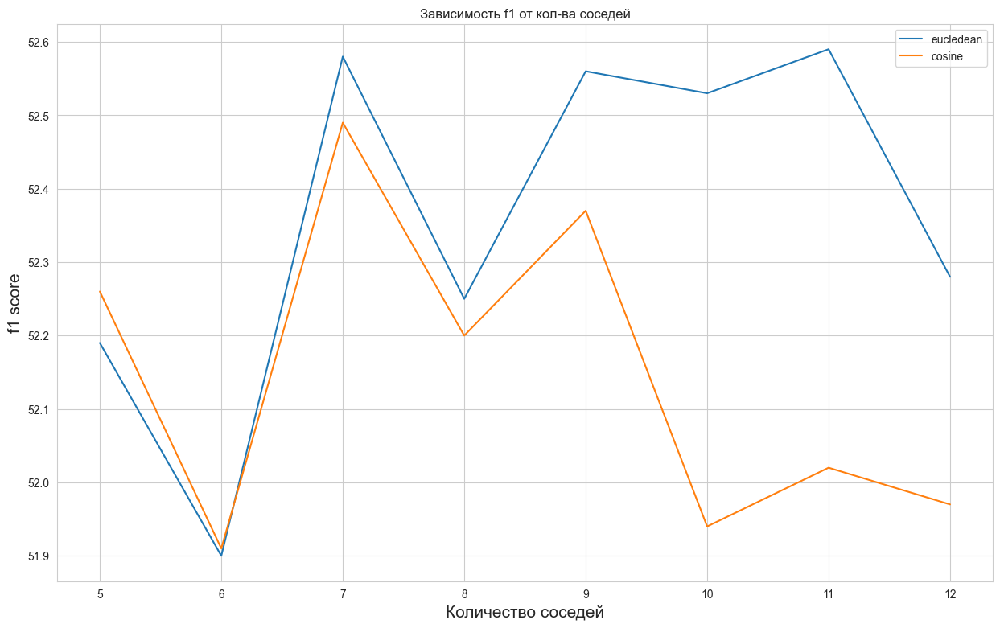

In [137]:
plt.figure(figsize=(15, 9))
plt.plot(knn_euq.keys(), knn_euq.values(), label="eucledean")
plt.plot(knn_cos.keys(), knn_cos.values(), label="cosine")
plt.xlabel("Количество соседей", fontsize=15)
plt.ylabel("f1 score", fontsize=15)
plt.title("Зависимость f1 от кол-ва соседей")
plt.legend()


In [138]:
# 200 features
pred_test = train_knn(X_train, X_test, y_train, y_test, knn, k_neighbors=7)
print(f'Accuracy: {round(accuracy_score(y_test, pred_test)*100, 2)}%')
print(f'Precision score: {round(precision_score(y_test, pred_test, average="macro")*100, 2)}%')
print(f'Recall score: {round(recall_score(y_test, pred_test, average="macro")*100, 2)}%')
print(f'f1 score: {round(f1_score(y_test, pred_test, average="macro")*100, 2)}%')
print(classification_report(y_test, pred_test))

Accuracy: 61.15%
Precision score: 55.88%
Recall score: 50.9%
f1 score: 52.58%
              precision    recall  f1-score   support

           0       0.66      0.80      0.72     22368
           1       0.57      0.52      0.54      8683
           2       0.50      0.33      0.40      7146
           3       0.50      0.39      0.44      6261

    accuracy                           0.61     44458
   macro avg       0.56      0.51      0.53     44458
weighted avg       0.60      0.61      0.60     44458



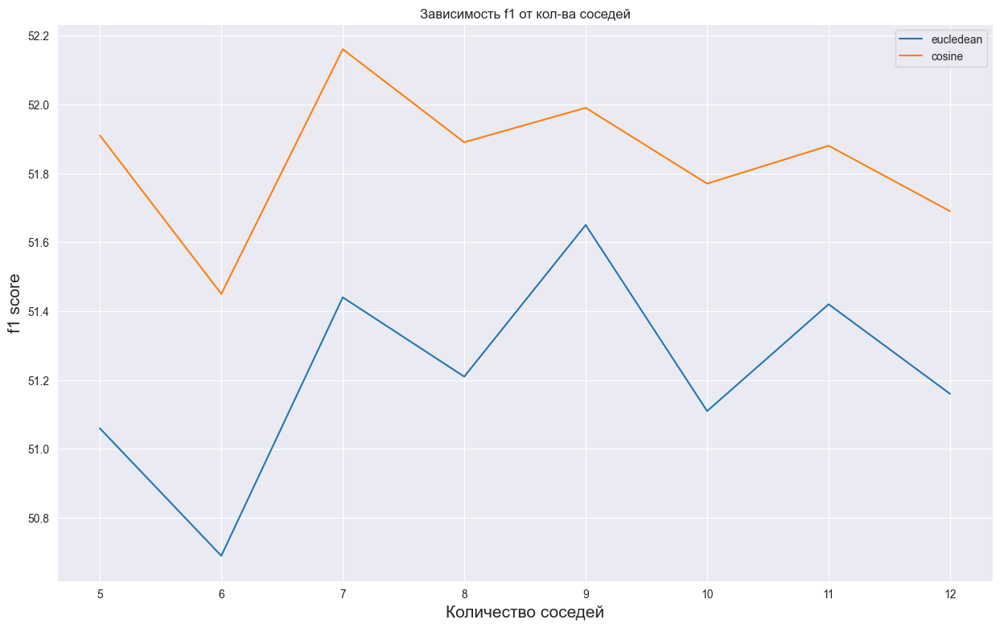

In [101]:
plt.figure(figsize=(15, 9))
plt.plot(knn_euq.keys(), knn_euq.values(), label="eucledean")
plt.plot(knn_cos.keys(), knn_cos.values(), label="cosine")
plt.xlabel("Количество соседей", fontsize=15)
plt.ylabel("f1 score", fontsize=15)
plt.title("Зависимость f1 от кол-ва соседей")
plt.legend()


In [102]:
pred_test = train_knn(X_train, X_test, y_train, y_test, knn, k_neighbors=9)
print(f'Accuracy: {round(accuracy_score(y_test, pred_test)*100, 2)}%')
print(f'Precision score: {round(precision_score(y_test, pred_test, average="macro")*100, 2)}%')
print(f'Recall score: {round(recall_score(y_test, pred_test, average="macro")*100, 2)}%')
print(f'f1 score: {round(f1_score(y_test, pred_test, average="macro")*100, 2)}%')
print(classification_report(y_test, pred_test))

Accuracy: 61.3%
Precision score: 56.99%
Recall score: 49.48%
f1 score: 51.65%
              precision    recall  f1-score   support

           0       0.65      0.83      0.73     22367
           1       0.58      0.51      0.54      8694
           2       0.53      0.32      0.40      7111
           3       0.53      0.32      0.40      6286

    accuracy                           0.61     44458
   macro avg       0.57      0.49      0.52     44458
weighted avg       0.60      0.61      0.59     44458



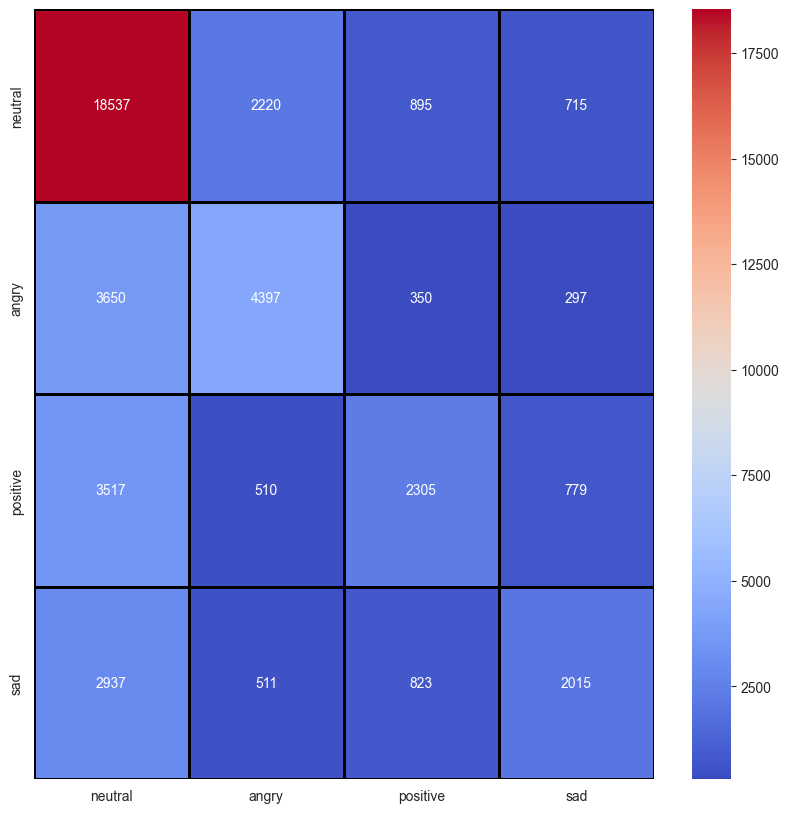

In [103]:
plt.figure(figsize=(10,10))
sns.heatmap(confusion_matrix(y_test, pred_test), annot=True, cmap='coolwarm', linewidths=2, linecolor='black',fmt=str(), xticklabels=train_features.label.unique(), yticklabels=train_features.label.unique())
plt.show()

In [104]:
tf = train_features.sample(n=30000)
print(tf.label.value_counts())


label
neutral     15009
sad          5870
positive     4864
angry        4257
Name: count, dtype: int64


In [105]:
X = tf[tf.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(tf[tf.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


In [106]:
dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [107]:
params_grid = [{'weights': ['distance', 'uniform'], 'metric': ['cosine'], 'leaf_size': [20, 30, 15]}]
knn_model = GridSearchCV(KNeighborsClassifier(), params_grid, cv=5, verbose=2, n_jobs=-1)
knn_model.fit(X_train, y_train)


Fitting 5 folds for each of 6 candidates, totalling 30 fits


GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid=[{'leaf_size': [20, 30, 15], 'metric': ['cosine'],
                          'weights': ['distance', 'uniform']}],
             verbose=2)

In [108]:
final_model = knn_model.best_estimator_
y_pred = final_model.predict(X_test)


In [109]:
print(confusion_matrix(y_test, y_pred))
print("\n")
print(classification_report(y_test, y_pred))

print("Training set score for SVM: %f" % final_model.score(X_train, y_train))
print("Testing  set score for SVM: %f" % final_model.score(X_test, y_test))

knn_model.score

[[3320  492  239  125]
 [ 740  726   90   73]
 [ 699  134  424  103]
 [ 640  163  220  212]]


              precision    recall  f1-score   support

           0       0.61      0.80      0.69      4176
           1       0.48      0.45      0.46      1629
           2       0.44      0.31      0.36      1360
           3       0.41      0.17      0.24      1235

    accuracy                           0.56      8400
   macro avg       0.49      0.43      0.44      8400
weighted avg       0.53      0.56      0.53      8400

Training set score for SVM: 0.688426
Testing  set score for SVM: 0.557381


<bound method BaseSearchCV.score of GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid=[{'leaf_size': [20, 30, 15], 'metric': ['cosine'],
                          'weights': ['distance', 'uniform']}],
             verbose=2)>

In [110]:
print(f'Accuracy: {round(accuracy_score(y_test, y_pred)*100, 2)}%')
print(f'Precision score: {round(precision_score(y_test, y_pred, average="macro")*100, 2)}%')
print(f'Recall score: {round(recall_score(y_test, y_pred, average="macro")*100, 2)}%')
print(f'f1 score: {round(f1_score(y_test, y_pred, average="macro")*100, 2)}%')

Accuracy: 55.74%
Precision score: 48.58%
Recall score: 43.1%
f1 score: 44.03%


### KNN balanced

In [160]:
train_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,ea0f98b720247329cb817138c2f628dd.wav,-416.31076,92.022140,8.281179,16.198270,-0.936501,-1.026557,-0.820926,-10.904892,-4.460922,-9.831796,2.414729,-9.357346,-1.262992,-2.283333,-9.902399,0.617525,-6.295304,-1.237704,-0.746776,-5.747520,-0.963644,-1.022405,1.043999,6.829342,4.699425,9.967783,3.387162,6.466811,-1.055453,0.961022,-1.544693,2.375060,-2.158074,-0.052250,-0.717584,0.300643,-1.809443,-0.733228,-5.115393,-1.985247,-3.218359,-3.301126,-3.615870,-2.785368,-2.766621,-1.762610,-2.162419,-1.302676,-1.276341,-0.534420,-1.664901,-0.286600,-2.083095,0.823001,-3.301691,0.290000,-0.978156,-0.069865,-0.970305,-0.211424,0.236216,0.074348,-0.227397,0.778327,-1.166701,-0.664969,-0.281549,0.237870,-0.649346,0.131668,-1.932842,-1.451750,-2.126951,-1.164420,-2.618154,-0.827134,-2.029711,-0.592424,-1.193040,-0.050078,-0.675225,-0.092497,-1.082167,-0.458054,-1.249633,-0.642827,-1.244604,-0.611514,-1.452568,-0.343360,-0.852291,0.319510,-1.267048,-1.226245,-1.681598,-0.954266,-1.668372,-1.499528,-1.723242,-1.148087,105.970600,33.132618,28.013847,23.422653,21.569332,16.596191,11.430403,12.314257,10.125980,8.662791,6.904030,10.394081,6.286224,5.080739,6.273829,6.459737,9.223018,10.254317,6.558453,9.613936,8.224324,6.965076,7.323610,9.409914,13.180948,14.475088,12.208991,11.060138,11.134114,9.059981,9.837153,8.885558,7.699648,8.533421,6.020751,4.279263,4.790843,4.780743,5.203868,4.606727,4.539925,5.174113,4.002665,5.437748,4.714987,5.700115,6.059845,6.026706,4.900537,4.996851,4.482159,5.971661,5.712463,6.629459,5.071481,4.644053,4.241181,3.511219,3.303602,3.570986,3.948244,4.804130,3.557213,4.239606,4

In [161]:
train_features_dr = train_features[train_features['label'] == 'neutral'].sample(40000, random_state=123).index

# Удаление выбранных строк из датафрейма
train_features_balanced = train_features.drop(train_features_dr)

train_features_balanced

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,ea0f98b720247329cb817138c2f628dd.wav,-416.31076,92.022140,8.281179,16.198270,-0.936501,-1.026557,-0.820926,-10.904892,-4.460922,-9.831796,2.414729,-9.357346,-1.262992,-2.283333,-9.902399,0.617525,-6.295304,-1.237704,-0.746776,-5.747520,-0.963644,-1.022405,1.043999,6.829342,4.699425,9.967783,3.387162,6.466811,-1.055453,0.961022,-1.544693,2.375060,-2.158074,-0.052250,-0.717584,0.300643,-1.809443,-0.733228,-5.115393,-1.985247,-3.218359,-3.301126,-3.615870,-2.785368,-2.766621,-1.762610,-2.162419,-1.302676,-1.276341,-0.534420,-1.664901,-0.286600,-2.083095,0.823001,-3.301691,0.290000,-0.978156,-0.069865,-0.970305,-0.211424,0.236216,0.074348,-0.227397,0.778327,-1.166701,-0.664969,-0.281549,0.237870,-0.649346,0.131668,-1.932842,-1.451750,-2.126951,-1.164420,-2.618154,-0.827134,-2.029711,-0.592424,-1.193040,-0.050078,-0.675225,-0.092497,-1.082167,-0.458054,-1.249633,-0.642827,-1.244604,-0.611514,-1.452568,-0.343360,-0.852291,0.319510,-1.267048,-1.226245,-1.681598,-0.954266,-1.668372,-1.499528,-1.723242,-1.148087,105.970600,33.132618,28.013847,23.422653,21.569332,16.596191,11.430403,12.314257,10.125980,8.662791,6.904030,10.394081,6.286224,5.080739,6.273829,6.459737,9.223018,10.254317,6.558453,9.613936,8.224324,6.965076,7.323610,9.409914,13.180948,14.475088,12.208991,11.060138,11.134114,9.059981,9.837153,8.885558,7.699648,8.533421,6.020751,4.279263,4.790843,4.780743,5.203868,4.606727,4.539925,5.174113,4.002665,5.437748,4.714987,5.700115,6.059845,6.026706,4.900537,4.996851,4.482159,5.971661,5.712463,6.629459,5.071481,4.644053,4.241181,3.511219,3.303602,3.570986,3.948244,4.804130,3.557213,4.239606,4

In [162]:
print(train_features_balanced.label.value_counts())

label
neutral     40011
sad         30890
positive    25310
angry       22567
Name: count, dtype: int64


In [163]:
X = train_features_balanced[train_features_balanced.columns.drop(['label', 'audio_path'])]
y = pd.DataFrame(train_features_balanced[train_features_balanced.columns[-1]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)
dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=512, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=512, shuffle=True)

In [164]:
knn_euq = {}
knn_cos = {}
for s in range(5,17):
    pred_test = train_knn(X_train, X_test, y_train, y_test, knn, k_neighbors=s)
    knn_euq[s]= round(f1_score(y_test, pred_test, average="macro")*100, 2)
    pred_test = train_knn(X_train, X_test, y_train, y_test, knn_cosine, k_neighbors=s)
    knn_cos[s]= round(f1_score(y_test, pred_test, average="macro")*100, 2)


KeyboardInterrupt: 

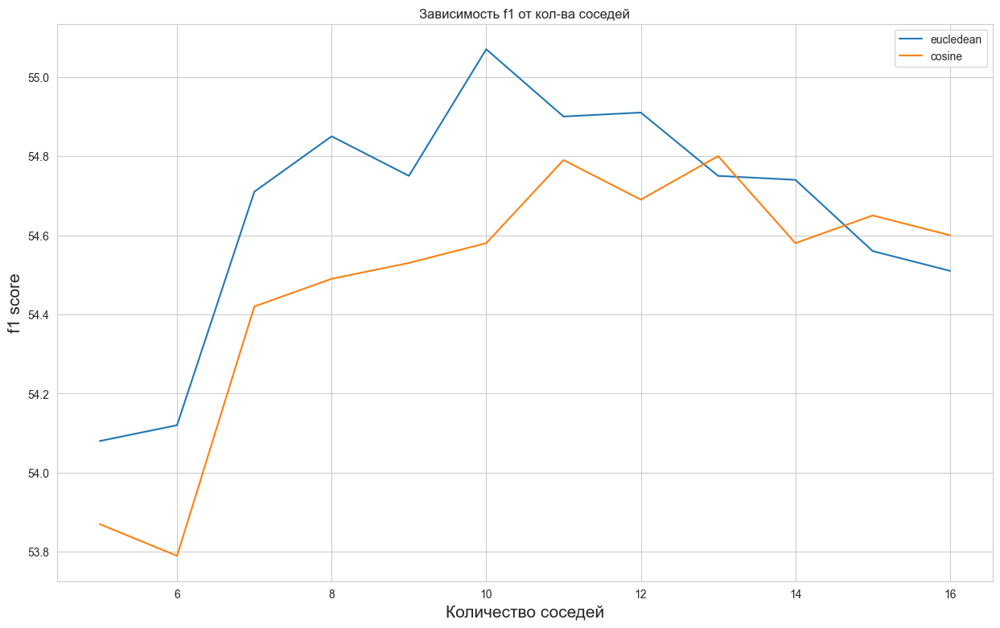

In [145]:
plt.figure(figsize=(15, 9))
plt.plot(knn_euq.keys(), knn_euq.values(), label="eucledean")
plt.plot(knn_cos.keys(), knn_cos.values(), label="cosine")
plt.xlabel("Количество соседей", fontsize=15)
plt.ylabel("f1 score", fontsize=15)
plt.title("Зависимость f1 от кол-ва соседей")
plt.legend()


In [166]:
# 200 features balanced
pred_test = train_knn(X_train, xxx_test, y_train, yyy_test, knn, k_neighbors=10)
print(f'Accuracy: {round(accuracy_score(yyy_test, pred_test)*100, 2)}%')
print(f'Precision score: {round(precision_score(yyy_test, pred_test, average="macro")*100, 2)}%')
print(f'Recall score: {round(recall_score(yyy_test, pred_test, average="macro")*100, 2)}%')
print(f'f1 score: {round(f1_score(yyy_test, pred_test, average="macro")*100, 2)}%')
print(classification_report(yyy_test, pred_test))

Accuracy: 51.05%
Precision score: 36.19%
Recall score: 42.29%
f1 score: 36.48%
              precision    recall  f1-score   support

           0       0.83      0.55      0.67     20839
           1       0.23      0.50      0.31      3271
           2       0.22      0.33      0.27      2473
           3       0.17      0.30      0.21      2161

    accuracy                           0.51     28744
   macro avg       0.36      0.42      0.36     28744
weighted avg       0.66      0.51      0.56     28744



In [147]:
test_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label,annotator_emo
0,9749f1633078b5e2dfffbf0d3594a810.wav,-263.48947,24.691292,5.046207,40.881653,13.771988,2.588992,-6.458071,6.427881,-2.167178,1.888746,-1.982004,-1.821997,-2.505400,2.449892,-4.737488,0.310758,-3.280888,-3.438982,-3.656493,-3.117498,-9.407578,1.439913,-5.580868,-1.214528,-5.753360,-0.986313,-3.386677,-1.968669,-2.335007,-2.491683,-4.789035,-1.228644,-4.103913,-3.260050,-4.269200,0.322288,-5.199934,-0.442057,-3.665476,0.413360,-3.338922,2.208741,-4.017583,1.093609,-2.216406,-0.124101,-2.649338,-0.209669,-3.017686,0.305745,-0.453938,1.371611,-0.818935,0.824161,-1.344830,0.668284,-0.107337,1.218946,0.184024,0.872678,-1.521105,-0.872496,-1.031389,0.259662,-1.636941,0.864780,-1.081761,0.596354,-0.895725,0.882397,-1.539437,0.570749,-0.379806,0.761139,-0.430848,0.203114,-0.874437,0.448962,-0.358795,0.871175,0.008768,0.911911,-0.080045,0.454083,-0.396530,-0.167909,0.297913,0.443734,0.007142,0.556798,-0.652183,-0.047684,-0.387926,-0.040735,-0.744811,0.458432,0.027283,-0.044280,-0.069884,0.613037,104.117400,64.428810,29.115345,28.914220,15.314258,17.151758,14.647101,10.271374,9.573085,10.750772,10.373342,8.458012,11.089168,9.835657,9.343432,9.410328,8.676823,10.004842,6.067459,10.542748,6.830388,6.112651,7.445107,5.416725,6.706601,5.821807,5.999682,4.943574,4.454740,4.199143,4.813231,5.023889,4.451060,4.480929,4.337490,4.756557,4.908280,4.977970,4.651133,3.949246,4.134178,3.664961,4.940806,4.147945,3.489202,3.826931,3.260722,3.444142,3.175347,3.515870,4.293780,5.221432,4.297638,4.061341,3.851382,3.752522,3.225541,3.896883,3.025312,2.868844,3.034440,3.516555,3.039132,2.479999,2.694974

In [157]:
X = test_features[test_features.columns.drop(['label', 'audio_path', 'annotator_emo'])]
y = pd.DataFrame(test_features[test_features.columns[-1]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.99, random_state=123)
y_train.dropna(inplace=True)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=512, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=512, shuffle=True)

In [159]:
xxx_test = X_test
yyy_test = y_test

In [156]:
pred_test = train_knn(X_train, X_test, y_train, y_test, knn, k_neighbors=10)

RuntimeError: bincount only supports 1-d non-negative integral inputs.

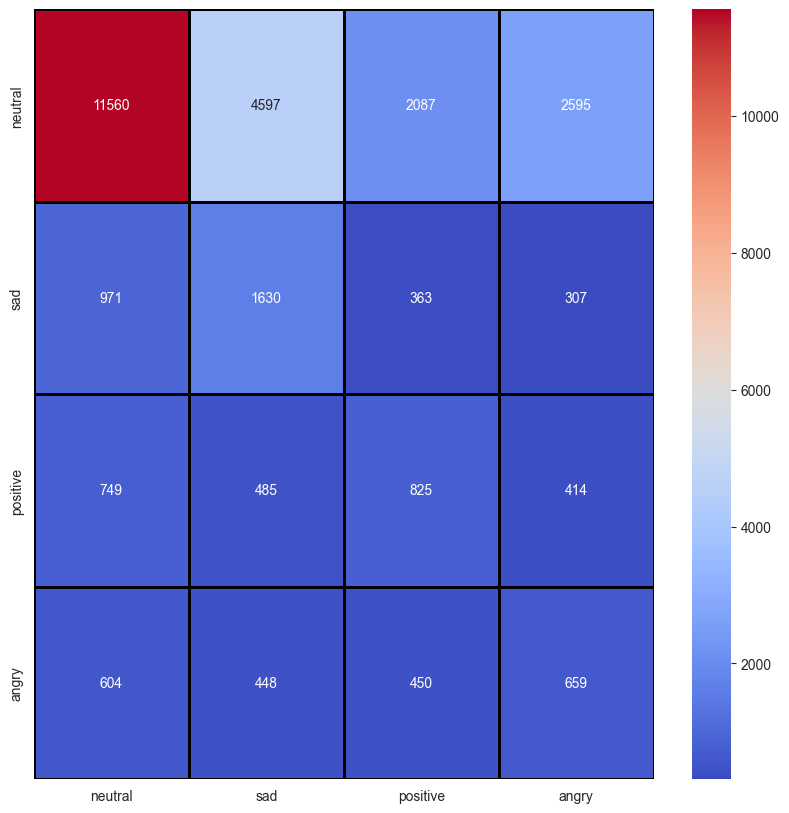

In [168]:
plt.figure(figsize=(10,10))
sns.heatmap(confusion_matrix(yyy_test, pred_test), annot=True, cmap='coolwarm', linewidths=2, linecolor='black',fmt=str(), xticklabels={'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3}, yticklabels={'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3})
plt.show()

## Catboost

In [6]:
train_features_crowd = pd.read_csv('dataset_crowd_cycle_200.csv')
train_features_podcast = pd.read_csv('dataset_podcast_cycle_200.csv')
train_features = pd.concat([train_features_crowd, train_features_podcast])
train_features = train_features.reset_index()
train_features.drop(columns=['index'], inplace=True)
train_features['label'] = train_features['label'].apply(lambda x: x.split()[1])
train_features.dropna(inplace=True)
train_features = train_features[train_features['label'] != 'other']
train_features_neutral = train_features[train_features['label']=='neutral']


,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,ea0f98b720247329cb817138c2f628dd.wav,-416.31076,92.022140,8.281179,16.198270,-0.936501,-1.026557,-0.820926,-10.904892,-4.460922,-9.831796,2.414729,-9.357346,-1.262992,-2.283333,-9.902399,0.617525,-6.295304,-1.237704,-0.746776,-5.747520,-0.963644,-1.022405,1.043999,6.829342,4.699425,9.967783,3.387162,6.466811,-1.055453,0.961022,-1.544693,2.375060,-2.158074,-0.052250,-0.717584,0.300643,-1.809443,-0.733228,-5.115393,-1.985247,-3.218359,-3.301126,-3.615870,-2.785368,-2.766621,-1.762610,-2.162419,-1.302676,-1.276341,-0.534420,-1.664901,-0.286600,-2.083095,0.823001,-3.301691,0.290000,-0.978156,-0.069865,-0.970305,-0.211424,0.236216,0.074348,-0.227397,0.778327,-1.166701,-0.664969,-0.281549,0.237870,-0.649346,0.131668,-1.932842,-1.451750,-2.126951,-1.164420,-2.618154,-0.827134,-2.029711,-0.592424,-1.193040,-0.050078,-0.675225,-0.092497,-1.082167,-0.458054,-1.249633,-0.642827,-1.244604,-0.611514,-1.452568,-0.343360,-0.852291,0.319510,-1.267048,-1.226245,-1.681598,-0.954266,-1.668372,-1.499528,-1.723242,-1.148087,105.970600,33.132618,28.013847,23.422653,21.569332,16.596191,11.430403,12.314257,10.125980,8.662791,6.904030,10.394081,6.286224,5.080739,6.273829,6.459737,9.223018,10.254317,6.558453,9.613936,8.224324,6.965076,7.323610,9.409914,13.180948,14.475088,12.208991,11.060138,11.134114,9.059981,9.837153,8.885558,7.699648,8.533421,6.020751,4.279263,4.790843,4.780743,5.203868,4.606727,4.539925,5.174113,4.002665,5.437748,4.714987,5.700115,6.059845,6.026706,4.900537,4.996851,4.482159,5.971661,5.712463,6.629459,5.071481,4.644053,4.241181,3.511219,3.303602,3.570986,3.948244,4.804130,3.557213,4.239606,4

In [7]:
train_features_emo = train_features[train_features['label'] !='neutral']

In [11]:
train_features_neutral = train_features_neutral.sample(40000)

In [13]:
train_features = pd.concat([train_features_emo, train_features_neutral])
train_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
46188,475e76f77ac1ed7cabafca740b15b32a.wav,-253.68443,60.475110,-28.873888,16.524050,-20.765106,-17.885672,-29.768020,-17.744286,-11.351636,-18.584826,-20.042679,-13.020010,-6.564040,-13.522069,-13.528390,-6.674361,-10.251400,-3.984183,-4.587704,-4.619501,12.797093,7.997570,10.120442,14.406537,4.847942,4.475129,-0.150637,-0.401958,-0.801206,-1.911472,-6.419913,-3.877614,-1.461439,-2.113473,-4.660919,-4.502008,-2.629269,-1.400870,-7.444517,-4.055376,-1.648567,-1.742447,-3.441486,-0.487182,-0.631439,0.769761,-2.370185,-1.552329,-1.752249,-0.786750,-1.346849,1.172150,-0.191780,-0.683613,-1.472255,-0.107752,-1.112759,-1.699588,-1.667589,-1.578278,-1.387967,-0.070755,-0.509254,-1.412331,-0.810809,0.242124,-0.276053,0.779466,0.150499,0.348977,-0.464135,-1.048735,-0.959330,0.053473,0.179119,-0.367514,-0.594256,-0.481933,-0.588107,-0.570814,-0.733795,-1.174155,-0.784019,-0.712743,0.277761,-0.272890,-0.357910,0.215589,-0.451829,-0.027665,-0.480899,-0.216809,-0.640886,-1.041211,-1.188465,-0.832396,-0.489017,0.548138,-0.115753,-0.313174,130.768160,30.133427,42.464474,16.815718,19.943760,13.859777,12.696023,13.285239,19.268076,13.299327,9.277514,8.955635,7.001075,9.447845,9.132270,11.201258,15.993741,11.996120,17.301739,16.930162,17.941704,16.720870,17.442827,18.377913,16.931110,18.052155,12.992261,11.390282,8.754832,8.611766,9.637526,8.758805,6.364077,8.085725,8.188395,7.631918,7.099803,8.071638,7.732067,7.433372,5.440440,4.654513,5.634691,7.984847,7.094686,7.740375,6.080015,5.875193,4.238567,3.858648,4.932382,4.870912,6.228556,4.520007,4.402314,3.508387,4.182436,3.151570,2.762476,3.331783,3.371631,

In [14]:
print(train_features.label.value_counts())

label
neutral     40000
sad         30890
positive    25310
angry       22567
Name: count, dtype: int64


In [16]:
tf = train_features.sample(n=100000)
print(tf.label.value_counts())

X = tf[tf.columns.drop(['label', 'audio_path'])]
y = pd.DataFrame(tf[tf.columns[-1]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, stratify=tf['label'], random_state=123)




label
neutral     33616
sad         26015
positive    21388
angry       18981
Name: count, dtype: int64


In [18]:
dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [113]:
from sklearn.model_selection import StratifiedKFold

# Define the search space
param_grid = {"iterations":[400, 450, 350],
              'grow_policy': ['Lossguide'],
              'bootstrap_type': ['Poisson','Bernoulli','MVS','Poisson'],
              'sampling_frequency': ['PerTree','PerTreeLevel'],
              'min_data_in_leaf': [4, 3, 5],
              'subsample': [0.15, 0.1, 0.05],
              'leaf_estimation_method': ['Gradient', 'Newton', 'Exact'],
              "learning_rate": [0.01, 0.1],
              "depth": range(3, 9),
              'random_strength': [0.5, 1, 1.5],
              "reg_lambda": [1, 0.1, 0.5],
              'auto_class_weights': ['Balanced']}
# Set up the k-fold cross-validation
kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=123)

In [114]:
ct= catboost.CatBoostClassifier(task_type="GPU",loss_function='MultiClass', eval_metric='MultiClass')
# 'loss_function':['MultiClass','MultiClassOneVsAll','TotalF1' MultiLogloss MultiCrossEntropy]
# eval'MultiClass', 'TotalF1', 'MultiCrossEntropy', 'MultiLogloss' ?
random_search = ct.randomized_search(param_distributions=param_grid,
                                     X=X_train,
                                     y=y_train,
                                     cv=kfold,
                                     n_iter=2500,
                                     verbose=1,
                                     plot=True)

print("best params:\n", random_search['params'])

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.3862843	test: 1.3862953	best: 1.3862953 (0)	total: 87.1ms	remaining: 34.7s
1:	learn: 1.3862742	test: 1.3862966	best: 1.3862953 (0)	total: 90.1ms	remaining: 17.9s
2:	learn: 1.3862645	test: 1.3862976	best: 1.3862953 (0)	total: 92.1ms	remaining: 12.2s
3:	learn: 1.3862549	test: 1.3862987	best: 1.3862953 (0)	total: 94.2ms	remaining: 9.33s
4:	learn: 1.3862455	test: 1.3863004	best: 1.3862953 (0)	total: 96.5ms	remaining: 7.62s
5:	learn: 1.3862360	test: 1.3863016	best: 1.3862953 (0)	total: 98.8ms	remaining: 6.49s
6:	learn: 1.3862275	test: 1.3863034	best: 1.3862953 (0)	total: 101ms	remaining: 5.66s
7:	learn: 1.3862187	test: 1.3863050	best: 1.3862953 (0)	total: 103ms	remaining: 5.05s
8:	learn: 1.3862103	test: 1.3863065	best: 1.3862953 (0)	total: 106ms	remaining: 4.58s
9:	learn: 1.3862016	test: 1.3863085	best: 1.3862953 (0)	total: 107ms	remaining: 4.19s
10:	learn: 1.3861929	test: 1.3863103	best: 1.3862953 (0)	total: 110ms	remaining: 3.88s
11:	learn: 1.3861850	test: 1.3863121	best: 1.38

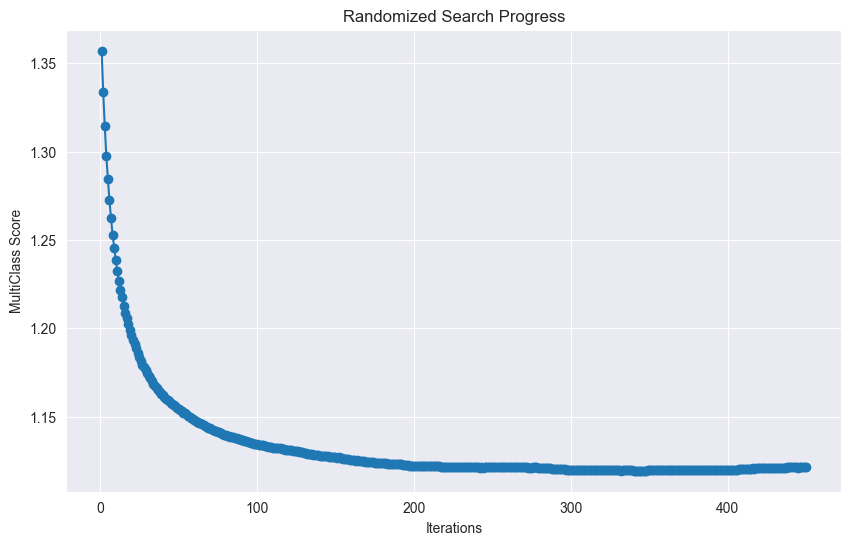

In [115]:
results = random_search['cv_results']
iterations = list(range(1, len(results['test-MultiClass-mean']) + 1))
scores = results['test-MultiClass-mean']

# Построить график
plt.figure(figsize=(10, 6))
plt.plot(iterations, scores, marker='o')
plt.xlabel('Iterations')
plt.ylabel('MultiClass Score')
plt.title('Randomized Search Progress')
plt.grid(True)
plt.show()

In [19]:
X = train_features[train_features.columns.drop(['label', 'audio_path'])]
y = pd.DataFrame(train_features[train_features.columns[-1]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()


In [74]:
best_params = {'min_data_in_leaf': 9, 'depth': 15, 'l2_leaf_reg': 3, 'iterations': 15000, 'subsample': 0.5, 'random_strength': 0.7, 'learning_rate': 0.01, 'grow_policy': 'Lossguide', 'sampling_frequency': 'PerTree', 'auto_class_weights': 'Balanced', 'leaf_estimation_method': 'Newton', 'bootstrap_type': 'Bernoulli'}

best_model = catboost.CatBoostClassifier(task_type="GPU", loss_function='MultiClass', eval_metric='MultiClass', **best_params)

best_model.fit(X_train, y_train)

# Предсказание на тестовом наборе данных
y_pred = best_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Точность модели: {:.2f}".format(accuracy))
print("\n")
print(classification_report(y_test, y_pred))

0:	learn: 1.3834280	total: 12.1ms	remaining: 3m
1:	learn: 1.3806250	total: 22.9ms	remaining: 2m 51s
2:	learn: 1.3778746	total: 33.9ms	remaining: 2m 49s
3:	learn: 1.3751501	total: 44.2ms	remaining: 2m 45s
4:	learn: 1.3724939	total: 53.5ms	remaining: 2m 40s
5:	learn: 1.3699329	total: 62.4ms	remaining: 2m 35s
6:	learn: 1.3673772	total: 71.2ms	remaining: 2m 32s
7:	learn: 1.3649027	total: 79.8ms	remaining: 2m 29s
8:	learn: 1.3624146	total: 88.1ms	remaining: 2m 26s
9:	learn: 1.3600145	total: 96.7ms	remaining: 2m 24s
10:	learn: 1.3576578	total: 105ms	remaining: 2m 23s
11:	learn: 1.3552957	total: 115ms	remaining: 2m 23s
12:	learn: 1.3530309	total: 123ms	remaining: 2m 22s
13:	learn: 1.3508096	total: 132ms	remaining: 2m 21s
14:	learn: 1.3486209	total: 142ms	remaining: 2m 21s
15:	learn: 1.3464556	total: 152ms	remaining: 2m 21s
16:	learn: 1.3443653	total: 160ms	remaining: 2m 21s
17:	learn: 1.3423008	total: 169ms	remaining: 2m 20s
18:	learn: 1.3402455	total: 177ms	remaining: 2m 19s
19:	learn: 1.338

In [76]:

best_model.fit(X_train, y_train, eval_set=(X_test, y_test), verbose=False)

# Извлечение результатов оценки
train_error = best_model.get_evals_result()['learn']['MultiClass']
test_error = best_model.get_evals_result()['validation_0']['MultiClass']

# Построение графика обучения
plt.figure(figsize=(10, 6))
plt.plot(train_error, label='Train')
plt.plot(test_error, label='Test')
plt.xlabel('Iterations')
plt.ylabel('Error')
plt.title('Training Error')
plt.legend()
plt.show()

KeyError: 'validation_0'

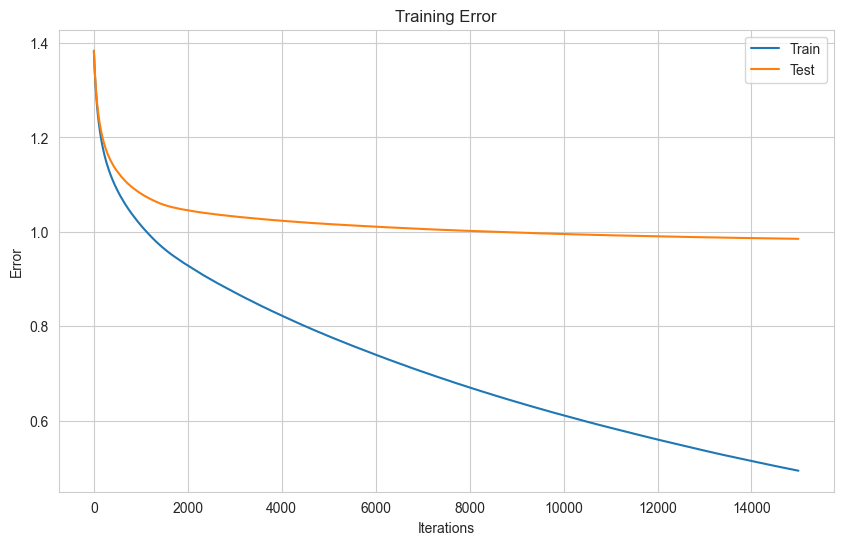

In [77]:
eval_keys = list(best_model.get_evals_result().keys())

# Найдите правильный ключ для вашего тестового набора
test_key = [key for key in eval_keys if 'validation' in key][0]

# Извлечение результатов оценки для тестового набора
test_error = best_model.get_evals_result()[test_key]['MultiClass']

# Построение графика обучения
plt.figure(figsize=(10, 6))
plt.plot(train_error, label='Train')
plt.plot(test_error, label='Test')
plt.xlabel('Iterations')
plt.ylabel('Error')
plt.title('Training Error')
plt.legend()
plt.show()

In [31]:
pd.read_csv('major_test_dataset.csv')

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,9e9961c53ca6eeb440b217e539fbf46c,9e9961c53ca6eeb440b217e539fbf46c.wav,5.82,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,я слушаю,neutral,4282ddc30d71ef420e202e0c60391e9f,crowd
1,0166f65a30354db8282682b1a280e64c,0166f65a30354db8282682b1a280e64c.wav,3.70,1.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,каким стал сбер,neutral,d70dc98ed56e9362eaefefb7b2827c8f,crowd
2,d49a6b560155831725a7bdc7d0a96099,d49a6b560155831725a7bdc7d0a96099.wav,4.38,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,где родился шерлок холмс,neutral,0ee35d2abecf4272ecc8e1539b0839d8,crowd
3,c6852b0925797612d7b6724da8cbe7b4,c6852b0925797612d7b6724da8cbe7b4.wav,8.58,0.0,NaN,858305a5450b7bd1288ba0053b1cd1c1,открой в браузере ennio morricone,neutral,0855e363c1787df1592f58f7a27ebe13,crowd
4,64a7aa17132c3e4b7be1aaed5fc88090,64a7aa17132c3e4b7be1aaed5fc88090.wav,5.06,2.0,NaN,32bd471407fe168dacd5f8252f9949b7,а там и ева проснулись с утра,positive,82f97728c4767b283d249afc96d23caf,crowd
...,...,...,...,...,...,...,...,...,...,...
29029,0b5911175dd80e2d5b0f6ebe2281fcf1,0b5911175dd80e2d5b0f6ebe2281fcf1.wav,2.60,0.0,NaN,d7fe5fc7ecf7df35fc43859c99491cd6,NaN,NaN,0f9ed62245fdc1e36a3bf8c0f7270c41,podcast
29030,1227da4809819378be4f2aac7353c592,1227da4809819378be4f2aac7353c592.wav,1.30,0.0,NaN,013f1749c55055e16f8acf9817598b2d,NaN,NaN,742833af70986b8ff933b1cb75cb0987,podcast
29031,b7ac0b2d52191acfa44cbcc09d071de4,b7ac0b2d52191acfa44cbcc09d071de4.wav,3.10,0.0,NaN,9fccb985c2f1910e12a1b7386180aa59,NaN,NaN,6a2370e4e8cc496c4d59408bb2a9995a,podcast
29032,7e62e88117cc0cc20bba2c7902cee97d,7e62e88117cc0cc20bba2c7902cee97d.wav,2.10,0.0,NaN,d6b5eac94428cfad71114fbccbcf4dbc,NaN,NaN,d0c7db9d0bc8dd57be358f6bf13d3f90,podcast


In [78]:
test_podc = pd.read_csv('dataset_test_podcast_cycle_200.csv')
test_crow = pd.read_csv('dataset_test_crowd_cycle_200.csv')

In [93]:
test_features = pd.concat([test_podc, test_crow])
test_features = test_features.reset_index()
test_features.drop(columns=['index'], inplace=True)
test_features['label'] = test_features['label'].apply(lambda x: x.split()[1])
test_features.dropna(inplace=True)
test_features = test_features[test_features['label'] != 'other']


In [115]:
major_test[major_test['audio_path']=='2480c7c6d580e15b4aa917ef133d0b06.wav']

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
3444,2480c7c6d580e15b4aa917ef133d0b06,2480c7c6d580e15b4aa917ef133d0b06.wav,2.699875,2.0,NaN,851bd759a3b17a0ce3e8e1bf62fb8d0e,NaN,NaN,1d7c48b66e32f913df2fde4e6fa2676a,podcast


In [97]:
test_features = test_features.merge(major_test[['audio_path', 'annotator_emo']], on='audio_path', how='left')


In [114]:
print(test_features.loc[3444])

audio_path        2480c7c6d580e15b4aa917ef133d0b06.wav
mfcc_mean1                                  -232.63234
mfcc_mean2                                   130.58641
mfcc_mean3                                   -5.703413
mfcc_mean4                                   37.785423
                                  ...                 
rolloff_std                                  944.00056
zero_cross_mn                                 0.060785
zero_cross_std                                0.040829
label                                            Name:
annotator_emo                                      2.0
Name: 3444, Length: 210, dtype: object


In [102]:
X = test_features[test_features.columns.drop(['label', 'audio_path', 'label'])]
y = pd.DataFrame(test_features[test_features.columns[-1]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.99, random_state=123)


'''dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)'''
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()


In [105]:
y_pred = best_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Точность модели: {:.2f}".format(accuracy))
print("\n")
print(classification_report(y_test, y_pred))

Точность модели: 0.49


              precision    recall  f1-score   support

         0.0       0.90      0.46      0.61     20839
         1.0       0.28      0.68      0.40      3271
         2.0       0.25      0.50      0.34      2473
         3.0       0.23      0.56      0.33      2161

    accuracy                           0.49     28744
   macro avg       0.42      0.55      0.42     28744
weighted avg       0.72      0.49      0.54     28744



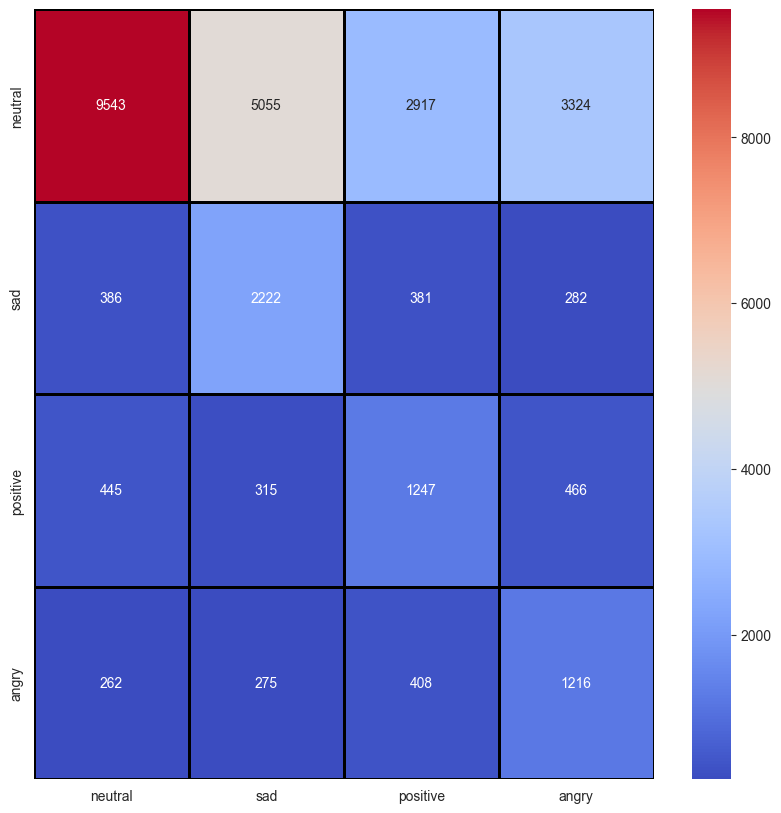

In [120]:
plt.figure(figsize=(10,10))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, cmap='coolwarm', linewidths=2, linecolor='black',fmt=str(), xticklabels={'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3}, yticklabels={'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3})
plt.show()

In [170]:
print(test_features.annotator_emo.value_counts())

annotator_emo
0.0    21043
1.0     3297
2.0     2503
3.0     2191
Name: count, dtype: int64


In [171]:
pd.read_csv('dataset_test_crowd_cycle_200.csv')

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,9e9961c53ca6eeb440b217e539fbf46c.wav,-545.70270,51.056060,27.216883,12.145612,10.194886,15.474760,6.492830,3.450592,0.820008,-0.937856,-2.819215,0.181226,0.019525,1.083165,-2.866161,-2.865540,2.240617,-3.826566,-5.193896,-1.041131,0.016556,-2.959668,-2.166975,-0.166132,-4.819757,0.919001,-3.877790,-0.118375,-2.531888,1.253588,0.419285,0.599615,-2.168774,1.276785,-2.926563,-0.404303,-1.813945,-0.468795,-1.948603,-0.310554,-4.676249,-0.381807,-3.519036,-0.583076,-3.786471,-0.012491,-1.917313,-1.558825,-3.038565,-0.229713,-3.264936,-0.563283,-1.771541,-1.061832,-2.317209,-1.003310,-2.076314,-0.055006,-1.607609,-1.656900,-1.950485,-0.155263,-0.856798,0.857437,-1.732035,-1.075995,-1.785594,0.017619,-1.487531,-0.260636,-1.926369,-0.352212,-1.491447,-0.806296,-2.240474,-1.277959,-2.082416,-0.688659,-1.728290,-0.236983,-0.605199,0.111202,-0.880527,0.636787,-0.459991,0.462042,-0.216134,0.696455,0.157408,1.144252,0.244569,1.198962,0.051727,1.834558,0.555458,0.760248,-0.501878,0.006653,0.045340,0.609428,77.033540,28.172934,13.440990,17.551485,9.465514,9.256212,9.991407,9.122308,8.250088,7.817865,8.561604,5.458817,7.859258,6.317846,6.139263,5.203279,6.664603,5.916555,6.611006,5.904414,4.419327,5.543364,5.093056,4.727286,4.459492,4.256617,5.092022,4.796088,5.477122,6.816209,8.289555,9.527467,6.403502,5.330311,4.996393,4.512577,3.292970,3.741748,3.680133,3.225398,3.274878,3.598531,3.240842,2.980377,2.966941,4.119382,3.451920,3.001164,3.569692,3.137529,3.219429,2.920950,3.125623,3.598267,3.011055,3.239844,3.364580,3.790381,2.996075,2.904614,3.372414,3.557441,4.426767,3.691955,3.177957,2.387451,2.42866

In [172]:
pd.read_csv('dataset_test_podcast_cycle_200.csv')

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_mean21,mfcc_mean22,mfcc_mean23,mfcc_mean24,mfcc_mean25,mfcc_mean26,mfcc_mean27,mfcc_mean28,mfcc_mean29,mfcc_mean30,mfcc_mean31,mfcc_mean32,mfcc_mean33,mfcc_mean34,mfcc_mean35,mfcc_mean36,mfcc_mean37,mfcc_mean38,mfcc_mean39,mfcc_mean40,mfcc_mean41,mfcc_mean42,mfcc_mean43,mfcc_mean44,mfcc_mean45,mfcc_mean46,mfcc_mean47,mfcc_mean48,mfcc_mean49,mfcc_mean50,mfcc_mean51,mfcc_mean52,mfcc_mean53,mfcc_mean54,mfcc_mean55,mfcc_mean56,mfcc_mean57,mfcc_mean58,mfcc_mean59,mfcc_mean60,mfcc_mean61,mfcc_mean62,mfcc_mean63,mfcc_mean64,mfcc_mean65,mfcc_mean66,mfcc_mean67,mfcc_mean68,mfcc_mean69,mfcc_mean70,mfcc_mean71,mfcc_mean72,mfcc_mean73,mfcc_mean74,mfcc_mean75,mfcc_mean76,mfcc_mean77,mfcc_mean78,mfcc_mean79,mfcc_mean80,mfcc_mean81,mfcc_mean82,mfcc_mean83,mfcc_mean84,mfcc_mean85,mfcc_mean86,mfcc_mean87,mfcc_mean88,mfcc_mean89,mfcc_mean90,mfcc_mean91,mfcc_mean92,mfcc_mean93,mfcc_mean94,mfcc_mean95,mfcc_mean96,mfcc_mean97,mfcc_mean98,mfcc_mean99,mfcc_mean100,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,mfcc_std21,mfcc_std22,mfcc_std23,mfcc_std24,mfcc_std25,mfcc_std26,mfcc_std27,mfcc_std28,mfcc_std29,mfcc_std30,mfcc_std31,mfcc_std32,mfcc_std33,mfcc_std34,mfcc_std35,mfcc_std36,mfcc_std37,mfcc_std38,mfcc_std39,mfcc_std40,mfcc_std41,mfcc_std42,mfcc_std43,mfcc_std44,mfcc_std45,mfcc_std46,mfcc_std47,mfcc_std48,mfcc_std49,mfcc_std50,mfcc_std51,mfcc_std52,mfcc_std53,mfcc_std54,mfcc_std55,mfcc_std56,mfcc_std57,mfcc_std58,mfcc_std59,mfcc_std60,mfcc_std61,mfcc_std62,mfcc_std63,mfcc_std64,mfcc_std65,mfcc_std66,mfcc_std67,mfcc_std68,mfcc_std69,mfcc_std70,mfcc_std71,mfcc_std72,mfcc_std73,mfcc_std74,mfcc_std75,mfcc_std76,mfcc_std77,mfcc_std78,mfcc_std79,mfcc_std80,mfcc_std81,mfcc_std82,mfcc_std83,mfcc_std84,mfcc_std85,mfcc_std86,mfcc_std87,mfcc_std88,mfcc_std89,mfcc_std90,mfcc_std91,mfcc_std92,mfcc_std93,mfcc_std94,mfcc_std95,mfcc_std96,mfcc_std97,mfcc_std98,mfcc_std99,mfcc_std100,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,zero_cross_mn,zero_cross_std,label
0,9749f1633078b5e2dfffbf0d3594a810.wav,-263.489470,24.691292,5.046207,40.881653,13.771988,2.588992,-6.458071,6.427881,-2.167178,1.888746,-1.982004,-1.821997,-2.505400,2.449892,-4.737488,0.310758,-3.280888,-3.438982,-3.656493,-3.117498,-9.407578,1.439913,-5.580868,-1.214528,-5.753360,-0.986313,-3.386677,-1.968669,-2.335007,-2.491683,-4.789035,-1.228644,-4.103913,-3.260050,-4.269200,0.322288,-5.199934,-0.442057,-3.665476,0.413360,-3.338922,2.208741,-4.017583,1.093609,-2.216406,-0.124101,-2.649338,-0.209669,-3.017686,0.305745,-0.453938,1.371611,-0.818935,0.824161,-1.344830,0.668284,-0.107337,1.218946,0.184024,0.872678,-1.521105,-0.872496,-1.031389,0.259662,-1.636941,0.864780,-1.081761,0.596354,-0.895725,0.882397,-1.539437,0.570749,-0.379806,0.761139,-0.430848,0.203114,-0.874437,0.448962,-0.358795,0.871175,0.008768,0.911911,-0.080045,0.454083,-0.396530,-0.167909,0.297913,0.443734,0.007142,0.556798,-0.652183,-0.047684,-0.387926,-0.040735,-0.744811,0.458432,0.027283,-0.044280,-0.069884,0.613037,104.117400,64.428810,29.115345,28.914220,15.314258,17.151758,14.647101,10.271374,9.573085,10.750772,10.373342,8.458012,11.089168,9.835657,9.343432,9.410328,8.676823,10.004842,6.067459,10.542748,6.830388,6.112651,7.445107,5.416725,6.706601,5.821807,5.999682,4.943574,4.454740,4.199143,4.813231,5.023889,4.451060,4.480929,4.337490,4.756557,4.908280,4.977970,4.651133,3.949246,4.134178,3.664961,4.940806,4.147945,3.489202,3.826931,3.260722,3.444142,3.175347,3.515870,4.293780,5.221432,4.297638,4.061341,3.851382,3.752522,3.225541,3.896883,3.025312,2.868844,3.034440,3.516555,3.039132,2.479999,2.694974,2.854696,1.8

## MLP

In [110]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=128, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=128, shuffle=True)

In [111]:
class Net_mlp(nn.Module):
    def __init__(self):
        super().__init__()
        self.flatten = nn.Flatten()
        self.layers_stack = nn.Sequential(
            nn.Linear(45, 512),
            nn.LeakyReLU(),
            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.LeakyReLU(),
            nn.Linear(256, 128),
            nn.BatchNorm1d(128),
            nn.LeakyReLU(),
            nn.Linear(128, 64),
            nn.LeakyReLU(),
            nn.Linear(64, 4),
        )

    def forward(self, x):
        x = self.flatten(x)
        logits = self.layers_stack(x)
        return logits

In [112]:
learning_rate = 1e-3
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")
model = Net_mlp().to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

Using cuda device


In [113]:
def train_loop(dataloader, model, loss_function, optimizer):
    global cortrain
    num_batches = len(dataloader)

    train_loss, corr_train = 0, 0
    cortrain = []

    for x, y in dataloader:
        x, y = batch
        x, y = x.cuda(), y.cuda()
        # предсказание и расчет потерь
        pred = model(x)
        loss = loss_function(pred, y)

        # оптимизация
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        corr_train += (
                (pred.argmax(1) == y).type(torch.float).sum().item()
            )
    cortrain = corr_train* 100
    train_loss /= num_batches
    print(f"Потери обучения: {train_loss:>8f}")

    return train_loss


def test_loop(dataloader, model, loss_function):
    global cortest
    size = len(dataloader.dataset)
    num_batches = len(dataloader)

    test_loss, correct = 0, 0
    cortest = []
    with torch.no_grad():
        for x, y in dataloader:
            # Compute prediction and loss
            pred = model(x.to(device))
            loss = loss_function(pred, y.to(device))

            test_loss += loss.item()
            correct += (
                (pred.argmax(1) == y.to(device)).type(torch.float).sum().item()
            )
    cortest = correct * 100
    test_loss /= num_batches
    correct /= size
    print(f"Потери на тестовых данных: {test_loss:>8f}, Точность модели на тестовых данных: {(100*correct):>0.1f}% \n")

    return test_loss

In [114]:
loss_history = {"train": [], "test": []}
start_time = time.time()
num_epochs = 7
cor_test = []
cor_train = []
for i in range(num_epochs):
    print(f"Эпоха номер {i+1}")
    train_loss = train_loop(dataloader_train, model, loss_function, optimizer)
    test_loss = test_loop(dataloader_test, model, loss_function)
    cor_test.append(cortest)
    cor_train.append(cortrain)
    loss_history["train"].append(train_loss)
    loss_history["test"].append(test_loss)
print(f"Обучение завершнео за {num_epochs} эпох, затраченное время: {round(time.time() - start_time, 3)} секунд")

Эпоха номер 1
Потери обучения: 0.014392
Потери на тестовых данных: 3.923642, Точность модели на тестовых данных: 37.9% 

Эпоха номер 2
Потери обучения: 0.000018
Потери на тестовых данных: 4.369622, Точность модели на тестовых данных: 37.7% 

Эпоха номер 3
Потери обучения: 0.000006
Потери на тестовых данных: 4.662584, Точность модели на тестовых данных: 37.7% 

Эпоха номер 4
Потери обучения: 0.000003
Потери на тестовых данных: 4.902708, Точность модели на тестовых данных: 37.5% 

Эпоха номер 5
Потери обучения: 0.000001
Потери на тестовых данных: 5.099098, Точность модели на тестовых данных: 37.6% 

Эпоха номер 6
Потери обучения: 0.000001
Потери на тестовых данных: 5.294015, Точность модели на тестовых данных: 37.5% 

Эпоха номер 7
Потери обучения: 0.000000
Потери на тестовых данных: 5.469402, Точность модели на тестовых данных: 37.7% 

Обучение завершнео за 7 эпох, затраченное время: 19.851 секунд


## LSTM

In [146]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=64, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=64, shuffle=True)

In [147]:

class LSTMClassifier(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTMClassifier, self).__init__()
        self.rnn = nn.LSTM(input_dim, hidden_dim)
        self.fc = nn.Linear(hidden_dim, output_dim)
        self.hidden_dim = hidden_dim

    def init_hidden(self, bs):
        return torch.zeros(1, bs, self.hidden_dim), torch.zeros(1, bs, self.hidden_dim)

    def forward(self, X, hidden, cell):
        out = X.unsqueeze(0)
        out, (hidden, cell) = self.rnn(out, (hidden, cell))
        out = hidden[-1, :, :]
        out = torch.log_softmax(self.fc(out), dim=1)
        return out, (hidden, cell)


# Create an instance of the SVM model
model = LSTMClassifier(input_dim=45, hidden_dim=512, output_dim=4)

# Move the model and data to GPU if available

model.to(device)
X_test = X_test.to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


In [148]:
from tqdm import tqdm
def accuracy(y_pred, y_acc):
    with torch.no_grad():
        return torch.sum(torch.max(torch.exp(y_pred), dim=1)[1] == y_acc).item() / len(y_acc)
def f1_f(y_pred, y_true):
    with torch.no_grad():
        y_pred = torch.max(torch.exp(y_pred), dim=1)[1].cpu().numpy()
        y_true = y_true.cpu().numpy()
        return f1_score(y_true, y_pred, average='weighted')



In [149]:
epochs = 10
for e in range(1, epochs + 1):
    train_loss = 0
    train_acc = 0
    train_f1 = 0

    model.train()
    for batch in tqdm(dataloader_train, leave=True):
        x, y = batch
        x, y = x.cuda(), y.cuda()

        # Initialize the hidden state
        (hidden, cell) = model.init_hidden(x.size(0))
        hidden = hidden.to(device)
        cell = cell.to(device)

        # Forward pass and backprop
        out, (hidden, cell) = model(x, hidden, cell)
        loss = loss_function(out, y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        train_acc += accuracy(out, y)
        train_f1 += f1_f(out, y)

    # Scale accuracy and losses
    train_loss /= len(dataloader_train)
    train_acc /= len(dataloader_train)
    train_f1 /= len(dataloader_train)

    test_loss = 0
    test_acc = 0
    test_f1 = 0

    model.eval()
    with torch.no_grad():
        for batch in tqdm(dataloader_test, leave=True):
            x, y = batch
            x, y = x.cuda(), y.cuda()
            (hidden, cell) = model.init_hidden(x.size(0))
            hidden = hidden.to(device)
            cell = cell.to(device)

            out, (hidden, cell) = model(x, hidden, cell)
            loss = loss_function(out, y)

            test_loss += loss.item()
            test_acc += accuracy(out, y)
            test_f1 += f1_f(out, y)

    test_loss /= len(dataloader_test)
    test_acc /= len(dataloader_test)
    test_f1 /= len(dataloader_test)

    print("Epoch {:4} | Train Loss {:.4f} | Train Acc {:.4f} | Train F1 {:.4f} | Test Loss {:.4f} | Test Acc {:.4f} | Test F1 {:.4f}".format(e, train_loss, train_acc, train_f1, test_loss, test_acc, test_f1))

100%|██████████| 695/695 [00:01<00:00, 601.99it/s]


Epoch    1 | Train Loss 1.0405 | Train Acc 0.5636 | Train F1 0.5205 | Test Loss 1.0225 | Test Acc 0.5701 | Test F1 0.5334


100%|██████████| 695/695 [00:01<00:00, 599.88it/s]


Epoch    2 | Train Loss 1.0009 | Train Acc 0.5822 | Train F1 0.5482 | Test Loss 1.0063 | Test Acc 0.5784 | Test F1 0.5494


100%|██████████| 695/695 [00:01<00:00, 612.93it/s]


Epoch    3 | Train Loss 0.9794 | Train Acc 0.5933 | Train F1 0.5633 | Test Loss 0.9876 | Test Acc 0.5871 | Test F1 0.5544


100%|██████████| 695/695 [00:01<00:00, 597.62it/s]


Epoch    4 | Train Loss 0.9607 | Train Acc 0.6022 | Train F1 0.5751 | Test Loss 0.9797 | Test Acc 0.5919 | Test F1 0.5652


100%|██████████| 695/695 [00:01<00:00, 600.65it/s]


Epoch    5 | Train Loss 0.9429 | Train Acc 0.6103 | Train F1 0.5856 | Test Loss 0.9699 | Test Acc 0.5965 | Test F1 0.5708


100%|██████████| 695/695 [00:01<00:00, 611.96it/s]


Epoch    6 | Train Loss 0.9262 | Train Acc 0.6185 | Train F1 0.5961 | Test Loss 0.9625 | Test Acc 0.6000 | Test F1 0.5762


100%|██████████| 695/695 [00:01<00:00, 608.58it/s]


Epoch    7 | Train Loss 0.9089 | Train Acc 0.6268 | Train F1 0.6062 | Test Loss 0.9615 | Test Acc 0.6012 | Test F1 0.5800


100%|██████████| 695/695 [00:01<00:00, 599.51it/s]


Epoch    8 | Train Loss 0.8933 | Train Acc 0.6339 | Train F1 0.6143 | Test Loss 0.9601 | Test Acc 0.6015 | Test F1 0.5839


100%|██████████| 695/695 [00:01<00:00, 595.58it/s]


Epoch    9 | Train Loss 0.8769 | Train Acc 0.6419 | Train F1 0.6244 | Test Loss 0.9583 | Test Acc 0.6033 | Test F1 0.5818


100%|██████████| 695/695 [00:01<00:00, 603.22it/s]

Epoch   10 | Train Loss 0.8614 | Train Acc 0.6497 | Train F1 0.6333 | Test Loss 0.9574 | Test Acc 0.6070 | Test F1 0.5893


In [150]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=128, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=128, shuffle=True)

In [151]:
class VariableHiddenDimLSTM(nn.Module):
    def __init__(self, input_dim, hidden_dims, output_dim):
        super(VariableHiddenDimLSTM, self).__init__()
        self.num_layers = len(hidden_dims)
        self.lstm_layers = nn.ModuleList()
        #self.dropout_layers = nn.ModuleList()


        self.lstm_layers.append(nn.LSTM(input_dim, hidden_dims[0]))
        #self.dropout_layers.append(nn.Dropout(0.9))  # Пример добавления слоя Dropout


        for i in range(1, self.num_layers):
            self.lstm_layers.append(nn.LSTM(hidden_dims[i-1], hidden_dims[i]))
            #self.dropout_layers.append(nn.Dropout(0.7))  # Пример добавления слоя Dropout


        self.fc = nn.Linear(hidden_dims[-1], output_dim)
        self.hidden_dims = hidden_dims

    def init_hidden(self, bs):
        hidden = []
        for i in range(self.num_layers):
            hidden.append((torch.zeros(1, bs, self.hidden_dims[i]), torch.zeros(1, bs, self.hidden_dims[i])))
        return hidden

    def forward(self, X, hidden):
        out = X.unsqueeze(0)
        for i in range(self.num_layers):
            out, hidden[i] = self.lstm_layers[i](out, hidden[i])
            #out = self.dropout_layers[i](out)  # Применение Dropout
        out = out.squeeze(0)
        out = torch.log_softmax(self.fc(out), dim=1)
        return out, hidden


# Create an instance of the SVM model
model = VariableHiddenDimLSTM(input_dim=45, hidden_dims=[2048, 1024, 512, 256], output_dim=4)

# Move the model and data to GPU if available

model.to(device)
X_test = X_test.to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [152]:
%%time
epochs = 10
trf1 = []
tsf1 =[]
tsa=[]
tra=[]
trls = []
tsls = []
for e in range(1, epochs + 1):
    train_loss = 0
    train_acc = 0
    train_f1 = 0
    model.train()
    for batch in tqdm(dataloader_train, leave=True):
        x, y = batch
        x, y = x.cuda(), y.cuda()

        # Initialize the hidden state for each layer
        hidden = model.init_hidden(x.size(0))
        for i in range(len(hidden)):
            hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

        # Forward pass and backprop
        out, hidden = model(x, hidden)
        loss = loss_function(out, y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        train_acc += accuracy(out, y)
        train_f1 += f1_f(out, y)

    # Scale accuracy and losses
    train_loss /= len(dataloader_train)
    train_acc /= len(dataloader_train)
    train_f1 /= len(dataloader_train)

    test_loss = 0
    test_acc = 0
    test_f1 = 0

    with torch.no_grad():
        for batch in tqdm(dataloader_test, leave=True):
            x, y = batch
            x, y = x.cuda(), y.cuda()

            hidden = model.init_hidden(x.size(0))
            for i in range(len(hidden)):
                hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

            out, hidden = model(x, hidden)
            loss = loss_function(out, y)

            test_loss += loss.item()
            test_acc += accuracy(out, y)
            test_f1 += f1_f(out, y)

    test_loss /= len(dataloader_test)
    test_acc /= len(dataloader_test)
    test_f1 /= len(dataloader_test)
    trf1.append(train_f1)
    tsf1.append(test_f1)
    tsa.append(test_acc)
    tra.append(train_acc)
    trls.append(train_loss)
    tsls.append(test_loss)

    print("Epoch {:4} | Train Loss {:.4f} | Train Acc {:.4f} | Train F1 {:.4f} | Test Loss {:.4f} | Test Acc {:.4f} | Test F1 {:.4f}".format(e, train_loss, train_acc, train_f1, test_loss, test_acc, test_f1))

100%|██████████| 348/348 [00:01<00:00, 277.26it/s]


Epoch    1 | Train Loss 1.0512 | Train Acc 0.5577 | Train F1 0.5156 | Test Loss 1.0263 | Test Acc 0.5709 | Test F1 0.5382


100%|██████████| 348/348 [00:01<00:00, 317.49it/s]


Epoch    2 | Train Loss 0.9991 | Train Acc 0.5818 | Train F1 0.5522 | Test Loss 0.9930 | Test Acc 0.5840 | Test F1 0.5500


100%|██████████| 348/348 [00:01<00:00, 340.27it/s]


Epoch    3 | Train Loss 0.9668 | Train Acc 0.5983 | Train F1 0.5742 | Test Loss 0.9729 | Test Acc 0.5936 | Test F1 0.5709


100%|██████████| 348/348 [00:01<00:00, 336.12it/s]


Epoch    4 | Train Loss 0.9303 | Train Acc 0.6160 | Train F1 0.5965 | Test Loss 0.9566 | Test Acc 0.6030 | Test F1 0.5827


100%|██████████| 348/348 [00:01<00:00, 337.99it/s]


Epoch    5 | Train Loss 0.8873 | Train Acc 0.6349 | Train F1 0.6192 | Test Loss 0.9403 | Test Acc 0.6094 | Test F1 0.5911


100%|██████████| 348/348 [00:01<00:00, 335.30it/s]


Epoch    6 | Train Loss 0.8298 | Train Acc 0.6611 | Train F1 0.6497 | Test Loss 0.9462 | Test Acc 0.6138 | Test F1 0.5946


100%|██████████| 348/348 [00:01<00:00, 339.47it/s]


Epoch    7 | Train Loss 0.7580 | Train Acc 0.6933 | Train F1 0.6852 | Test Loss 0.9677 | Test Acc 0.6177 | Test F1 0.6028


100%|██████████| 348/348 [00:01<00:00, 288.32it/s]


Epoch    8 | Train Loss 0.6673 | Train Acc 0.7318 | Train F1 0.7268 | Test Loss 1.0233 | Test Acc 0.6119 | Test F1 0.6013


100%|██████████| 348/348 [00:01<00:00, 317.49it/s]


Epoch    9 | Train Loss 0.5608 | Train Acc 0.7761 | Train F1 0.7733 | Test Loss 1.1329 | Test Acc 0.6012 | Test F1 0.5940


100%|██████████| 348/348 [00:01<00:00, 304.34it/s]

Epoch   10 | Train Loss 0.4504 | Train Acc 0.8216 | Train F1 0.8202 | Test Loss 1.2887 | Test Acc 0.5935 | Test F1 0.5867
CPU times: total: 11min 59s
Wall time: 1min 24s


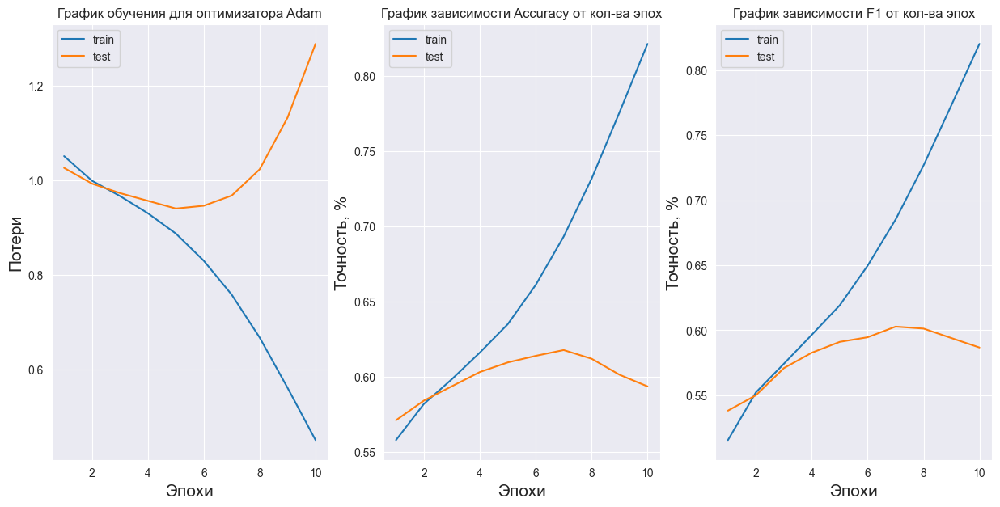

In [153]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 3, 1)
plt.plot(range(1, e + 1), trls, label="train")
plt.plot(range(1, e + 1), tsls, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Потери", fontsize=15)
plt.title("График обучения для оптимизатора Adam")
plt.legend()
plt.subplot(1, 3, 2)
plt.plot(range(1, e + 1), tra, label="train")
plt.plot(range(1, e + 1), tsa, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости Accuracy от кол-ва эпох")
plt.subplot(1, 3, 3)
plt.plot(range(1, e + 1), trf1, label="train")
plt.plot(range(1, e + 1), tsf1, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости F1 от кол-ва эпох")
plt.grid
plt.show()

In [167]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=128, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=128, shuffle=True)

In [177]:
class VariableHiddenDimBiLSTM(nn.Module):
    def __init__(self, input_dim, hidden_dims, output_dim):
        super(VariableHiddenDimBiLSTM, self).__init__()
        self.num_layers = len(hidden_dims)
        self.lstm_layers = nn.ModuleList()

        self.lstm_layers.append(nn.LSTM(input_dim, hidden_dims[0], bidirectional=True))

        for i in range(1, self.num_layers):
            self.lstm_layers.append(nn.LSTM(hidden_dims[i-1]*2, hidden_dims[i], bidirectional=True))

        self.fc = nn.Linear(hidden_dims[-1]*2, output_dim)
        self.hidden_dims = hidden_dims

    def init_hidden(self, bs):
        hidden = []
        for i in range(self.num_layers):
            hidden.append((torch.zeros(2, bs, self.hidden_dims[i]), torch.zeros(2, bs, self.hidden_dims[i])))
        return hidden


    def forward(self, X, hidden):
        out = X.unsqueeze(0)
        for i in range(self.num_layers):
            out, hidden[i] = self.lstm_layers[i](out, hidden[i])
            #out = self.dropout_layers[i](out)  # Применение Dropout
        out = out.squeeze(0)
        out = torch.log_softmax(self.fc(out), dim=1)
        return out, hidden


model = VariableHiddenDimBiLSTM(input_dim=45, hidden_dims=[2048, 1024, 512], output_dim=4)



model.to(device)
X_test = X_test.to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [178]:
%%time
epochs = 10
trf1 = []
tsf1 =[]
tsa=[]
tra=[]
trls = []
tsls = []
for e in range(1, epochs + 1):
    train_loss = 0
    train_acc = 0
    train_f1 = 0
    model.train()
    for batch in tqdm(dataloader_train, leave=True):
        x, y = batch
        x, y = x.cuda(), y.cuda()

        # Initialize the hidden state for each layer
        hidden = model.init_hidden(x.size(0))
        for i in range(len(hidden)):
            hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

        # Forward pass and backprop
        out, hidden = model(x, hidden)
        loss = loss_function(out, y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        train_acc += accuracy(out, y)
        train_f1 += f1_f(out, y)

    # Scale accuracy and losses
    train_loss /= len(dataloader_train)
    train_acc /= len(dataloader_train)
    train_f1 /= len(dataloader_train)

    test_loss = 0
    test_acc = 0
    test_f1 = 0

    with torch.no_grad():
        for batch in tqdm(dataloader_test, leave=True):
            x, y = batch
            x, y = x.cuda(), y.cuda()

            hidden = model.init_hidden(x.size(0))
            for i in range(len(hidden)):
                hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

            out, hidden = model(x, hidden)
            loss = loss_function(out, y)

            test_loss += loss.item()
            test_acc += accuracy(out, y)
            test_f1 += f1_f(out, y)

    test_loss /= len(dataloader_test)
    test_acc /= len(dataloader_test)
    test_f1 /= len(dataloader_test)
    trf1.append(train_f1)
    tsf1.append(test_f1)
    tsa.append(test_acc)
    tra.append(train_acc)
    trls.append(train_loss)
    tsls.append(test_loss)

    print("Epoch {:4} | Train Loss {:.4f} | Train Acc {:.4f} | Train F1 {:.4f} | Test Loss {:.4f} | Test Acc {:.4f} | Test F1 {:.4f}".format(e, train_loss, train_acc, train_f1, test_loss, test_acc, test_f1))

100%|██████████| 348/348 [00:01<00:00, 289.37it/s]


Epoch    1 | Train Loss 1.0439 | Train Acc 0.5596 | Train F1 0.5206 | Test Loss 1.0235 | Test Acc 0.5679 | Test F1 0.5351


100%|██████████| 348/348 [00:01<00:00, 275.66it/s]


Epoch    2 | Train Loss 0.9948 | Train Acc 0.5840 | Train F1 0.5547 | Test Loss 0.9874 | Test Acc 0.5854 | Test F1 0.5571


100%|██████████| 348/348 [00:01<00:00, 302.66it/s]


Epoch    3 | Train Loss 0.9565 | Train Acc 0.6025 | Train F1 0.5793 | Test Loss 0.9665 | Test Acc 0.5989 | Test F1 0.5780


100%|██████████| 348/348 [00:01<00:00, 284.56it/s]


Epoch    4 | Train Loss 0.9118 | Train Acc 0.6227 | Train F1 0.6041 | Test Loss 0.9432 | Test Acc 0.6092 | Test F1 0.5884


100%|██████████| 348/348 [00:01<00:00, 288.92it/s]


Epoch    5 | Train Loss 0.8516 | Train Acc 0.6501 | Train F1 0.6365 | Test Loss 0.9481 | Test Acc 0.6110 | Test F1 0.5912


100%|██████████| 348/348 [00:01<00:00, 293.17it/s]


Epoch    6 | Train Loss 0.7704 | Train Acc 0.6849 | Train F1 0.6753 | Test Loss 0.9697 | Test Acc 0.6129 | Test F1 0.5987


100%|██████████| 348/348 [00:01<00:00, 302.14it/s]


Epoch    7 | Train Loss 0.6586 | Train Acc 0.7340 | Train F1 0.7282 | Test Loss 1.0391 | Test Acc 0.6112 | Test F1 0.5993


100%|██████████| 348/348 [00:01<00:00, 293.19it/s]


Epoch    8 | Train Loss 0.5204 | Train Acc 0.7906 | Train F1 0.7877 | Test Loss 1.2011 | Test Acc 0.5995 | Test F1 0.5877


100%|██████████| 348/348 [00:01<00:00, 291.23it/s]


Epoch    9 | Train Loss 0.3824 | Train Acc 0.8499 | Train F1 0.8486 | Test Loss 1.4013 | Test Acc 0.5958 | Test F1 0.5872


100%|██████████| 348/348 [00:01<00:00, 292.22it/s]

Epoch   10 | Train Loss 0.2735 | Train Acc 0.8950 | Train F1 0.8945 | Test Loss 1.6690 | Test Acc 0.5912 | Test F1 0.5825
CPU times: total: 21min 21s
Wall time: 2min 24s


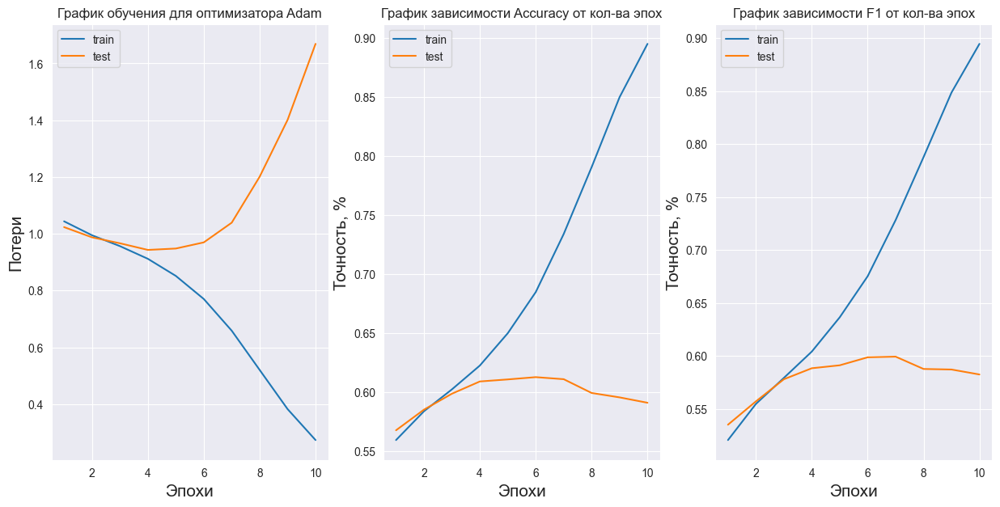

In [179]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 3, 1)
plt.plot(range(1, e + 1), trls, label="train")
plt.plot(range(1, e + 1), tsls, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Потери", fontsize=15)
plt.title("График обучения для оптимизатора Adam")
plt.legend()
plt.subplot(1, 3, 2)
plt.plot(range(1, e + 1), tra, label="train")
plt.plot(range(1, e + 1), tsa, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости Accuracy от кол-ва эпох")
plt.subplot(1, 3, 3)
plt.plot(range(1, e + 1), trf1, label="train")
plt.plot(range(1, e + 1), tsf1, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости F1 от кол-ва эпох")
plt.grid
plt.show()

## Создаем картинки


In [30]:
major_train = major_train[major_train['annotator_emo'] != 'other']

In [31]:
print(major_train.annotator_emo.value_counts())

annotator_emo
neutral     80000
sad         30902
positive    25310
angry       22569
Name: count, dtype: int64


In [32]:
major_train[major_train['dataset']=='podcast']

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
1,6994978aeb67af9d93ddd7819c2567e2,6994978aeb67af9d93ddd7819c2567e2.wav,1.699875,neutral,NaN,fc80770a6fbf4d53261c716946b2978e,NaN,NaN,7e7bf25806f06717e743dc857af33209,podcast
3,d1cbfdbdfee5fbaa5f043f1fcd1d9216,d1cbfdbdfee5fbaa5f043f1fcd1d9216.wav,1.900000,neutral,NaN,b8490c1eae9cd6def2c8e318a03d8547,NaN,NaN,49f0aa8dfb01be78b7a6edca48c4d8ce,podcast
7,5772c569012484a0ab98b7011831bc4a,5772c569012484a0ab98b7011831bc4a.wav,2.899875,neutral,NaN,f2b0d2d77199bc2b72db8961be79819d,NaN,NaN,30469580054ee77de5601d4f37c6d014,podcast
8,c4243186d018387a37c704bdf19252e1,c4243186d018387a37c704bdf19252e1.wav,2.600000,neutral,NaN,56fc944c837ebe5662c20f0ede751ad4,NaN,NaN,182f9d6dcb0df02e1b00a356364151d2,podcast
9,318aad1d39d9c021303556e85c4dc236,318aad1d39d9c021303556e85c4dc236.wav,2.700000,neutral,NaN,f443ac8ba58a44776cbe499579229d5f,NaN,NaN,479202ec46b5a25b2c51190e2a4ba9d4,podcast
...,...,...,...,...,...,...,...,...,...,...
161058,55a54d98443cb0edc9aa78d79e23db94,55a54d98443cb0edc9aa78d79e23db94.wav,3.800000,positive,NaN,478ece03f1b19f637b7e7e10a1c4ec18,NaN,NaN,763d3f7e3283b1a518d3e55c6fe94453,podcast
161059,1ab446e4e07e257f185718d60f0fa987,1ab446e4e07e257f185718d60f0fa987.wav,2.000000,sad,NaN,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,0bd05f242495d97466c5674653ae32cb,podcast
161060,c9e515550d451c497c5434c1e12d61a9,c9e515550d451c497c5434c1e12d61a9.wav,4.800000,positive,NaN,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,becdf05079e4884fa8a8276d1a488f1d,podcast
161061,be1553e2d7651dfc6360db8594001262,be1553e2d7651dfc6360db8594001262.wav,2.800000,positive,NaN,d6b5eac94428cfad71114fbccbcf4dbc,NaN,NaN,fce116bdeb94468cea73a926ab452205,podcast


In [76]:
folder_path = 'spectrograms_mel'
output_dir = "spectrograms_mel"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
files_in_folder = os.listdir(folder_path)
files_in_folder = list(map(lambda x: x[5:-4]+'.wav', files_in_folder))
print(len(files_in_folder))
audio_files = major_train[(~major_train['audio_path'].isin(files_in_folder))&(major_train['dataset']=='podcast')].audio_path


582


In [ ]:
mfccs = librosa.feature.mfcc(y=y_harmonic, sr=sr, n_mfcc=120)
plt.figure(figsize=(7, 5))
librosa.display.specshow(mfccs, x_axis='time', cmap='hot')
plt.colorbar()
plt.title('MFCC')

In [75]:


k = 0
for i, audio_file in enumerate(audio_files):
    y, sr = process_audio_cycle_podcast(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{audio_file}')
    y_harmonic, y_percussive = librosa.effects.hpss(y)
    mfccs = librosa.feature.mfcc(y=y_harmonic, sr=sr, n_mfcc=120)

    plt.figure(figsize=(3.88, 3.9))
    librosa.display.specshow(mfccs, x_axis='time', cmap='hot')
    plt.axis('off')  # Скрыть оси

    output_path = os.path.join(output_dir, f"spec_{audio_file[:-4]}.jpeg")
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)  # Убрать лишние поля
    plt.close()


print("Создание спектрограмм завершено.")

KeyboardInterrupt: 

In [135]:
output_dir = "spectrograms_jpg"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

k = 0
for i, audio_file in enumerate(audio_files):
    y, sr = process_audio_cycle_podcast(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{audio_file}')
    X = librosa.stft(y)
    Xdb = librosa.amplitude_to_db(abs(X))

    plt.figure(figsize=(3.88, 3.9))
    librosa.display.specshow(Xdb, sr=sr, x_axis=None, y_axis=None)
    plt.axis('off')  # Скрыть оси

    output_path = os.path.join(output_dir, f"spec_{audio_file[:-4]}.png")
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)  # Убрать лишние поля
    plt.close()


print("Создание спектрограмм завершено.")

Создание спектрограмм завершено.


In [138]:
folder_path = 'spectrogramsss'
file_list = os.listdir(folder_path)

In [139]:

pic_crow = pd.DataFrame({'dataset': 'crowd',
                    'pic_file_path': [os.path.join(folder_path, file) for file in file_list],
                    'audio_path': [file[5:-4]+'.wav' for file in file_list]})

In [140]:
pic_crow

,dataset,pic_file_path,audio_path
0,crowd,spectrogramsss\spec_00000d522439136554c888f4cfd92131.png,00000d522439136554c888f4cfd92131.wav
1,crowd,spectrogramsss\spec_000039c2bc753aa5a776621a4707eb73.png,000039c2bc753aa5a776621a4707eb73.wav
2,crowd,spectrogramsss\spec_000043e573826e21659ef9401d4ba84f.png,000043e573826e21659ef9401d4ba84f.wav
3,crowd,spectrogramsss\spec_0002600403a116020fa591faf05a31de.png,0002600403a116020fa591faf05a31de.wav
4,crowd,spectrogramsss\spec_0002657bbce98b76b9832c8ad6e4e6db.png,0002657bbce98b76b9832c8ad6e4e6db.wav
...,...,...,...
163982,crowd,spectrogramsss\spec_fffd56331f025ad59b288b509cac584a.png,fffd56331f025ad59b288b509cac584a.wav
163983,crowd,spectrogramsss\spec_fffdcb6c9078c84c88d65752474c8945.png,fffdcb6c9078c84c88d65752474c8945.wav
163984,crowd,spectrogramsss\spec_fffe6e2189d87d2bcf4e10fba9a4aa73.png,fffe6e2189d87d2bcf4e10fba9a4aa73.wav
163985,crowd,spectrogramsss\spec_fffeba24094a8cdf1737387158a8b220.png,fffeba24094a8cdf1737387158a8b220.wav


In [141]:
merged_data = pd.merge(pic_crow, major_train, how='left', left_on='audio_path', right_on='audio_path')

# Шаг 2: Добавление столбца emo из датасета major в датасет pic
pic_crow['emotion'] = merged_data['annotator_emo']

In [142]:
pic_crow = pic_crow.dropna(subset=['emotion'])


In [143]:
print(pic_crow.emotion.value_counts())

emotion
neutral     46343
sad         29792
angry       21006
positive    19754
Name: count, dtype: int64


In [144]:
pic_crow

,dataset,pic_file_path,audio_path,emotion
0,crowd,spectrogramsss\spec_00000d522439136554c888f4cfd92131.png,00000d522439136554c888f4cfd92131.wav,neutral
1,crowd,spectrogramsss\spec_000039c2bc753aa5a776621a4707eb73.png,000039c2bc753aa5a776621a4707eb73.wav,neutral
3,crowd,spectrogramsss\spec_0002600403a116020fa591faf05a31de.png,0002600403a116020fa591faf05a31de.wav,positive
4,crowd,spectrogramsss\spec_0002657bbce98b76b9832c8ad6e4e6db.png,0002657bbce98b76b9832c8ad6e4e6db.wav,neutral
5,crowd,spectrogramsss\spec_00028ec577ebf8a50bd617a9c0a5bc77.png,00028ec577ebf8a50bd617a9c0a5bc77.wav,positive
...,...,...,...,...
163980,crowd,spectrogramsss\spec_fffccba8c67673004eb2769827e99ab0.png,fffccba8c67673004eb2769827e99ab0.wav,angry
163981,crowd,spectrogramsss\spec_fffd1d6186df2f0273b1778dac5b372f.png,fffd1d6186df2f0273b1778dac5b372f.wav,sad
163982,crowd,spectrogramsss\spec_fffd56331f025ad59b288b509cac584a.png,fffd56331f025ad59b288b509cac584a.wav,sad
163984,crowd,spectrogramsss\spec_fffe6e2189d87d2bcf4e10fba9a4aa73.png,fffe6e2189d87d2bcf4e10fba9a4aa73.wav,neutral


In [148]:
folder_path = 'spectrograms'
file_list = os.listdir(folder_path)

pic_podc = pd.DataFrame({'dataset': 'podcast',
                    'pic_file_path': [os.path.join(folder_path, file) for file in file_list],
                    'audio_path': [file[5:-4] + '.wav' for file in file_list]})
pic_podc

,dataset,pic_file_path,audio_path
0,podcast,spectrograms\spec_000165d99f05138b246098e32c73e13f.png,000165d99f05138b246098e32c73e13f.wav
1,podcast,spectrograms\spec_00026d6c52547bd9e835d54f849e58c9.png,00026d6c52547bd9e835d54f849e58c9.wav
2,podcast,spectrograms\spec_0004014b64fafe62c54c8d6d573c7cb2.png,0004014b64fafe62c54c8d6d573c7cb2.wav
3,podcast,spectrograms\spec_0004450853993fa91169cad81dec8ba7.png,0004450853993fa91169cad81dec8ba7.wav
4,podcast,spectrograms\spec_000c986a6ebfaba80c7a544066b48373.png,000c986a6ebfaba80c7a544066b48373.wav
...,...,...,...
65477,podcast,spectrograms\spec_fffcfd5db45cd3db652651e53b5afcd6.png,fffcfd5db45cd3db652651e53b5afcd6.wav
65478,podcast,spectrograms\spec_fffdeed5d25fe195daeacd2769ed2954.png,fffdeed5d25fe195daeacd2769ed2954.wav
65479,podcast,spectrograms\spec_fffea40174fe5f7ab070a0202b55f378.png,fffea40174fe5f7ab070a0202b55f378.wav
65480,podcast,spectrograms\spec_fffedec33b59addc001579b6f919b16b.png,fffedec33b59addc001579b6f919b16b.wav


In [149]:
merged_data = pd.merge(pic_podc, major_train, how='left', left_on='audio_path', right_on='audio_path')
merged_data

,dataset_x,pic_file_path,audio_path,hash_id,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset_y
0,podcast,spectrograms\spec_000165d99f05138b246098e32c73e13f.png,000165d99f05138b246098e32c73e13f.wav,000165d99f05138b246098e32c73e13f,4.300125,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,a8740ae62811a1ddde977b19bc9f42ed,podcast
1,podcast,spectrograms\spec_00026d6c52547bd9e835d54f849e58c9.png,00026d6c52547bd9e835d54f849e58c9.wav,00026d6c52547bd9e835d54f849e58c9,2.100125,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,fd50e1749a50f947346c42b8eab4f578,podcast
2,podcast,spectrograms\spec_0004014b64fafe62c54c8d6d573c7cb2.png,0004014b64fafe62c54c8d6d573c7cb2.wav,0004014b64fafe62c54c8d6d573c7cb2,3.500000,positive,NaN,932e3f3a658c305155b26340f033e286,NaN,NaN,21cc17e18858f8d200f3ae8353fe6af3,podcast
3,podcast,spectrograms\spec_0004450853993fa91169cad81dec8ba7.png,0004450853993fa91169cad81dec8ba7.wav,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,podcast,spectrograms\spec_000c986a6ebfaba80c7a544066b48373.png,000c986a6ebfaba80c7a544066b48373.wav,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
65580,podcast,spectrograms\spec_fffcfd5db45cd3db652651e53b5afcd6.png,fffcfd5db45cd3db652651e53b5afcd6.wav,fffcfd5db45cd3db652651e53b5afcd6,2.700250,neutral,NaN,6fd11225b298764fb94f60d7dc04133d,NaN,NaN,246caaa90f92d2d6ca1eb2e7be4e8408,podcast
65581,podcast,spectrograms\spec_fffdeed5d25fe195daeacd2769ed2954.png,fffdeed5d25fe195daeacd2769ed2954.wav,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
65582,podcast,spectrograms\spec_fffea40174fe5f7ab070a0202b55f378.png,fffea40174fe5f7ab070a0202b55f378.wav,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
65583,podcast,spectrograms\spec_fffedec33b59addc001579b6f919b16b.png,fffedec33b59addc001579b6f919b16b.wav,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [150]:


# Шаг 2: Добавление столбца emo из датасета major в датасет pic
pic_podc['emotion'] = merged_data['annotator_emo']


print(pic_podc.emotion.value_counts())

emotion
neutral     33637
positive     5545
angry        1580
sad          1210
Name: count, dtype: int64


In [151]:
pic_podc = pic_podc.dropna(subset=['emotion'])